<a href="https://colab.research.google.com/github/alepistola/Baghdad-AI/blob/main/Abu.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Archeo

## Import and utilities

### Path and libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install pytorch-lightning
!pip install segmentation-models-pytorch
!pip install rasterio
!pip install gdal
!pip install torchinfo

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 800.9/800.9 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 840.4/840.4 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 15.5 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16428 sha256=49b38c0cb8a843acc4e11299509e39171de50b6cc6bf0b169aaad6a00065fa76
  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60945 sha256=c28ce25cd4b05552277b223eee57f2d0bbc18a183a98a42e9911492bcb21f420
  Stored in directory: /root/.cache/pip/wheels/35/cb/a5/8

In [ ]:
import os
import random
import numpy as np
import pandas as pd
import rich
import json
import cv2
import csv

import torch
import torchvision
from torch.utils.data import Dataset, DataLoader
from torchmetrics.classification import BinaryMatthewsCorrCoef
from torchmetrics import Metric
from torchinfo import summary


import albumentations as A
from albumentations import pytorch

import pytorch_lightning as pl
from pytorch_lightning import loggers as pl_loggers
from pytorch_lightning.loggers import CSVLogger
from pytorch_lightning.callbacks import TQDMProgressBar, RichProgressBar, EarlyStopping, ModelCheckpoint

import segmentation_models_pytorch  as smp
from segmentation_models_pytorch.encoders import get_preprocessing_fn

from scipy.ndimage  import gaussian_filter

from matplotlib import pyplot as plt
import numpy as np
from PIL import Image
from datetime import datetime
from pathlib import Path
import rasterio

from osgeo import gdal, ogr, osr

import geopandas as geopd
from shapely.geometry.multipolygon import MultiPolygon
from tqdm.auto import tqdm

In [ ]:
local = False

LOCAL_URL = ""
CLOUD_URL = "/content/drive/My Drive/ML/AbuGrahib/"

base_url = ""

if(local):
  base_url = LOCAL_URL
else:
  base_url = CLOUD_URL

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
torch.device(device)

NUM_WORKERS = 4 * os.cpu_count()
PATH_LOG = base_url + 'exp_logs/'
PATH_DATASETS = base_url + 'datasets/'
PATH_OUTPUT = base_url + 'outputs/'
PATH_CASINI = '/content/drive/My Drive/ML/Casini/'

## path Floodplain models - source models
PATH_CBING = PATH_CASINI + "outputs/bing_filtrato/best_model/epoch=19-step=10400.ckpt"
PATH_CCORONA = PATH_CASINI + "outputs/corona_filtrato/best_model/epoch=19-step=10400.ckpt"
PATH_CBING_CORONA = PATH_CASINI + "outputs/bing_corona_filtrato/best_model/epoch=19-step=10400.ckpt"

modelli = ['CBing_Bing', 'CCorona_Corona', 'CBingCorona_BingCorona']

config = {
    "timestamp" : datetime.now().strftime("%d-%m-%Y_%H%M%S"),
    "dataset_path" : "",
    "checkpoint_path" : "",
    "random_seed" : 1234,
    "arch" : "MAnet", #Unet,MAnet
    "encoder" : "efficientnet-b3", #resnet18, dpn68, efficientnet-b3
    "weights" : "imagenet",
    "loss" : "focal",
    "learning_rate" : 0.0001,
    "precision" : "32",
    "max-epochs" : 100,
    "batch_size" : 8,
    "dim_input" : '2k',
    "in_channels" : 6,
    "corona_path" : "",
    "sm_checkpoint": '',
    "log_path": ''
}

random.seed(config["random_seed"])
np.random.seed(config["random_seed"])
torch.manual_seed(config["random_seed"])

print("PATH DATASETS: " + PATH_DATASETS)
print("PATH LOG: " + PATH_LOG)

PATH DATASETS: /content/drive/My Drive/ML/AbuGrahib/datasets/
PATH LOG: /content/drive/My Drive/ML/AbuGrahib/exp_logs/


### Splitting in train (80%), validation (10%) and test (10%) set

In [ ]:
def load_dataset(dataset_path):

    random.seed(config["random_seed"])
    np.random.seed(config["random_seed"])
    torch.manual_seed(config["random_seed"])

    images_directory = dataset_path + "sites/"
    masks_directory = dataset_path + "masks/"

    filenames_train_with_test = list(sorted(os.listdir(images_directory)))
    filenames_train_filtered = np.asarray([filename for filename in filenames_train_with_test if not filename.startswith("test")])

    indices = np.arange(0, len(filenames_train_filtered))
    np.random.shuffle(indices)

    print("total files:", len(filenames_train_with_test))

    # lo splitting avviene in modo che il training set sia il 75%, validation set sia il 15% ed il test set del 10%
    # poichè poi aggiungo 10 immagini al test_set del progetto precedente

    valid_split = -int(len(indices)*0.25)
    test_split = int(valid_split // 2.57)

    train_indices = indices[:valid_split]
    valid_indices = indices[valid_split:test_split]
    test_indices = indices[test_split:]
    train_images_filenames = filenames_train_filtered[train_indices]
    val_images_filenames = filenames_train_filtered[valid_indices]
    test_images_filenames = filenames_train_filtered[test_indices]

    # test_images_filenames = np.append(test_images_filenames, [i for i in filenames_train_with_test if "test" in i])

    print(
        "root:", base_url,
        "\n images", images_directory,
        "\n masks", masks_directory,"\n ---",
        '\n train images', len(train_images_filenames),
        '\n val images', len(val_images_filenames),
        '\n test images', len(test_images_filenames),
        '\n ---\ntotal images', len(filenames_train_with_test)
    )

    print("empty masks percentage: %.4f %.4f %.4f" %
          ( len([i for i in train_images_filenames if "neg" in i]) / len(train_images_filenames),
            len([i for i in val_images_filenames if "neg" in i])   / len(val_images_filenames),
            len([i for i in test_images_filenames if "neg" in i])  / len(test_images_filenames)
          ))

    return (
        images_directory,
        masks_directory,
        train_images_filenames,
        val_images_filenames,
        test_images_filenames
    )

### Image pre-processing functions

In [ ]:
def esegui_trasformazioni():

  train_transform = A.Compose([
    A.RandomCrop(1024, 1024, p = 1.0),
    A.Flip(p = 0.5),
    A.RandomRotate90(p = 0.5),

    # geometric transformation
    A.OneOf([
      A.GridDistortion (distort_limit=0.5, border_mode=2, p=0.4),
      A.RandomGridShuffle (grid=(2, 2), p = 0.6)
    ], p=0.2),

    # color space transformation
    A.OneOf([
      A.CLAHE(p=0.4, clip_limit=(10, 20), tile_grid_size=(8, 8)),
      A.RandomBrightnessContrast(brightness_limit = 0.15, contrast_limit = 0.15, p = 0.8),
      A.ChannelShuffle(p=0.1),
      A.ColorJitter(p=0.2, brightness=(0.85, 1.15), contrast=(0.6, 1.4), saturation=(0.5, 0.9), hue=(-0.1, 0.1)),
      A.HueSaturationValue(p=0.2, hue_shift_limit=(-25, 25), sat_shift_limit=(-40, 40), val_shift_limit=(-15, 1))
    ], p=0.5),

    # kernel filters
    A.OneOf([
      A.Blur(p=0.4, blur_limit=(5, 15)),
      A.GaussNoise(p=0.4),
      A.MotionBlur(p=0.2, blur_limit=(15, 25), allow_shifted=True)
    ], p=0.5),

    A.Sharpen(p=0.1, alpha=(0.5, 0.7), lightness=(0.8, 2.0)),

    A.Resize(512, 512),
    A.pytorch.ToTensorV2()
    ],
    additional_targets={'secondary_image': 'image'}
  )

  val_transform = A.Compose([
        A.RandomCrop(1024, 1024, p=1.0),
        A.Flip(p = 0.5),
        A.RandomRotate90(p = 0.5),
        A.RandomBrightnessContrast(brightness_limit = 0.15, contrast_limit = 0.15, p = 0.25),
        A.Resize(512, 512),
        A.pytorch.ToTensorV2()
    ],
    additional_targets={'secondary_image': 'image'}
  )


  return train_transform, val_transform

#### Augmentation demo

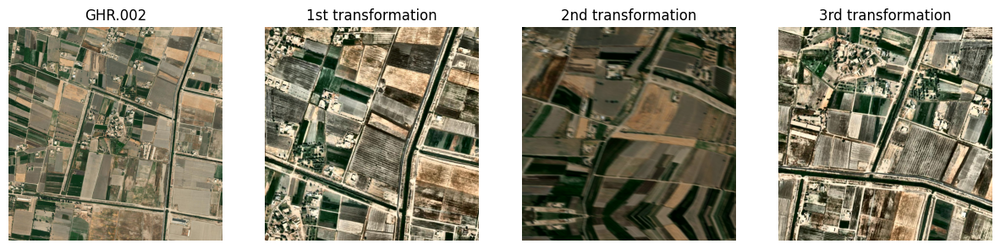

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


image_path = PATH_DATASETS + "bing_2k/sites/GHR.002.jpg"
img = Image.open(image_path).convert("RGB")
train_transform, val_transform = esegui_trasformazioni()
transformed_image_1 = train_transform(image=np.asarray(img))['image']
transformed_image_2 = train_transform(image=np.asarray(img))['image']
transformed_image_3 = train_transform(image=np.asarray(img))['image']

plt.figure(figsize=(15, 5))

# Numero di immagini
num_images = 4

plt.subplot(1, num_images, 1)
plt.imshow(img)  # convert CHW -> HWC
plt.title("GHR.002")
plt.axis("off")

plt.subplot(1, num_images, 2)
plt.imshow(transformed_image_1.permute(1,2,0))  # convert CHW -> HWC
plt.title("1st transformation")
plt.axis("off")

plt.subplot(1, num_images, 3)
plt.imshow(transformed_image_2.permute(1,2,0))
plt.title("2nd transformation")
plt.axis("off")

plt.subplot(1, num_images, 4)
plt.imshow(transformed_image_3.permute(1,2,0))
plt.title("3rd transformation")
plt.axis("off")

plt.show()

## Model definition and lightning class

### ArcheoDataset - Lightning Dataset class

In [ ]:
class ArcheoDataset(Dataset):
    def __init__(self, images_filenames, images_directory, masks_directory, transform=None):
        self.images_filenames = images_filenames
        self.images_directory = images_directory
        self.masks_directory = masks_directory

        if(transform is None):
          if(config['corona_path'] != ''):
            transform = A.Compose([A.Resize(512,512), A.pytorch.ToTensorV2()], additional_targets={'secondary_image': 'image'})
          else:
            transform = A.Compose([A.Resize(512,512), A.pytorch.ToTensorV2()])

        self.transform = transform

    def __len__(self):
        return len(self.images_filenames)

    def __getitem__(self, idx):
        image_filename = self.images_filenames[idx]
        image_path = self.images_directory + image_filename
        mask_path = self.masks_directory +  image_filename.replace(".jpg", ".png")

        image = np.array(Image.open(image_path).convert("RGB"))

        mask = ~np.array(Image.open(mask_path).convert("L")) # masks are flipped because of qgis
        mask = mask.astype("float")
        mask[mask > 0.0] = 1.0
        mask = np.expand_dims(mask, -1)

        if(config['corona_path'] != ""):
          path_corona = config['corona_path']
          image_path_corona = os.path.join(path_corona, image_filename)
          image_corona = Image.open(image_path_corona)
          secondary_image = image_corona
          transformed = self.transform(image = np.asarray(image), secondary_image = np.asarray(secondary_image), mask = np.asarray(mask))

          image = transformed["image"]
          secondary_image = transformed["secondary_image"]
          image = torch.cat((image, secondary_image), 0)
        else:
          transformed = self.transform(image = np.asarray(image), mask = np.asarray(mask))
          image = transformed["image"]

        mask = transformed["mask"].permute(2,0,1)

        return image, mask, image_filename

### ArcheoDataset modified for test

In [ ]:
class ArcheoDatasetModify(Dataset):
    def __init__(self, images_filenames, images_directory, masks_directory):
        self.images_filenames = images_filenames
        self.images_directory = images_directory
        self.masks_directory = masks_directory

    def __len__(self):
        return len(self.images_filenames)

    def __getitem__(self, idx, verbose=False):
      image_filename = self.images_filenames[idx]+'.jpg'
      image_path = os.path.join(self.images_directory, image_filename)
      mask_path = os.path.join(self.masks_directory, image_filename.replace(".jpg", ".png"))

      image = Image.open(image_path)
      # masks are flipped because of qgis
      mask = ~np.array(Image.open(mask_path).convert("L"))
      mask = mask.astype("float")
      mask[mask > 0.0] = 1.0
      mask = np.expand_dims(mask, -1)
      x_minore=int(name2tras[image_filename[:-4]][0])
      y_minore=int(name2tras[image_filename[:-4]][1])

      if(config['corona_path'] != ''):
        path_corona = config['corona_path']
        image_path_corona=os.path.join(path_corona, image_filename)
        image_corona = Image.open(image_path_corona)

        trasformazione = A.Compose([
            A.Crop(x_min=x_minore, y_min=y_minore, x_max=x_minore+1024, y_max=y_minore+1024, p=1.0),
            A.Resize(512,512),
            A.pytorch.ToTensorV2()], additional_targets={'image_corona': 'image'})

        transformed = trasformazione(image=np.asarray(image), image_corona=np.asarray(image_corona), mask=np.asarray(mask))
        image_corona = transformed["image_corona"]
        image = transformed["image"]
        image=torch.cat((image, image_corona), 0)

      else:
        trasformazione = A.Compose([
            A.Crop(x_min=x_minore, y_min=y_minore, x_max=x_minore+1024, y_max=y_minore+1024,p=1.0),
            A.Resize(512,512),
            A.pytorch.ToTensorV2()])

        transformed = trasformazione(image=np.asarray(image), mask=np.asarray(mask))
        image = transformed["image"]

      mask = transformed["mask"].permute(2,0,1)
      return image, mask, image_filename

### Custom lightning metrics - BinaryIoU - PixelWise

In [ ]:
def calculate_binary_metrics(predicted, target):
    intersection = torch.logical_and(target, predicted).sum().item()
    union = torch.logical_or(target, predicted).sum().item()

    return intersection, union

class BinaryIoU(Metric):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.add_state("intersection", default=torch.tensor(0), dist_reduce_fx="sum")
        self.add_state("union", default=torch.tensor(0), dist_reduce_fx="sum")


    def update(self, predicted, target) -> None:
        if predicted.shape != target.shape:
            raise ValueError("preds and target must have the same shape")

        intersection, union = calculate_binary_metrics(predicted, target)
        self.intersection += intersection
        self.union += union

    def compute(self):
        #return self.tp / (self.tp + self.fp + self.fn)
        return self.intersection / self.union

### ArcheoModel - Lightning Model class

In [ ]:
# Inizializzazione del modello NB: il calcolo della funzione di loss avviene sulla maschera, le probabilità sono ottenute
# con il sigmoid. Le probabilità maggiori di 0.5 vengono trasformate in 1, quelle sotto lo 0.5 in 0.

class ArcheoModel(pl.LightningModule):

    def __init__(self, arch, encoder_name, in_channels, out_classes, **kwargs):
        super().__init__()

        self.model = smp.MAnet(
          encoder_name = encoder_name,
          encoder_weights = "imagenet",
          in_channels = in_channels,
          classes = out_classes,
        )

        params = smp.encoders.get_preprocessing_params(encoder_name)

        self.register_buffer("std", torch.tensor(params["std"]).view(1, 3, 1, 1))
        self.register_buffer("mean", torch.tensor(params["mean"]).view(1, 3, 1, 1))

        self.bIoU = BinaryIoU()
        self.mcc = BinaryMatthewsCorrCoef()

        self.validation_step_outputs = []
        self.training_step_outputs = []
        self.test_step_outputs = []

        if config["loss"] == "jaccard":
            self.loss_fn = smp.losses.JaccardLoss(smp.losses.BINARY_MODE, from_logits=True)
        if config["loss"] == "dice":
            self.loss_fn = smp.losses.DiceLoss(smp.losses.BINARY_MODE, from_logits=True)
        if config["loss"] == "focal":
            self.loss_fn = smp.losses.FocalLoss(mode=smp.losses.BINARY_MODE)


    def freezeAll(self):
        for param in self.model.parameters():
            param.requires_grad = False

    def unfreezeAll(self):
        for param in self.model.parameters():
            param.requires_grad = True

    def unfreeze(self, layer="segmentation_head"):
        if layer == "segmentation_head":
          for param in self.model.segmentation_head.parameters():
            param.requires_grad = True


    def forward(self, image):
      if(config['ensemble'] == False and config['corona_path'] != ""):
        image1, image2 = torch.tensor_split(image, 2, dim=1)
        image1 = (image1 - self.mean) / self.std
        image2 = (image2 - self.mean) / self.std
        image = torch.cat((image1, image2), 1)
      else:
        image = (image - self.mean) / self.std
      mask = self.model(image)
      return mask


    def shared_step(self, batch, stage):
        # batch[0] -> image
        # batch[1] -> mask

        image = batch[0]

        # (batch_size, num_channels, height, width)
        assert image.ndim == 4

        # Check that image dimensions are divisible by 32
        h, w = image.shape[2:]
        assert h % 32 == 0 and w % 32 == 0

        mask = batch[1]

        assert mask.ndim == 4 # [batch_size, num_classes, height, width] = dim 4

        # Check that mask values in between 0 and 1, NOT 0 and 255 for binary segmentation
        assert mask.max() <= 1.0 and mask.min() >= 0

        logits_mask = self.forward(image) # -> output grezzo del modello
        loss = self.loss_fn(logits_mask, mask) # calcolo funzione di loss = errore

        self.log_dict({f"{stage}/loss": loss.detach().item()}, batch_size=config["batch_size"], on_epoch=True, on_step=False) # log metrica loss

        prob_mask = logits_mask.sigmoid() # funzione di attivazione -> probabilità pixel per pixel
        pred_mask = (prob_mask > 0.5).float()
        pred_mask = pred_mask.permute(0, 3, 1, 2) #  "NCHW" (dove N è la dimensione del batch, C è il numero di canali, H è l'altezza e W è la larghezza)
        mask = mask.permute(0, 3, 1, 2)

        tp, fp, fn, tn = smp.metrics.get_stats(pred_mask.long(), mask.long(), mode="binary")

        if stage == "train":
            self.log_dict(
                {
                  "train/batch-IOU-img" : smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro-imagewise"),
                  "train/batch-IOU" : smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro")
                },
                prog_bar=True,
                batch_size=config["batch_size"]
            )
        elif stage == "valid":
            self.log_dict(
                {
                  "valid/bIoU" : self.bIoU(pred_mask, mask),
                  "valid/mcc": self.mcc(pred_mask, mask)
                },
                prog_bar=True,
                on_step=False,
                on_epoch=True,
                batch_size=config["batch_size"]
            )
        elif stage == "test":
            self.log_dict(
                {
                  #"test/IoU-weighted" : smp.metrics.iou_score(tp, fp, fn, tn, reduction='weighted', class_weights=[0.1, 0.9]),
                  "test/bIoU" : self.bIoU(pred_mask, mask),
                  "test/mcc": self.mcc(pred_mask, mask)
                },
                on_step=False,
                on_epoch=True,
                prog_bar=True,
                batch_size=config["batch_size"]
            )

        return {
            "loss": loss,
            "tp": tp,
            "fp": fp,
            "fn": fn,
            "tn": tn,
        }

    def shared_epoch_end(self, stage):
        if(stage == "train"):
          tp = torch.cat([x["tp"] for x in self.training_step_outputs])
          fp = torch.cat([x["fp"] for x in self.training_step_outputs])
          fn = torch.cat([x["fn"] for x in self.training_step_outputs])
          tn = torch.cat([x["tn"] for x in self.training_step_outputs])
        elif(stage == "valid"):
          tp = torch.cat([x["tp"] for x in self.validation_step_outputs])
          fp = torch.cat([x["fp"] for x in self.validation_step_outputs])
          fn = torch.cat([x["fn"] for x in self.validation_step_outputs])
          tn = torch.cat([x["tn"] for x in self.validation_step_outputs])
        else:
          tp = torch.cat([x["tp"] for x in self.test_step_outputs])
          fp = torch.cat([x["fp"] for x in self.test_step_outputs])
          fn = torch.cat([x["fn"] for x in self.test_step_outputs])
          tn = torch.cat([x["tn"] for x in self.test_step_outputs])

        per_image_iou = smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro-imagewise")
        dataset_iou = smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro")

        metrics = {
            f"{stage}/IOU-img": per_image_iou,
            f"{stage}/IOU": dataset_iou,
        }

        self.log_dict(metrics, prog_bar=True, batch_size=config["batch_size"])


    # BASIC STEP
    def training_step(self, batch, batch_idx):
        output = self.shared_step(batch, "train")
        self.training_step_outputs.append(output)
        return output

    def validation_step(self, batch, batch_idx):
        output = self.shared_step(batch, "valid")
        self.validation_step_outputs.append(output)
        return output

    def test_step(self, batch, batch_idx):
        output = self.shared_step(batch, "test")
        self.test_step_outputs.append(output)
        return output


    # EPOCH END
    def on_training_epoch_end(self):
        self.shared_epoch_end("train")
        return self.training_step_outputs.clear()

    def on_validation_epoch_end(self):
        self.shared_epoch_end("valid")
        return self.validation_step_outputs.clear()

    def on_test_epoch_end(self):
        self.shared_epoch_end("test")
        return self.test_step_outputs.clear()

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=config["learning_rate"]) # 0.00005


### Ensemble Archeo Models

modelA e modelB sono i due modelli MANet (Bing e Corona). Durante la fase di forward, entrambi i modelli ricevono lo stesso input x e producono i rispettivi output, indipendentemente. Questi output vengono poi concatenati lungo la dimensione dei canali, e successivamente passati attraverso un layer convoluzionale 1x1, un max pooling con stride 1 e kernel size 1, e infine un layer sigmoid. Questo garantisce che l’output finale abbia le dimensioni desiderate [8, 1, 512, 512].

Le funzioni training_step e validation_step sono utilizzate per definire la logica di addestramento e validazione, rispettivamente. In questo caso, stiamo utilizzando la Focal Loss come funzione di perdita

In [ ]:
import pytorch_lightning as pl

class EnsembleArcheoModel(pl.LightningModule):
    def __init__(self, modelA, modelB, encoder_name="efficientnet-b3"):
        super(EnsembleArcheoModel, self).__init__()
        self.modelA = modelA
        self.modelB = modelB

        for param in modelA.parameters():
          param.requires_grad = False

        for param in modelB.parameters():
          param.requires_grad = False

        self.conv = torch.nn.Conv2d(2, 1, kernel_size=1)
        self.pool = torch.nn.MaxPool2d(kernel_size=1, stride=1)
        self.sigmoid = torch.nn.Sigmoid()
        self.loss_fn = smp.losses.FocalLoss(mode=smp.losses.BINARY_MODE)

        self.bIoU = BinaryIoU()
        self.mcc = BinaryMatthewsCorrCoef()

        params = smp.encoders.get_preprocessing_params(encoder_name)

        self.register_buffer("std", torch.tensor(params["std"]).view(1, 3, 1, 1))
        self.register_buffer("mean", torch.tensor(params["mean"]).view(1, 3, 1, 1))

        self.validation_step_outputs = []
        self.training_step_outputs = []
        self.test_step_outputs = []


    def forward(self, image):
        image1, image2 = torch.tensor_split(image, 2, dim=1)
        image1 = (image1 - self.mean) / self.std
        image2 = (image2 - self.mean) / self.std
        outA = self.modelA(image1)
        outB = self.modelB(image2)
        out = torch.cat((outA, outB), dim=1)
        out = self.conv(out)
        out = self.pool(out)
        mask = self.sigmoid(out)

        return mask

    # BASIC STEP
    def training_step(self, batch, batch_idx):
        output = self.shared_step(batch, "train")
        self.training_step_outputs.append(output)
        return output

    def validation_step(self, batch, batch_idx):
        output = self.shared_step(batch, "valid")
        self.validation_step_outputs.append(output)
        return output

    def test_step(self, batch, batch_idx):
        output = self.shared_step(batch, "test")
        self.test_step_outputs.append(output)
        return output

    # EPOCH END
    def on_training_epoch_end(self):
        self.shared_epoch_end("train")
        return self.training_step_outputs.clear()

    def on_validation_epoch_end(self):
        self.shared_epoch_end("valid")
        return self.validation_step_outputs.clear()

    def on_test_epoch_end(self):
        self.shared_epoch_end("test")
        return self.test_step_outputs.clear()


    def shared_step(self, batch, stage):
        # batch[0] -> image
        # batch[1] -> mask

        image = batch[0]

        # (batch_size, num_channels, height, width)
        assert image.ndim == 4

        # Check that image dimensions are divisible by 32
        h, w = image.shape[2:]
        assert h % 32 == 0 and w % 32 == 0

        mask = batch[1]

        assert mask.ndim == 4 # [batch_size, channels, height, width] = dim 4

        # Check that mask values in between 0 and 1, NOT 0 and 255 for binary segmentation
        assert mask.max() <= 1.0 and mask.min() >= 0

        logits_mask = self.forward(image) # -> output grezzo del modello
        loss = self.loss_fn(logits_mask, mask) # calcolo funzione di loss = errore

        self.log_dict({f"{stage}/loss": loss.detach().item()}, batch_size=config["batch_size"], on_epoch=True, on_step=False) # log metrica loss

        prob_mask = logits_mask#.sigmoid() # funzione di attivazione -> probabilità pixel per pixel
        pred_mask = (prob_mask > 0.5).float()
        pred_mask = pred_mask.permute(0, 3, 1, 2) #  "NCHW" (dove N è la dimensione del batch, C è il numero di canali, H è l'altezza e W è la larghezza)
        mask = mask.permute(0, 3, 1, 2)

        tp, fp, fn, tn = smp.metrics.get_stats(pred_mask.long(), mask.long(), mode="binary")

        if stage == "train":
            self.log_dict(
                {
                  "train/batch-IOU-img" : smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro-imagewise"),
                  "train/batch-IOU" : smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro")
                },
                prog_bar=True,
                batch_size=config["batch_size"]
            )
        elif stage == "valid":
            self.log_dict(
                {
                  "valid/bIoU" : self.bIoU(pred_mask, mask),
                  "valid/mcc": self.mcc(pred_mask, mask)
                },
                prog_bar=True,
                on_step=False,
                on_epoch=True,
                batch_size=config["batch_size"]
            )
        elif stage == "test":
            self.log_dict(
                {
                  #"test/IoU-weighted" : smp.metrics.iou_score(tp, fp, fn, tn, reduction='weighted', class_weights=[0.1, 0.9]),
                  "test/bIoU" : self.bIoU(pred_mask, mask),
                  "test/mcc": self.mcc(pred_mask, mask)
                },
                on_step=False,
                on_epoch=True,
                prog_bar=True,
                batch_size=config["batch_size"]
            )

        return {
            "loss": loss,
            "tp": tp,
            "fp": fp,
            "fn": fn,
            "tn": tn,
        }

    def shared_epoch_end(self, stage):
        if(stage == "train"):
          tp = torch.cat([x["tp"] for x in self.training_step_outputs])
          fp = torch.cat([x["fp"] for x in self.training_step_outputs])
          fn = torch.cat([x["fn"] for x in self.training_step_outputs])
          tn = torch.cat([x["tn"] for x in self.training_step_outputs])
        elif(stage == "valid"):
          tp = torch.cat([x["tp"] for x in self.validation_step_outputs])
          fp = torch.cat([x["fp"] for x in self.validation_step_outputs])
          fn = torch.cat([x["fn"] for x in self.validation_step_outputs])
          tn = torch.cat([x["tn"] for x in self.validation_step_outputs])
        else:
          tp = torch.cat([x["tp"] for x in self.test_step_outputs])
          fp = torch.cat([x["fp"] for x in self.test_step_outputs])
          fn = torch.cat([x["fn"] for x in self.test_step_outputs])
          tn = torch.cat([x["tn"] for x in self.test_step_outputs])

        per_image_iou = smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro-imagewise")
        dataset_iou = smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro")

        metrics = {
            f"{stage}/IOU-img": per_image_iou,
            f"{stage}/IOU": dataset_iou,
        }

        self.log_dict(metrics, prog_bar=True, batch_size=config["batch_size"])


    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-3)
        return optimizer


### Set config function: set parameters for each specific model

In [ ]:
def set_config(model_name):
  config['checkpoint_path'] = PATH_OUTPUT + model_name + "/checkpoints/"
  config['log_path'] = PATH_OUTPUT + model_name + "/log/"
  config["corona_path"] = ''
  config['ensemble'] = False

  if(model_name == "CCorona_Corona" or model_name == "CCorona_Corona_Full" or model_name == "CCorona"):
    config["dataset_path"] = PATH_DATASETS + "corona/"
  elif(model_name == "CBing_Bing" or model_name == "CBing_Bing_Full" or model_name == 'CBing'):
    config["dataset_path"] = PATH_DATASETS + "bing_2k/"
  else: # model_name == "CBingCorona_BingCorona" or "CBingCorona_BingCorona_Full" or "ensemble_model" or "CBingCorona"
    config["dataset_path"] = PATH_DATASETS + "bing_2k/"
    config["corona_path"] = PATH_DATASETS + "corona/sites/"


  if(model_name == "CBingCorona_BingCorona" or model_name =="CBingCorona_BingCorona_Full" or model_name == "CBingCorona"):
    config["sm_checkpoint"] = PATH_CBING_CORONA
    config["in_channels"] = 6
  elif(model_name == "CBing_Bing" or model_name == "CBing_Bing_Full" or model_name == 'CBing'):
    config["sm_checkpoint"] = PATH_CBING
    config["in_channels"] = 3
  elif(model_name == "CCorona_Corona" or model_name == "CCorona_Corona_Full" or model_name == "CCorona"):
    config["sm_checkpoint"] = PATH_CCORONA
    config["in_channels"] = 3

  if(model_name == 'ensemble_model'):
    config['ensemble'] = True

### Model summary

In [ ]:
model = ArcheoModel.load_from_checkpoint(
        arch = config["arch"],
        encoder_name = config["encoder"],
        encoder_weights = config["weights"],
        in_channels = config['in_channels'],
        out_classes = 1,
        checkpoint_path = config["sm_checkpoint"]
)

# input_size = [batch_size, channels, height, width]
summary(model, input_size=(8, 6, 512, 512), depth=3)

Layer (type:depth-idx)                                       Output Shape              Param #
ArcheoModel                                                  [8, 1, 512, 512]          --
├─MAnet: 1-1                                                 [8, 1, 512, 512]          --
│    └─EfficientNetEncoder: 2-1                              [8, 6, 512, 512]          592,896
│    │    └─Conv2dStaticSamePadding: 3-1                     [8, 40, 256, 256]         2,160
│    │    └─BatchNorm2d: 3-2                                 [8, 40, 256, 256]         80
│    │    └─MemoryEfficientSwish: 3-3                        [8, 40, 256, 256]         --
│    │    └─ModuleList: 3-4                                  --                        10,102,176
│    └─MAnetDecoder: 2-2                                     [8, 16, 512, 512]         --
│    │    └─PAB: 3-5                                         [8, 384, 16, 16]          2,704,256
│    │    └─ModuleList: 3-6                                  --         

# Train

## Training full models

In [ ]:
modelli = ["CBing_Bing_Full", "CBingCorona_BingCorona_Full", "CCorona_Corona_Full"]

In [ ]:
for i, model_name in enumerate(modelli):

    print("\n**** STARTING " + model_name + " FINE TUNING ****")
    if os.path.exists(PATH_OUTPUT + model_name + "/"):
      print("\n Already trained")
      continue

    # empty cache
    torch.cuda.empty_cache()

    set_config(model_name)
    print("\n**** Loading data ****")
    images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])

    train_transform, val_transform = esegui_trasformazioni()

    train_dataset = ArcheoDataset(train_images_filenames, images_directory, masks_directory, transform = train_transform)
    val_dataset = ArcheoDataset(val_images_filenames, images_directory, masks_directory, transform = val_transform)

    train_loader = DataLoader(train_dataset, batch_size=config["batch_size"], shuffle=True, drop_last=True, num_workers=NUM_WORKERS)
    val_loader = DataLoader(val_dataset, batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

    # get pretrained
    toFineTune = ArcheoModel.load_from_checkpoint(
        arch = config["arch"],
        encoder_name = config["encoder"],
        encoder_weights = config["weights"],
        in_channels = config['in_channels'],
        out_classes = 1,
        checkpoint_path = config["sm_checkpoint"]
    )
    toFineTune.to(device)

    # set CSV logger for metrics
    csv_logger = CSVLogger(
        save_dir = config["log_path"],
        name = "metrics-full",
        flush_logs_every_n_steps=1
    )

    # initialize callbacks
    early_stop = EarlyStopping(monitor="valid/loss", patience=15, mode="min")
    checkpoint_callback = ModelCheckpoint(save_top_k=1, monitor="valid/mcc", mode="max", dirpath=config["checkpoint_path"], filename='full-{epoch}-{step}')

    # set trainer configs
    trainer = pl.Trainer (
      max_epochs = 110,
      precision = config["precision"],
      accelerator = "auto",
      logger = [csv_logger],
      log_every_n_steps = 1,
      enable_progress_bar = True,
      enable_checkpointing=True,
      callbacks=[RichProgressBar(refresh_rate=1), early_stop, checkpoint_callback]
    )

    trainer.fit(toFineTune, train_dataloaders = train_loader, val_dataloaders = val_loader)

    os.makedirs(PATH_OUTPUT + modelli[i] + '/best_model/', exist_ok = True)
    os.rename(checkpoint_callback.best_model_path, PATH_OUTPUT + modelli[i] + '/best_model/' + Path(checkpoint_callback.best_model_path).name)


**** STARTING CBing_Bing_Full FINE TUNING ****

 Already trained

**** STARTING CBingCorona_BingCorona_Full FINE TUNING ****

 Already trained

**** STARTING CCorona_Corona_Full FINE TUNING ****

 Already trained


## 2 stage training

Si prende il source model e si freezano tutti i pesi del modello tranne la segmentation head, i cui pesi vengono quindi aggiornati.

Il secondo step riguarda invece i pesi dell'intero modello, si procede effettuando l'unfreeze ed eseguendo un training sull'intero modello con un learning rate minore.

Entrambi i processi di addestramento prevedono l'utilizzo di due callback, l'EarlyStopping e il ModelCheckpoint con paramentro monitorato valid/loss.

In [ ]:
modelli = ["CBing_Bing", "CBingCorona_BingCorona", "CCorona_Corona"]

In [ ]:
# di backup
# og_lr = 0.0001
# decrease lr
# config["learning_rate"] /= 2


og_lr = 0.001
full_lr = 0.00005

for i, model_name in enumerate(modelli):

    config['learning_rate'] = og_lr

    print("\n**** STARTING " + model_name + " FINE TUNING ****")
    if os.path.exists(PATH_OUTPUT + model_name + "/"):
      print("\n Already trained")
      continue

    # empty cache
    torch.cuda.empty_cache()

    set_config(model_name)

    print("\n**** Loading data ****")
    images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])

    train_transform, val_transform = esegui_trasformazioni()

    train_dataset = ArcheoDataset(train_images_filenames, images_directory, masks_directory, transform = train_transform)
    val_dataset = ArcheoDataset(val_images_filenames, images_directory, masks_directory, transform = val_transform)

    train_loader = DataLoader(train_dataset, batch_size=config["batch_size"], shuffle=True, drop_last=True, num_workers=NUM_WORKERS)
    val_loader = DataLoader(val_dataset, batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

    # get pretrained
    toFineTune = ArcheoModel.load_from_checkpoint(
        arch = config["arch"],
        encoder_name = config["encoder"],
        encoder_weights = config["weights"],
        in_channels = config['in_channels'],
        out_classes = 1,
        checkpoint_path = config["sm_checkpoint"]
    )

    # freeze all but segmentation_head
    toFineTune.freezeAll()
    toFineTune.unfreeze(layer='segmentation_head')

    # set CSV logger for metrics
    csv_logger = CSVLogger(
        save_dir = config["log_path"],
        name = "metrics-1",
        flush_logs_every_n_steps=1
    )

    # initialize callbacks
    early_stop = EarlyStopping(monitor="valid/loss", patience=15, mode="min")
    checkpoint_callback = ModelCheckpoint(save_top_k=1, monitor="valid/mcc", mode="max", dirpath=config["checkpoint_path"])

    # set trainer configs
    trainer = pl.Trainer (
      max_epochs = 110,
      precision = config["precision"],
      accelerator = "auto",
      logger = [csv_logger],
      log_every_n_steps = 1,
      enable_progress_bar = True,
      enable_checkpointing=True,
      callbacks=[RichProgressBar(refresh_rate=1), early_stop, checkpoint_callback]
    )

    trainer.fit(toFineTune, train_dataloaders = train_loader, val_dataloaders = val_loader)

    # decrease lr
    config["learning_rate"] = full_lr

    # load best model
    best_model = ArcheoModel.load_from_checkpoint(
        arch = config["arch"],
        encoder_name = config["encoder"],
        in_channels = config['in_channels'],
        out_classes = 1,
        checkpoint_path = checkpoint_callback.best_model_path
    )
    best_model.unfreezeAll()

    # set CSV logger for metrics
    csv_logger = CSVLogger(
        save_dir = config["log_path"],
        name = "metrics-2",
        flush_logs_every_n_steps=1
    )

    # early stop now waits max 15 epochs
    second_stage_early_stop = EarlyStopping(monitor="valid/loss", patience=15, mode="min")

    trainer = pl.Trainer (
      max_epochs = 110,
      precision = config["precision"],
      accelerator = "auto",
      logger = [csv_logger],
      log_every_n_steps = 1,
      enable_progress_bar = True,
      enable_checkpointing=True,
      callbacks=[RichProgressBar(refresh_rate=1), second_stage_early_stop, checkpoint_callback]
    )

    trainer.fit(best_model, train_dataloaders = train_loader, val_dataloaders = val_loader)

    os.makedirs(PATH_OUTPUT + modelli[i] + '/best_model/', exist_ok = True)
    os.rename(checkpoint_callback.best_model_path, PATH_OUTPUT + modelli[i] + '/best_model/' + Path(checkpoint_callback.best_model_path).name)


**** STARTING CBing_Bing FINE TUNING ****

**** Loading data ****
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓
┃   ┃ Name    ┃ Type                   ┃ Params ┃
┡━━━╇━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩
│ 0 │ model   │ MAnet                  │ 17.2 M │
│ 1 │ bIoU    │ BinaryIoU              │      0 │
│ 2 │ mcc     │ BinaryMatthewsCorrCoef │      0 │
│ 3 │ loss_fn │ FocalLoss              │      0 │
└───┴─────────┴────────────────────────┴────────┘

Trainable params: 145                                                                                              
Non-trainable params: 17.2 M                                                                                       
Total params: 17.2 M                                                                                               
Total estimated model params size (MB): 68

Output()

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:652: Checkpoint directory /content/drive/My Drive/ML/AbuGrahib/outputs/CBing_Bing/checkpoints exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓
┃   ┃ Name    ┃ Type                   ┃ Params ┃
┡━━━╇━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩
│ 0 │ model   │ MAnet                  │ 17.2 M │
│ 1 │ bIoU    │ BinaryIoU              │      0 │
│ 2 │ mcc     │ BinaryMatthewsCorrCoef │      0 │
│ 3 │ loss_fn │ FocalLoss              │      0 │
└───┴─────────┴────────────────────────┴────────┘

Trainable params: 17.2 M                                                                                           
Non-trainable params: 0                                                                                            
Total params: 17.2 M                                                                                               
Total estimated model params size (MB): 68

Output()


**** STARTING CBingCorona_BingCorona FINE TUNING ****

 Already trained

**** STARTING CCorona_Corona FINE TUNING ****

 Already trained


### Plot: training loss vs validation loss

In [ ]:
def plot_metrics_for_models(models):
    # Inizializza il plot
    fig, axes = plt.subplots(len(models), 3, figsize=(15, 4 * len(models)), sharex=True)

    for i, model_name in enumerate(models):
        # Inizializza un dataframe vuoto per il modello corrente
        df_model = pd.DataFrame()

        if("Full" in model_name):
          phases = ["metrics-full"]
        else:
          phases = ["metrics-1", "metrics-2"]

        for phase in phases:
            csv_path = f"{PATH_OUTPUT}{model_name}/log/{phase}/version_0/metrics.csv"
            # Leggi il file CSV corrispondente alla metrica e alla fase specificati
            df_phase = pd.read_csv(csv_path)
            df_phase = df_phase[['valid/loss', 'train/loss', 'valid/mcc', 'valid/bIoU']]

            df_phase = df_phase.combine_first(df_phase.shift(-1))
            df_phase = df_phase.dropna()

            # Unisci i dati nel dataframe del modello corrente
            df_model = pd.concat([df_model, df_phase])

        df_model = df_model.reset_index(drop = True)

        # Plot delle curve per ciascuna metrica
        for j, metric_name in enumerate(['train vs valid loss', 'valid/mcc', 'valid/bIoU']):
          if j == 0:
            # Plot delle curve per ciascuna metrica
            axes[i, j].plot(df_model['train/loss'], label='Train Loss')
            axes[i, j].plot(df_model['valid/loss'], label='Validation Loss')
            axes[i, j].legend()
            axes[i, j].set_title(f'{model_name} - Losses')
            axes[i, j].set_xlabel('Rilevazioni')
            axes[i, j].set_ylabel('Loss')
          else:
            metric_data = df_model[metric_name]

            axes[i, j].plot(metric_data)
            axes[i, j].set_title(f'{model_name} - {metric_name}')
            axes[i, j].set_xlabel('Rilevazioni')
            axes[i, j].set_ylabel(metric_name)

    plt.tight_layout()
    plt.show()


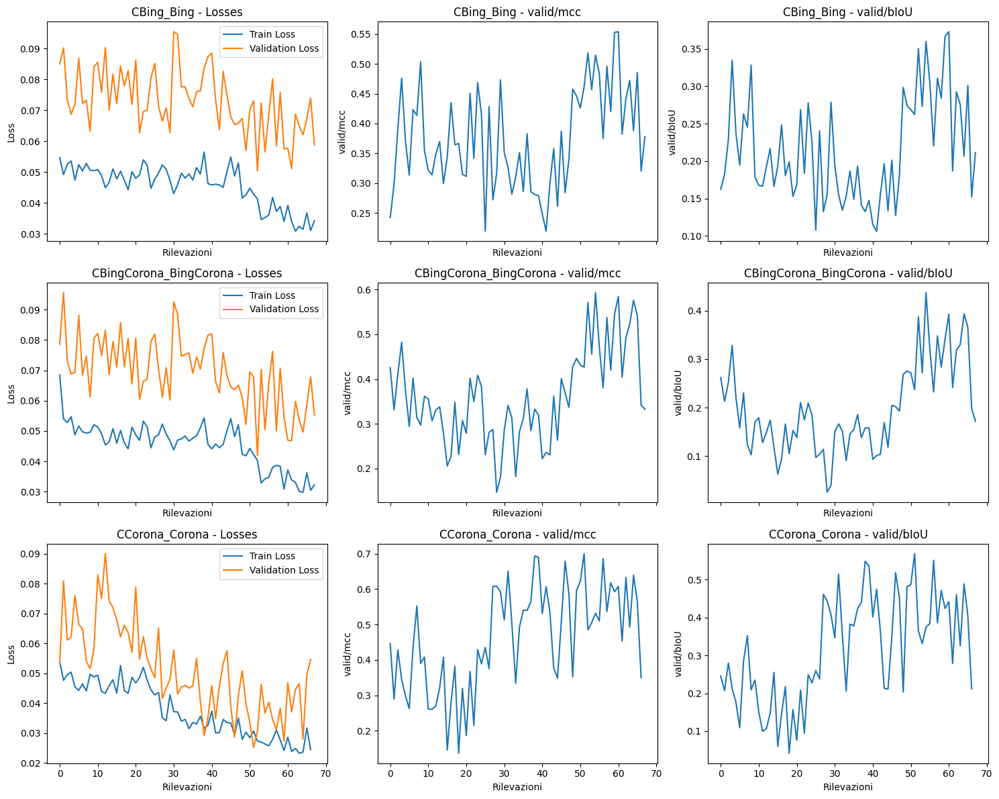

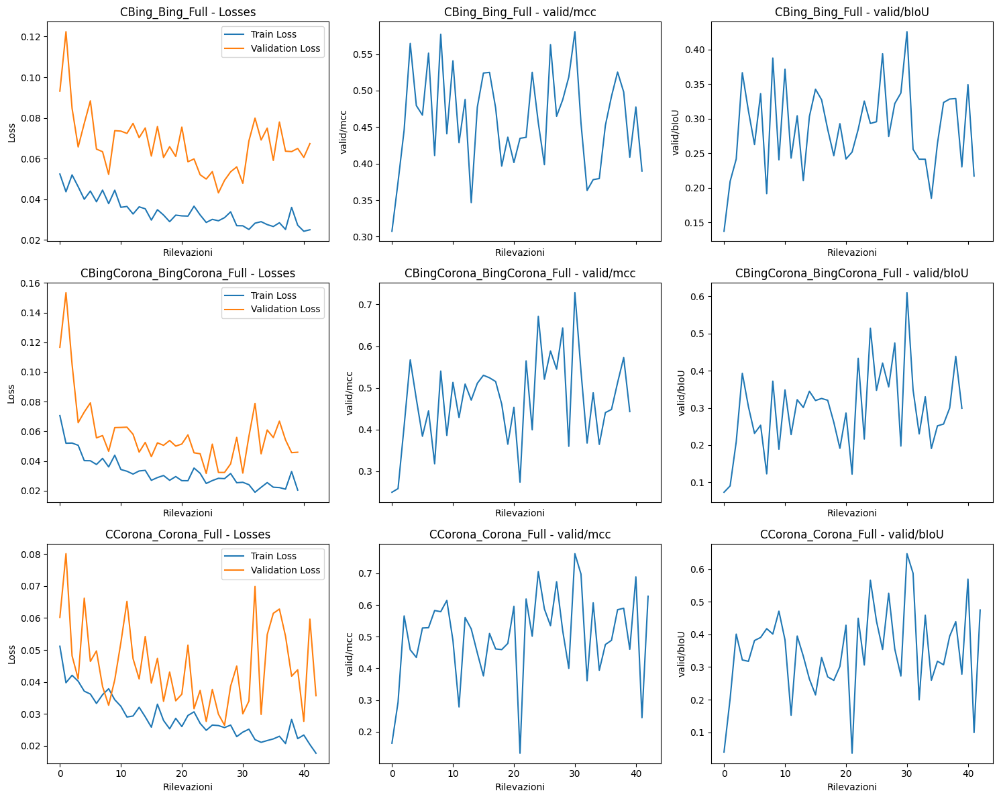

In [ ]:
modelli_2stage = ["CBing_Bing", "CBingCorona_BingCorona", "CCorona_Corona"]
plot_metrics_for_models(modelli_2stage)

modelli_full = ["CBing_Bing_Full", "CBingCorona_BingCorona_Full", "CCorona_Corona_Full"]
plot_metrics_for_models(modelli_full)

## Ensemble model



In [ ]:
sm_bing_path = PATH_CASINI + "outputs/bing_filtrato/best_model/"
bing_ckpt = os.listdir(sm_bing_path)[0]

sm_corona_path = PATH_CASINI + "outputs/corona_filtrato/best_model/"
corona_ckpt = os.listdir(sm_corona_path)[0]

modello = "ensemble_model"

In [ ]:
print("\n**** STARTING ENSEMBLE MODEL FINE TUNING ****")

# empty cache
torch.cuda.empty_cache()
set_config(modello)

print("\n**** Loading data ****")
images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])

train_transform, val_transform = esegui_trasformazioni()

train_dataset = ArcheoDataset(train_images_filenames, images_directory, masks_directory, transform = train_transform)
val_dataset = ArcheoDataset(val_images_filenames, images_directory, masks_directory, transform = val_transform)

train_loader = DataLoader(train_dataset, batch_size=config["batch_size"], shuffle=True, drop_last=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=2)

bing_model = ArcheoModel.load_from_checkpoint(
    arch = config["arch"],
    encoder_name = config["encoder"],
    encoder_weights = config["weights"],
    in_channels = 3,
    out_classes = 1,
    checkpoint_path = sm_bing_path + bing_ckpt
)

corona_model = ArcheoModel.load_from_checkpoint(
    arch = config["arch"],
    encoder_name = config["encoder"],
    encoder_weights = config["weights"],
    in_channels = 3,
    out_classes = 1,
    checkpoint_path = sm_corona_path + corona_ckpt
)

ensemble_model = EnsembleArcheoModel(bing_model, corona_model)

# set CSV logger for metrics
csv_logger = CSVLogger(
    save_dir = config["log_path"],
    name = "metrics-full",
    flush_logs_every_n_steps=1
)

# initialize callbacks
early_stop = EarlyStopping(monitor="valid/loss", patience=15, mode="min")
checkpoint_callback = ModelCheckpoint(save_top_k=1, monitor="valid/mcc", mode="max", dirpath=config["checkpoint_path"], filename='full-{epoch}-{step}')

# set trainer configs
trainer = pl.Trainer (
  max_epochs = 110,
  precision = config["precision"],
  accelerator = "auto",
  logger = [csv_logger],
  log_every_n_steps = 1,
  enable_progress_bar = True,
  enable_checkpointing=True,
  callbacks=[RichProgressBar(refresh_rate=1), early_stop, checkpoint_callback]
)

trainer.fit(ensemble_model, train_dataloaders = train_loader, val_dataloaders = val_loader)

os.makedirs(PATH_OUTPUT + modello + '/best_model/', exist_ok = True)
os.rename(checkpoint_callback.best_model_path, PATH_OUTPUT + modello + '/best_model/' + Path(checkpoint_callback.best_model_path).name)


**** STARTING ENSEMBLE MODEL FINE TUNING ****

**** Loading data ****
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓
┃   ┃ Name    ┃ Type                   ┃ Params ┃
┡━━━╇━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩
│ 0 │ modelA  │ ArcheoModel            │ 17.2 M │
│ 1 │ modelB  │ ArcheoModel            │ 17.2 M │
│ 2 │ conv    │ Conv2d                 │      3 │
│ 3 │ pool    │ MaxPool2d              │      0 │
│ 4 │ sigmoid │ Sigmoid                │      0 │
│ 5 │ loss_fn │ FocalLoss              │      0 │
│ 6 │ bIoU    │ BinaryIoU              │      0 │
│ 7 │ mcc     │ BinaryMatthewsCorrCoef │      0 │
└───┴─────────┴────────────────────────┴────────┘

Trainable params: 3                                                                                                
Non-trainable params: 34.3 M                                                                                       
Total params: 34.3 M                                                                                               
Total estimated model params size (MB): 137

Output()

# Test

In [ ]:
def test_models(models_list, verbose=True):

  modelli = models_list

  # 10 test, con diverse trasformazioni, per ogni modello.
  iou_test_modelli = {}
  mcc_test_modelli = {}
  biou_test_modelli = {}

  for i, model_name in enumerate(modelli):
    print("STARTING " + model_name + " TESTING")
    set_config(model_name)

    ckpt_path = f"{PATH_OUTPUT}{model_name}/best_model/"
    name_ckpt = os.listdir(ckpt_path)[0]
    print("Using: " + ckpt_path + name_ckpt)

    model = ArcheoModel.load_from_checkpoint(
        arch=config["arch"],
        encoder_name=config["encoder"],
        encoder_weights=config["weights"],
        in_channels=config["in_channels"],
        out_classes=1,
        checkpoint_path =  ckpt_path + name_ckpt
    )

    images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])
    train_transform, val_transform = esegui_trasformazioni()

    testiou=[]
    testmcc=[]
    testbiou=[]

    for j in range(10):
      print("\n Risultato " + str(j) + " del modello " + model_name)

      test_dataset = ArcheoDataset(test_images_filenames, images_directory, masks_directory, transform=val_transform)
      test_dataloader = DataLoader(test_dataset, batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

      trainer = pl.Trainer(
          max_epochs=40,
          precision='16-mixed',
          accelerator="auto"
      )

      test_metrics = trainer.test(model, dataloaders = test_dataloader, verbose=verbose)
      testiou.append(test_metrics[0]['test/IOU-img'])
      testmcc.append(test_metrics[0]['test/mcc'])
      testbiou.append(test_metrics[0]['test/bIoU'])

    iou_test_modelli[model_name] = testiou
    mcc_test_modelli[model_name] = testmcc
    biou_test_modelli[model_name] = testbiou

  return iou_test_modelli, mcc_test_modelli, biou_test_modelli

def print_metrics(iou_test_modelli, mcc_test_modelli, biou_test_modelli):
  # Stampo le statistiche per ogni modello (mean,min,max,std)
  for i in modelli:
    IoU = np.array(iou_test_modelli[i])
    mcc = np.array(mcc_test_modelli[i])
    biou = np.array(biou_test_modelli[i])

    print("\nLe statistiche sul test set per il modello " + i + " sono:")
    print("  IoU: ")
    print("    media: " + str(round(IoU.mean(), 4)) + " | min: " + str(round(IoU.min(), 4)) +" | max: " + str(round(IoU.max(), 4))+ " | std: " + str(round(IoU.std(), 4)))
    print("  MCC: ")
    print("    media: " + str(round(mcc.mean(), 4)) + " | min: " + str(round(mcc.min(), 4)) +" | max: " + str(round(mcc.max(), 4))+ " | std: " + str(round(mcc.std(), 4)))
    print("  BinaryIoU: ")
    print("    media: " + str(round(biou.mean(), 4)) + " | min: " + str(round(biou.min(), 4)) +" | max: " + str(round(biou.max(), 4))+ " | std: " + str(round(biou.std(), 4)) + "\n")

In [ ]:
modelli = ["CBing_Bing_Full", "CBing_Bing", "CBingCorona_BingCorona_Full", "CBingCorona_BingCorona", "CCorona_Corona_Full", "CCorona_Corona"]

m1, m2, m3 = test_models(modelli)

STARTING CBing_Bing_Full TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBing_Bing_Full/best_model/full-epoch=30-step=558.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CBing_Bing_Full


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.09343685209751129    │
│       test/IOU-img        │    0.8309450149536133     │
│         test/bIoU         │    0.10771256685256958    │
│         test/loss         │            nan            │
│         test/mcc          │    0.23693831264972687    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.12040842324495316    │
│       test/IOU-img        │    0.8526564836502075     │
│         test/bIoU         │    0.21798057854175568    │
│         test/loss         │            nan            │
│         test/mcc          │    0.35786595940589905    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.16544705629348755    │
│       test/IOU-img        │    0.8618457317352295     │
│         test/bIoU         │    0.1966286450624466     │
│         test/loss         │            nan            │
│         test/mcc          │    0.2571379840373993     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.22785860300064087    │
│       test/IOU-img        │    0.8823016881942749     │
│         test/bIoU         │    0.3043128550052643     │
│         test/loss         │            nan            │
│         test/mcc          │    0.43984007835388184    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.19037602841854095    │
│       test/IOU-img        │    0.8659384250640869     │
│         test/bIoU         │     0.129961296916008     │
│         test/loss         │            nan            │
│         test/mcc          │    0.2874678671360016     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.15703272819519043    │
│       test/IOU-img        │    0.8511300086975098     │
│         test/bIoU         │    0.3160724937915802     │
│         test/loss         │            nan            │
│         test/mcc          │    0.47605812549591064    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.06972160935401917    │
│       test/IOU-img        │    0.8222945332527161     │
│         test/bIoU         │    0.15504755079746246    │
│         test/loss         │            nan            │
│         test/mcc          │    0.2366427332162857     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.28021878004074097    │
│       test/IOU-img        │    0.9054962396621704     │
│         test/bIoU         │    0.32471591234207153    │
│         test/loss         │    0.03446017578244209    │
│         test/mcc          │    0.5272312164306641     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2075858861207962     │
│       test/IOU-img        │    0.9035285711288452     │
│         test/bIoU         │    0.21962065994739532    │
│         test/loss         │            nan            │
│         test/mcc          │     0.362900972366333     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CBing_Bing_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.31293556094169617    │
│       test/IOU-img        │    0.8674994111061096     │
│         test/bIoU         │    0.20101453363895416    │
│         test/loss         │            nan            │
│         test/mcc          │    0.3350333869457245     │
└───────────────────────────┴───────────────────────────┘

STARTING CBing_Bing TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBing_Bing/best_model/epoch=15-step=288.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.18549689650535583    │
│       test/IOU-img        │    0.8456339240074158     │
│         test/bIoU         │    0.16158907115459442    │
│         test/loss         │            nan            │
│         test/mcc          │    0.3165128529071808     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.10188335180282593    │
│       test/IOU-img        │     0.838933527469635     │
│         test/bIoU         │    0.14034046232700348    │
│         test/loss         │            nan            │
│         test/mcc          │    0.27918627858161926    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.08522769808769226    │
│       test/IOU-img        │    0.8408293724060059     │
│         test/bIoU         │    0.10721153765916824    │
│         test/loss         │            nan            │
│         test/mcc          │    0.1985747069120407     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2943961024284363     │
│       test/IOU-img        │     0.887778103351593     │
│         test/bIoU         │    0.4003079831600189     │
│         test/loss         │            nan            │
│         test/mcc          │    0.4960780441761017     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.30973440408706665    │
│       test/IOU-img        │    0.8751314282417297     │
│         test/bIoU         │    0.2169082909822464     │
│         test/loss         │            nan            │
│         test/mcc          │    0.36766019463539124    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.12118694931268692    │
│       test/IOU-img        │    0.8466993570327759     │
│         test/bIoU         │    0.29222479462623596    │
│         test/loss         │            nan            │
│         test/mcc          │    0.4057275056838989     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.06247854605317116    │
│       test/IOU-img        │    0.8131201863288879     │
│         test/bIoU         │    0.13919000327587128    │
│         test/loss         │            nan            │
│         test/mcc          │     0.191384419798851     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2834521532058716     │
│       test/IOU-img        │    0.8968112468719482     │
│         test/bIoU         │    0.30346760153770447    │
│         test/loss         │            nan            │
│         test/mcc          │    0.4910392761230469     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.30577677488327026    │
│       test/IOU-img        │    0.9036961793899536     │
│         test/bIoU         │    0.21179597079753876    │
│         test/loss         │            nan            │
│         test/mcc          │    0.3386324346065521     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CBing_Bing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │     0.287009596824646     │
│       test/IOU-img        │    0.8638302087783813     │
│         test/bIoU         │    0.17987477779388428    │
│         test/loss         │            nan            │
│         test/mcc          │    0.31850096583366394    │
└───────────────────────────┴───────────────────────────┘

STARTING CBingCorona_BingCorona_Full TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBingCorona_BingCorona_Full/best_model/full-epoch=30-step=558.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.43314895033836365    │
│       test/IOU-img        │    0.8823363780975342     │
│         test/bIoU         │    0.45553818345069885    │
│         test/loss         │            nan            │
│         test/mcc          │    0.6252520084381104     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3315103352069855     │
│       test/IOU-img        │    0.8735052347183228     │
│         test/bIoU         │     0.342810720205307     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5497568249702454     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.32685697078704834    │
│       test/IOU-img        │    0.8541945815086365     │
│         test/bIoU         │    0.2600463330745697     │
│         test/loss         │            nan            │
│         test/mcc          │    0.4546697437763214     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2805759906768799     │
│       test/IOU-img        │     0.833068311214447     │
│         test/bIoU         │    0.37870702147483826    │
│         test/loss         │            nan            │
│         test/mcc          │    0.5081568360328674     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.42065927386283875    │
│       test/IOU-img        │     0.882909893989563     │
│         test/bIoU         │    0.41535162925720215    │
│         test/loss         │            nan            │
│         test/mcc          │    0.5661864876747131     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.4469037652015686     │
│       test/IOU-img        │    0.8761742115020752     │
│         test/bIoU         │    0.46414366364479065    │
│         test/loss         │            nan            │
│         test/mcc          │    0.5900976657867432     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.34187817573547363    │
│       test/IOU-img        │    0.8378422260284424     │
│         test/bIoU         │    0.3698608875274658     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5445488095283508     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.45885157585144043    │
│       test/IOU-img        │    0.9008331298828125     │
│         test/bIoU         │    0.4181840419769287     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5901051163673401     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.34603726863861084    │
│       test/IOU-img        │    0.8951194882392883     │
│         test/bIoU         │    0.2847736179828644     │
│         test/loss         │            nan            │
│         test/mcc          │    0.48313358426094055    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CBingCorona_BingCorona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.4399809241294861     │
│       test/IOU-img        │    0.8938660621643066     │
│         test/bIoU         │    0.43685197830200195    │
│         test/loss         │            nan            │
│         test/mcc          │    0.6194760203361511     │
└───────────────────────────┴───────────────────────────┘

STARTING CBingCorona_BingCorona TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBingCorona_BingCorona/best_model/epoch=9-step=180.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.45809462666511536    │
│       test/IOU-img        │    0.8652820587158203     │
│         test/bIoU         │    0.45894062519073486    │
│         test/loss         │            nan            │
│         test/mcc          │    0.6266956925392151     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3687547445297241     │
│       test/IOU-img        │    0.8438111543655396     │
│         test/bIoU         │    0.3757067620754242     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5639687776565552     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.25591692328453064    │
│       test/IOU-img        │    0.8288014531135559     │
│         test/bIoU         │    0.25419172644615173    │
│         test/loss         │    0.03702142462134361    │
│         test/mcc          │    0.44189414381980896    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3281603753566742     │
│       test/IOU-img        │    0.8378229141235352     │
│         test/bIoU         │    0.42239728569984436    │
│         test/loss         │            nan            │
│         test/mcc          │    0.5668258666992188     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.4003879427909851     │
│       test/IOU-img        │    0.8756974935531616     │
│         test/bIoU         │    0.41806110739707947    │
│         test/loss         │    0.03163330256938934    │
│         test/mcc          │    0.5734919309616089     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.5085849761962891     │
│       test/IOU-img        │    0.8770424723625183     │
│         test/bIoU         │    0.45342254638671875    │
│         test/loss         │            nan            │
│         test/mcc          │    0.6247915625572205     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.38422152400016785    │
│       test/IOU-img        │    0.8429528474807739     │
│         test/bIoU         │    0.40670523047447205    │
│         test/loss         │            nan            │
│         test/mcc          │    0.5731858015060425     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.36785537004470825    │
│       test/IOU-img        │    0.8981776237487793     │
│         test/bIoU         │    0.42639943957328796    │
│         test/loss         │   0.029261713847517967    │
│         test/mcc          │     0.597613513469696     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.35662245750427246    │
│       test/IOU-img        │    0.8476781845092773     │
│         test/bIoU         │    0.2938477694988251     │
│         test/loss         │            nan            │
│         test/mcc          │    0.46245089173316956    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CBingCorona_BingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3244010806083679     │
│       test/IOU-img        │    0.8598833084106445     │
│         test/bIoU         │    0.4128587245941162     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5322484374046326     │
└───────────────────────────┴───────────────────────────┘

STARTING CCorona_Corona_Full TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CCorona_Corona_Full/best_model/full-epoch=30-step=558.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/corona/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/corona/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │     0.469063937664032     │
│       test/IOU-img        │    0.8676929473876953     │
│         test/bIoU         │    0.46170222759246826    │
│         test/loss         │            nan            │
│         test/mcc          │    0.6082255840301514     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │     0.278906911611557     │
│       test/IOU-img        │    0.8377230167388916     │
│         test/bIoU         │    0.31060412526130676    │
│         test/loss         │            nan            │
│         test/mcc          │    0.37534818053245544    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.07377860695123672    │
│       test/IOU-img        │    0.8032883405685425     │
│         test/bIoU         │    0.1152026578783989     │
│         test/loss         │            nan            │
│         test/mcc          │    0.21854840219020844    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3238173723220825     │
│       test/IOU-img        │    0.8445595502853394     │
│         test/bIoU         │    0.22895057499408722    │
│         test/loss         │            nan            │
│         test/mcc          │    0.34606122970581055    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2661011517047882     │
│       test/IOU-img        │    0.8357000350952148     │
│         test/bIoU         │    0.2327306866645813     │
│         test/loss         │            nan            │
│         test/mcc          │    0.37470734119415283    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2856496572494507     │
│       test/IOU-img        │     0.826069712638855     │
│         test/bIoU         │    0.2963819205760956     │
│         test/loss         │            nan            │
│         test/mcc          │    0.38112032413482666    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2896367311477661     │
│       test/IOU-img        │    0.8454403281211853     │
│         test/bIoU         │    0.1994372457265854     │
│         test/loss         │            nan            │
│         test/mcc          │    0.3166496753692627     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.22423064708709717    │
│       test/IOU-img        │    0.8742626905441284     │
│         test/bIoU         │    0.2824094593524933     │
│         test/loss         │            nan            │
│         test/mcc          │    0.4589920938014984     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │     0.214560404419899     │
│       test/IOU-img        │    0.8812258839607239     │
│         test/bIoU         │    0.22861869633197784    │
│         test/loss         │   0.021842068061232567    │
│         test/mcc          │    0.43314453959465027    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CCorona_Corona_Full


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3202846348285675     │
│       test/IOU-img        │    0.8716070652008057     │
│         test/bIoU         │    0.3193362057209015     │
│         test/loss         │            nan            │
│         test/mcc          │    0.44792822003364563    │
└───────────────────────────┴───────────────────────────┘

STARTING CCorona_Corona TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CCorona_Corona/best_model/epoch=27-step=504.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/corona/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/corona/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3835568130016327     │
│       test/IOU-img        │    0.8592585325241089     │
│         test/bIoU         │    0.3416665494441986     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5203256011009216     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.4656476080417633     │
│       test/IOU-img        │    0.8606710433959961     │
│         test/bIoU         │    0.44532355666160583    │
│         test/loss         │            nan            │
│         test/mcc          │    0.5669323205947876     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.08922899514436722    │
│       test/IOU-img        │    0.7909454107284546     │
│         test/bIoU         │    0.1688210815191269     │
│         test/loss         │            nan            │
│         test/mcc          │    0.26028749346733093    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.20249314606189728    │
│       test/IOU-img        │    0.7952985763549805     │
│         test/bIoU         │    0.2550535202026367     │
│         test/loss         │            nan            │
│         test/mcc          │    0.3834453523159027     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.32417553663253784    │
│       test/IOU-img        │    0.8255587816238403     │
│         test/bIoU         │    0.30446362495422363    │
│         test/loss         │            nan            │
│         test/mcc          │    0.43700888752937317    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.4899256229400635     │
│       test/IOU-img        │     0.872065544128418     │
│         test/bIoU         │     0.415828138589859     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5438370108604431     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.31084662675857544    │
│       test/IOU-img        │    0.8707135915756226     │
│         test/bIoU         │     0.290997713804245     │
│         test/loss         │            nan            │
│         test/mcc          │    0.4834078848361969     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3453499674797058     │
│       test/IOU-img        │    0.8903330564498901     │
│         test/bIoU         │    0.4790506064891815     │
│         test/loss         │            nan            │
│         test/mcc          │    0.6299495100975037     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2757830023765564     │
│       test/IOU-img        │    0.8830395936965942     │
│         test/bIoU         │    0.2937316596508026     │
│         test/loss         │            nan            │
│         test/mcc          │    0.46509334444999695    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CCorona_Corona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.22371914982795715    │
│       test/IOU-img        │    0.8606946468353271     │
│         test/bIoU         │     0.323688805103302     │
│         test/loss         │            nan            │
│         test/mcc          │    0.43622246384620667    │
└───────────────────────────┴───────────────────────────┘

In [ ]:
print_metrics(m1, m2, m3)


Le statistiche sul test set per il modello CBing_Bing_Full sono:
  IoU: 
    media: 0.8644 | min: 0.8223 | max: 0.9055 | std: 0.026
  MCC: 
    media: 0.3517 | min: 0.2366 | max: 0.5272 | std: 0.0969
  BinaryIoU: 
    media: 0.2173 | min: 0.1077 | max: 0.3247 | std: 0.0729


Le statistiche sul test set per il modello CBing_Bing sono:
  IoU: 
    media: 0.8612 | min: 0.8131 | max: 0.9037 | std: 0.0277
  MCC: 
    media: 0.3403 | min: 0.1914 | max: 0.4961 | std: 0.0995
  BinaryIoU: 
    media: 0.2153 | min: 0.1072 | max: 0.4003 | std: 0.0867


Le statistiche sul test set per il modello CBingCorona_BingCorona_Full sono:
  IoU: 
    media: 0.873 | min: 0.8331 | max: 0.9008 | std: 0.0225
  MCC: 
    media: 0.5531 | min: 0.4547 | max: 0.6253 | std: 0.054
  BinaryIoU: 
    media: 0.3826 | min: 0.26 | max: 0.4641 | std: 0.066


Le statistiche sul test set per il modello CBingCorona_BingCorona sono:
  IoU: 
    media: 0.8577 | min: 0.8288 | max: 0.8982 | std: 0.0203
  MCC: 
    media: 0.5563 |

## Visualize test prediction

### View image, mask and prediction function

In [ ]:
def view_image_gtMask_pred(image, gt_mask, image_cutoff, filename):
  plt.figure(figsize=(15, 5))

  if(image.shape[0] == 6):
    image1, image2 = torch.tensor_split(image, 2, dim=0)

    plt.subplot(1, 4, 1)
    plt.imshow(image1.numpy().transpose(1, 2, 0))  # convert CHW -> HWC
    plt.title(filename)
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(image2.numpy().transpose(1, 2, 0))  # convert CHW -> HWC
    plt.title(filename)
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(gt_mask.numpy().squeeze()) # just squeeze classes dim, because we have only one class
    plt.title("Ground truth")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(image_cutoff) # just squeeze classes dim, because we have only one class
    plt.title("Prediction")
    plt.axis("off")
  else:
    plt.subplot(1, 3, 1)
    plt.imshow(image.numpy().transpose(1, 2, 0))  # convert CHW -> HWC
    plt.title(filename)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(gt_mask.numpy().squeeze()) # just squeeze classes dim, because we have only one class
    plt.title("Ground truth")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(image_cutoff) # just squeeze classes dim, because we have only one class
    plt.title("Prediction")
    plt.axis("off")

  plt.show()

In [ ]:
models = ["CBing_Bing_Full", "CBingCorona_BingCorona"]


 Now model CBing_Bing_Full
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBing_Bing_Full/best_model/full-epoch=30-step=558.ckpt
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


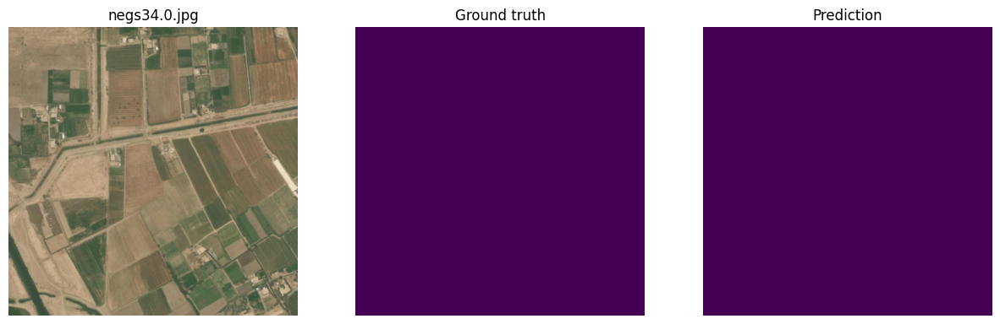

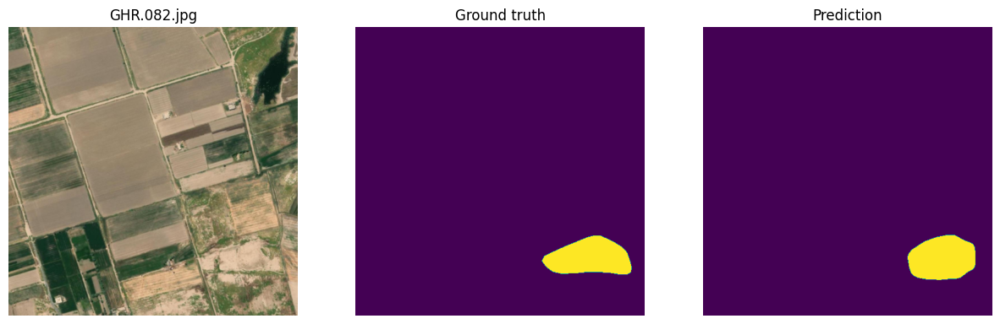

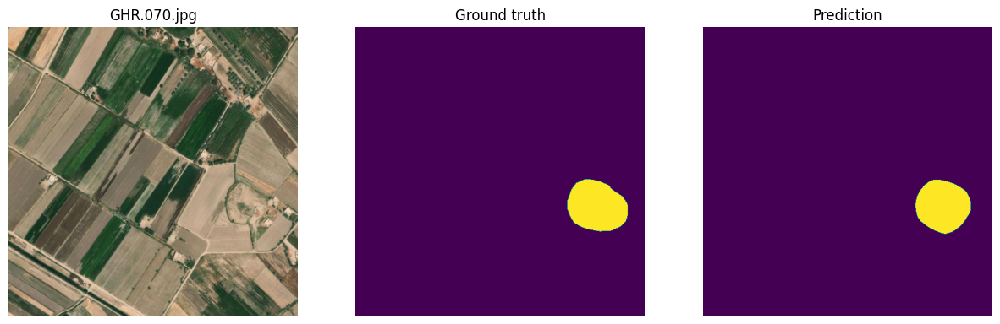

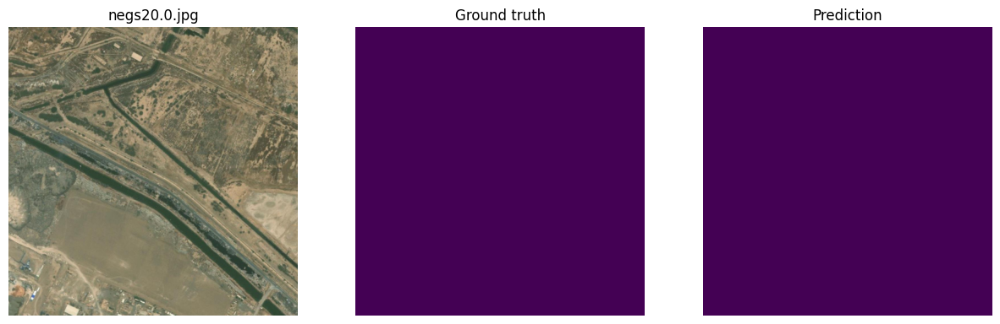

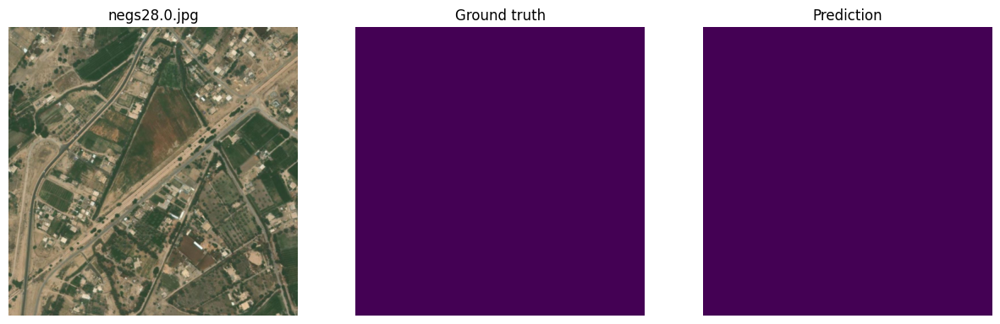

...

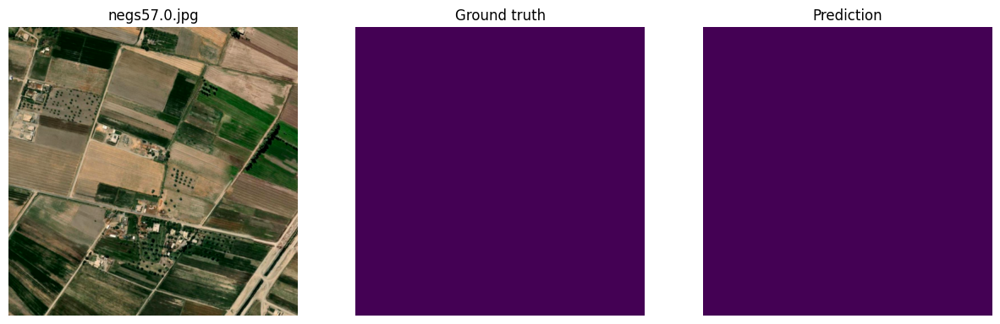

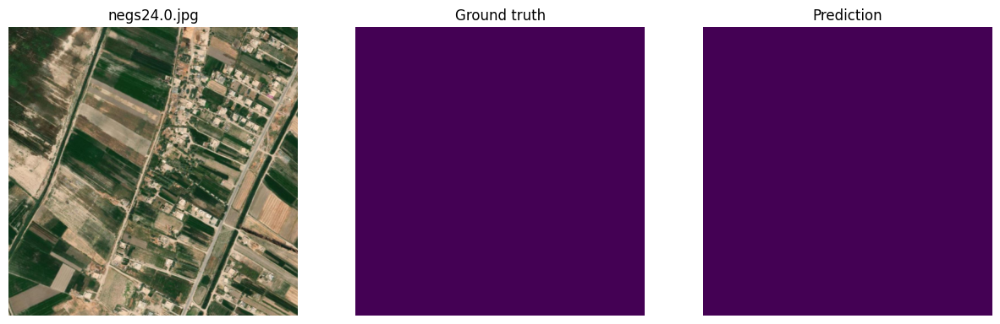

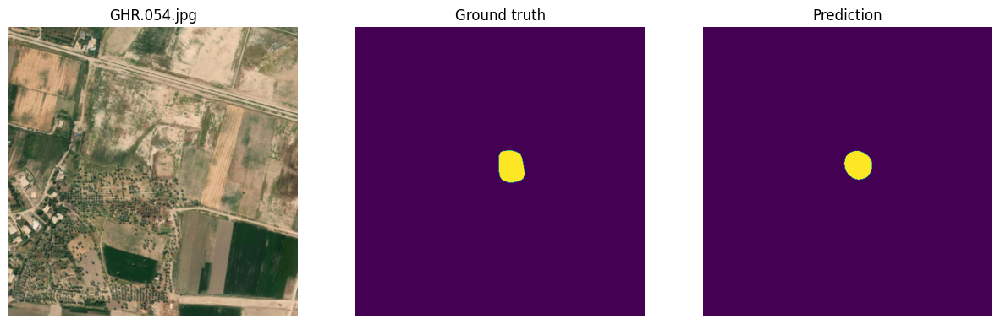

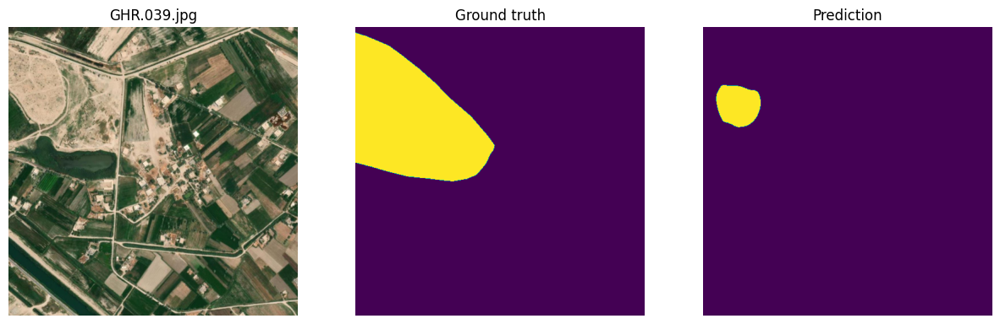

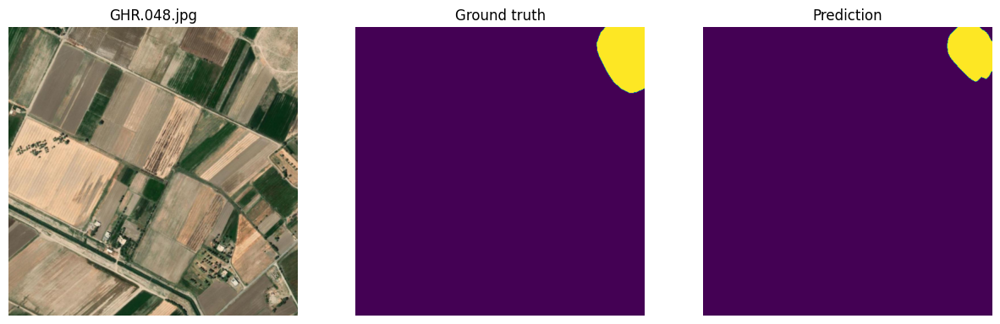


 Now model CBingCorona_BingCorona
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBingCorona_BingCorona/best_model/epoch=9-step=180.ckpt
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


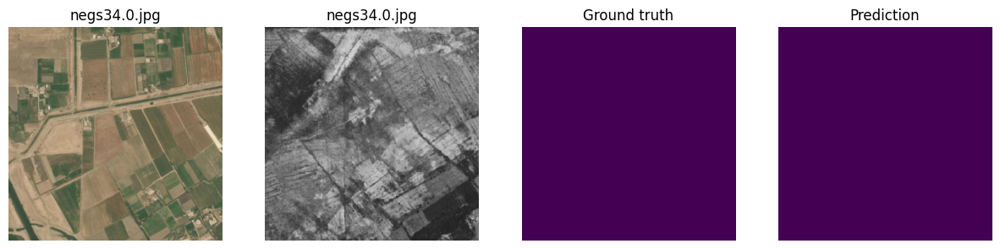

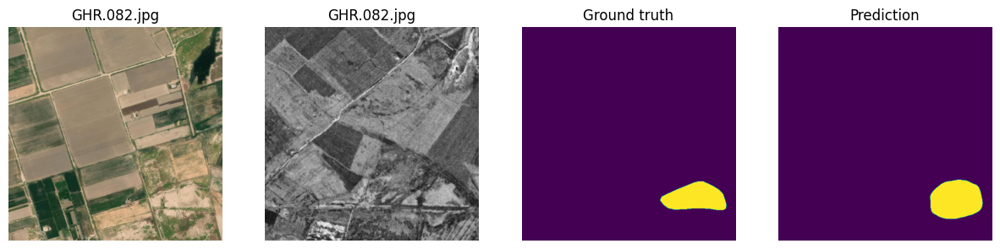

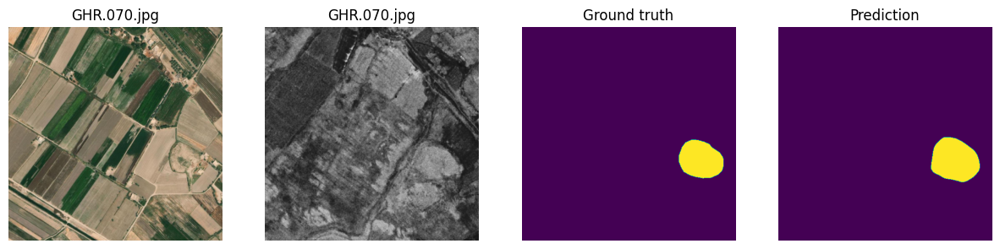

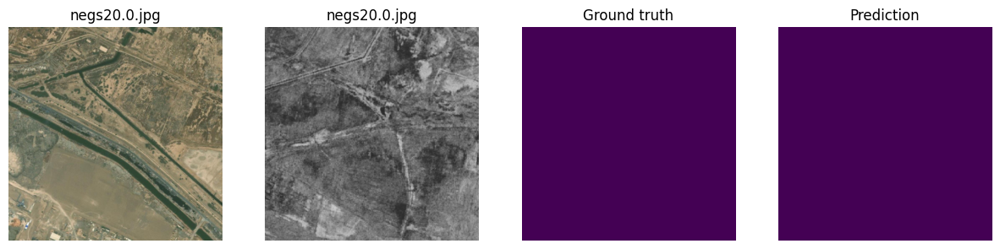

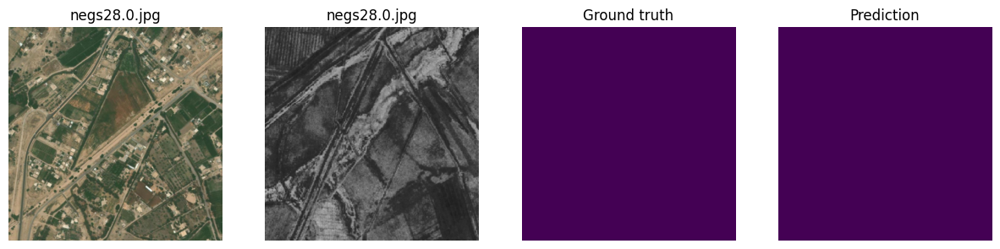

...

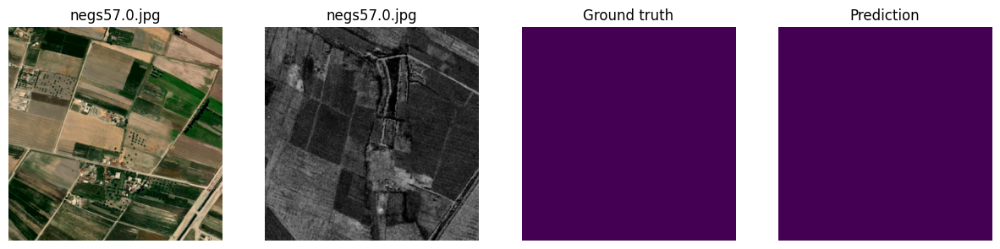

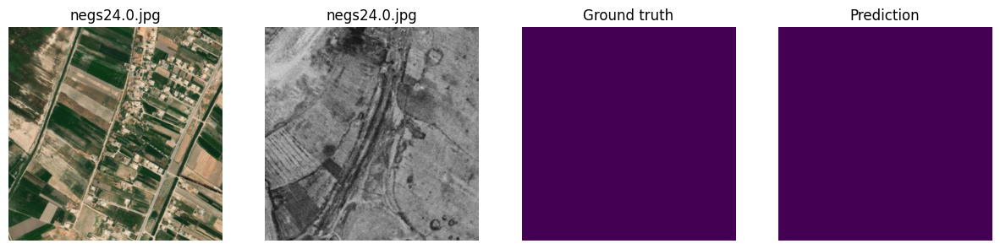

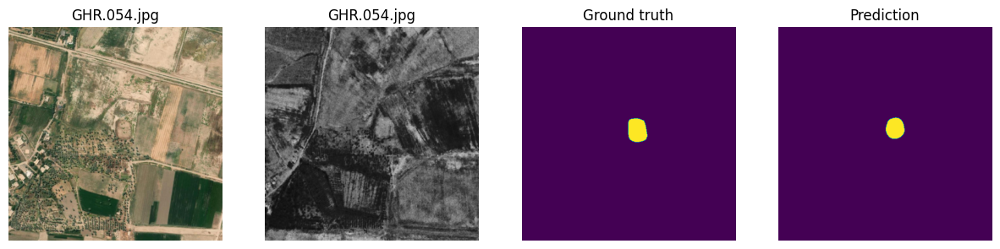

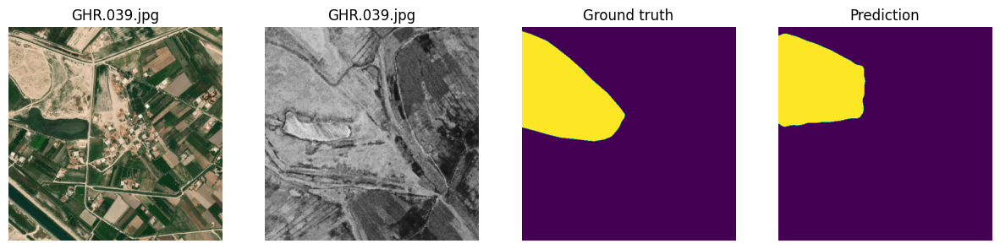

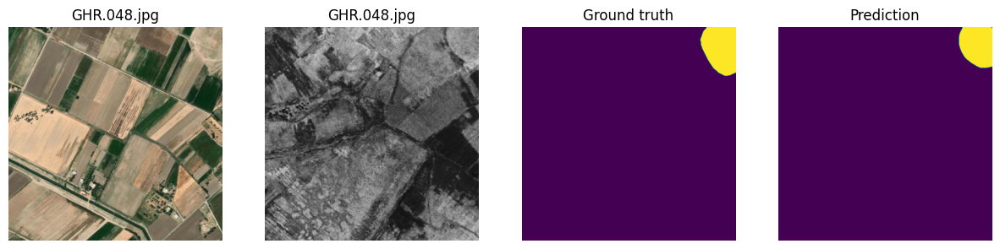

In [ ]:
for i, model_name in enumerate(models):
  set_config(model_name)
  print(f"\n Now model {model_name}")

  ckpt_path = f"{PATH_OUTPUT}{model_name}/best_model/"
  name_ckpt = os.listdir(ckpt_path)[0]
  print('Using: ' + ckpt_path + name_ckpt)

  images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])
  test_dataset = ArcheoDataset(test_images_filenames, images_directory, masks_directory, transform=val_transform)
  test_dataloader = DataLoader(test_dataset,batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

  model = ArcheoModel.load_from_checkpoint(
      arch=config["arch"],
      encoder_name=config["encoder"],
      in_channels=config["in_channels"],
      out_classes=1,
      checkpoint_path =  ckpt_path + name_ckpt
  )

  model.to(device)
  it = iter(test_dataloader)

  for j in range(len(it)):
    batch = next(it)
    with torch.no_grad():
      model.eval()
      logits = model(batch[0].cuda())
    pr_masks = logits.sigmoid().detach().cpu()

    for image, gt_mask, pr_mask, filename in zip(batch[0], batch[1], pr_masks, batch[2]):
        prob_mask = pr_mask.numpy().squeeze()

        # cutoff
        image_cutoff = prob_mask.copy()
        image_cutoff = gaussian_filter(image_cutoff, sigma=5)
        image_cutoff = ((image_cutoff + 0.5)**2) - 0.5
        image_cutoff[image_cutoff <= 0.5] = 0.0
        image_cutoff[image_cutoff > 0.5] = 1.0

        view_image_gtMask_pred(image, gt_mask, image_cutoff, filename)

In [ ]:
def view_image_gtMask_pred(image, gt_mask, image_cutoff, image_cutoff2, filename):
  plt.figure(figsize=(15, 5))

  if(image.shape[0] == 6):
    image1, image2 = torch.tensor_split(image, 2, dim=0)

    plt.subplot(1, 5, 1)
    plt.imshow(image1.numpy().transpose(1, 2, 0))  # convert CHW -> HWC
    plt.title(filename)
    plt.axis("off")

    plt.subplot(1, 5, 2)
    plt.imshow(image2.numpy().transpose(1, 2, 0))  # convert CHW -> HWC
    plt.title(filename)
    plt.axis("off")

    plt.subplot(1, 5, 3)
    plt.imshow(gt_mask.numpy().squeeze()) # just squeeze classes dim, because we have only one class
    plt.title("Ground truth")
    plt.axis("off")

    plt.subplot(1, 5, 4)
    plt.imshow(image_cutoff2) # just squeeze classes dim, because we have only one class
    plt.title("Prediction@0.2")
    plt.axis("off")

    plt.subplot(1, 5, 5)
    plt.imshow(image_cutoff) # just squeeze classes dim, because we have only one class
    plt.title("Prediction@0.5")
    plt.axis("off")
  else:
    plt.subplot(1, 4, 1)
    plt.imshow(image.numpy().transpose(1, 2, 0))  # convert CHW -> HWC
    plt.title(filename)
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(gt_mask.numpy().squeeze()) # just squeeze classes dim, because we have only one class
    plt.title("Ground truth")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(image_cutoff2) # just squeeze classes dim, because we have only one class
    plt.title("Prediction@0.2")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(image_cutoff) # just squeeze classes dim, because we have only one class
    plt.title("Prediction@0.5")
    plt.axis("off")

  plt.show()


 Now model CBing_Bing_Full
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBing_Bing_Full/best_model/full-epoch=30-step=558.ckpt
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


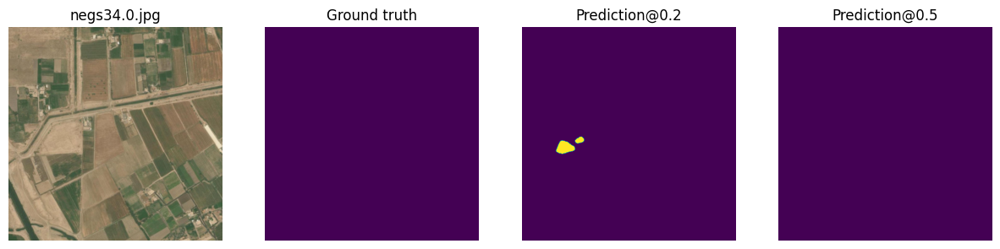

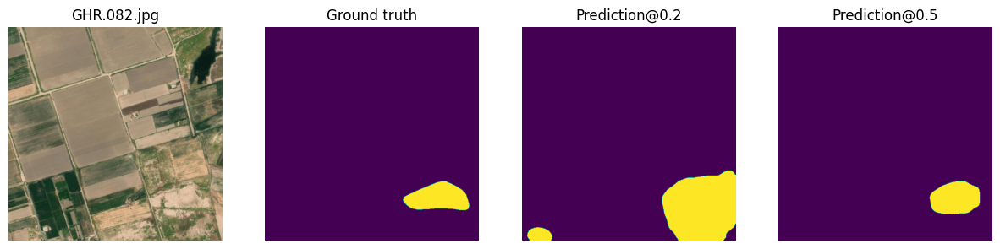

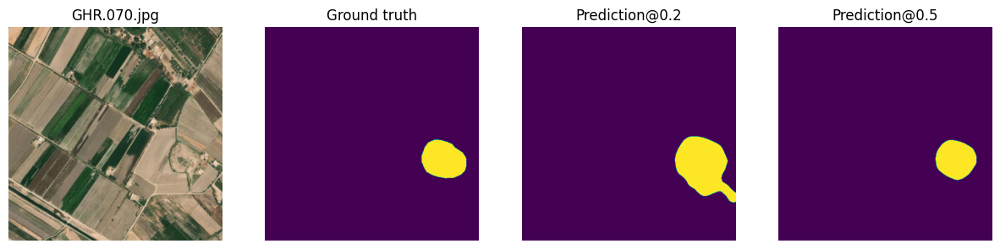

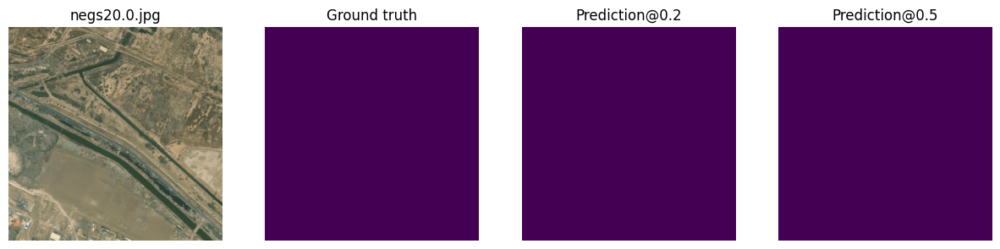

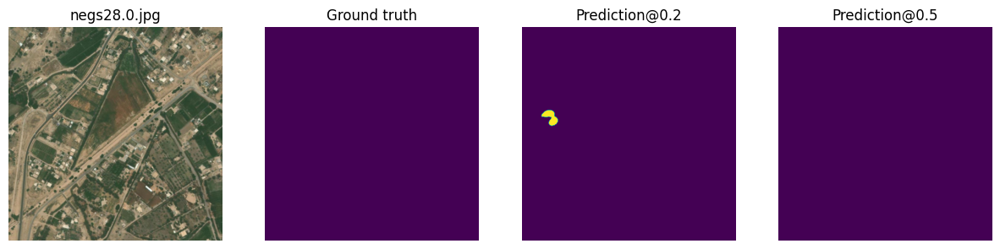

...

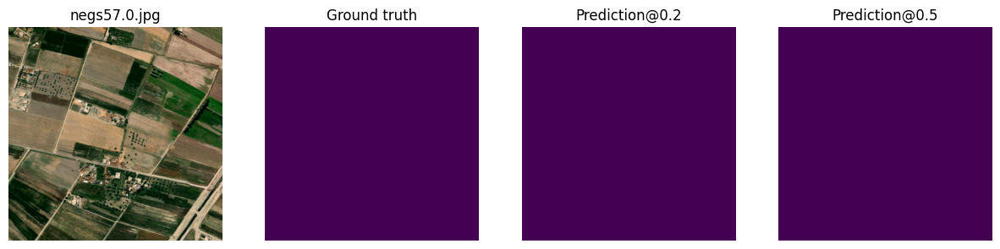

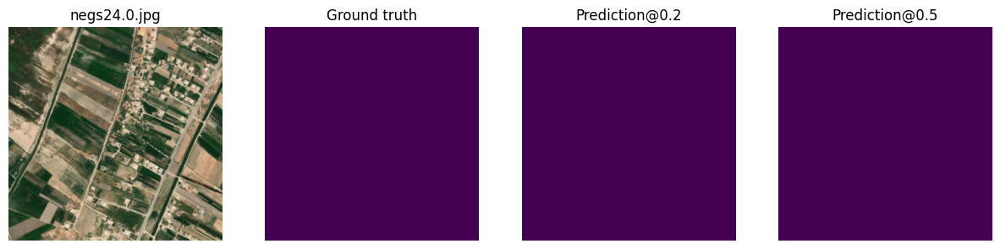

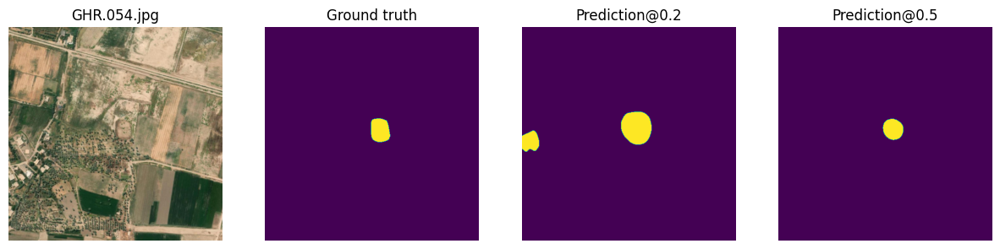

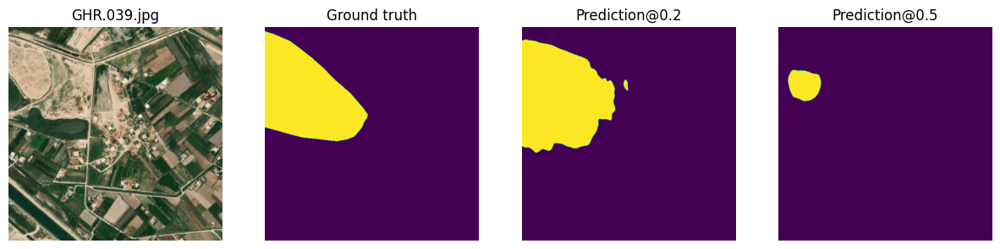

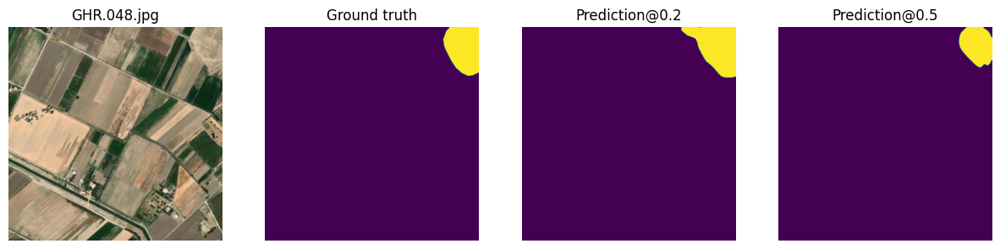


 Now model CBingCorona_BingCorona
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBingCorona_BingCorona/best_model/epoch=9-step=180.ckpt
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


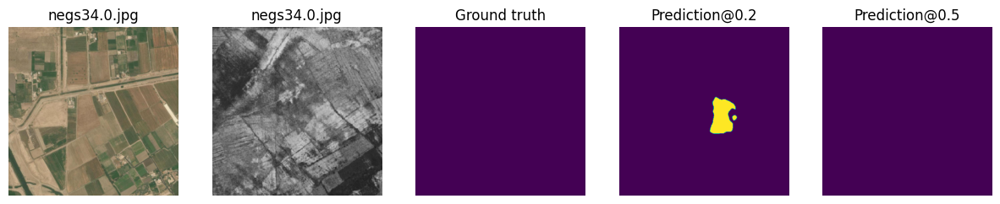

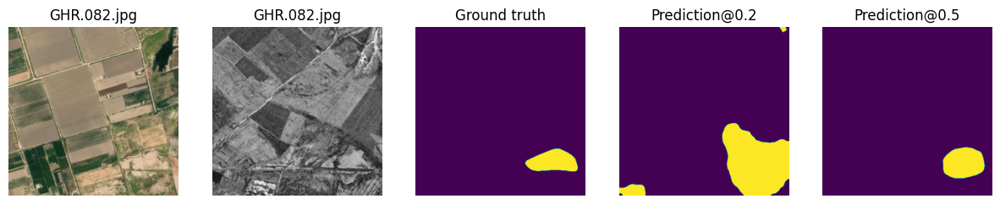

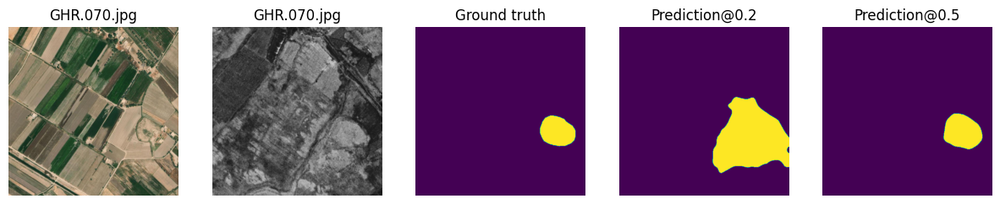

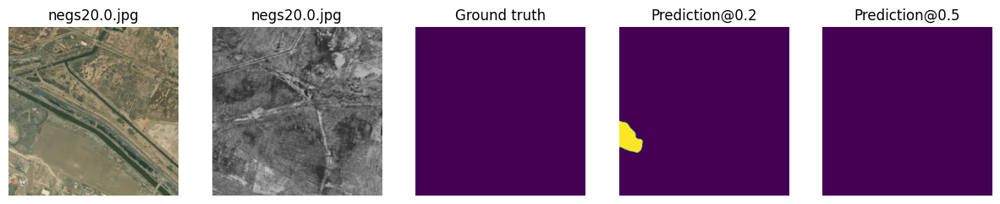

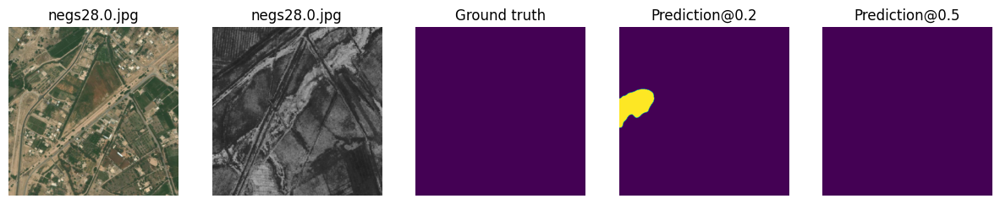

...

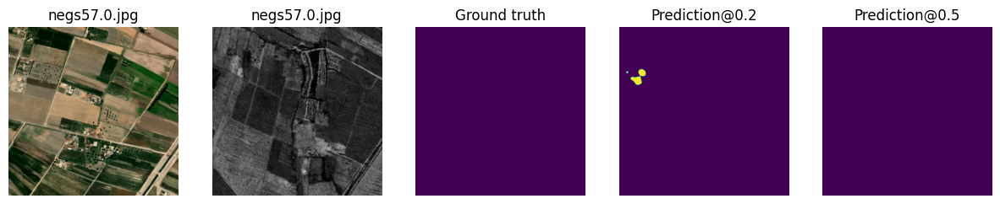

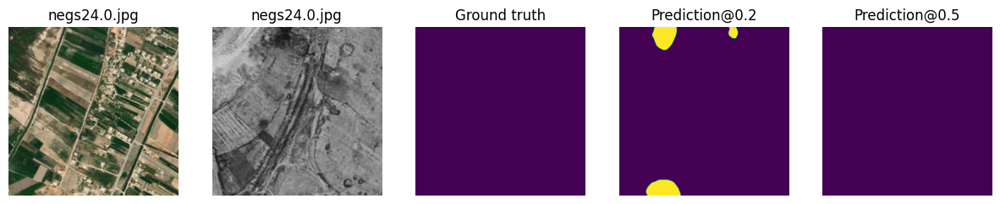

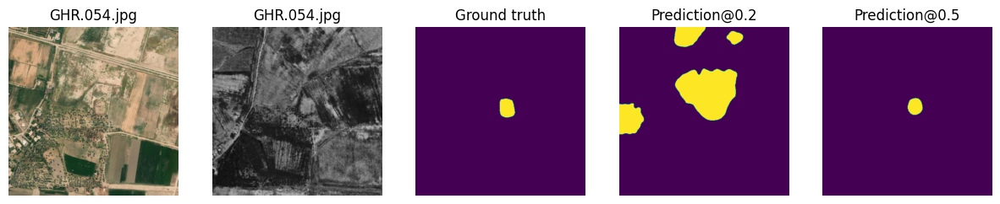

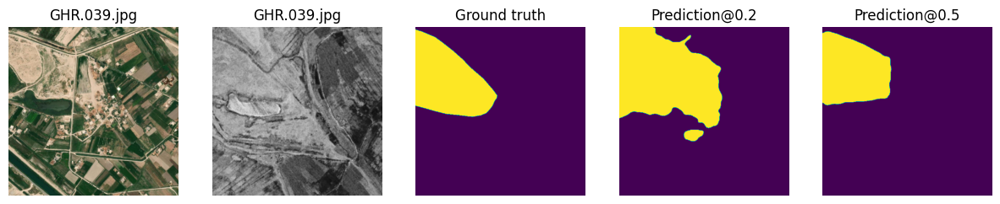

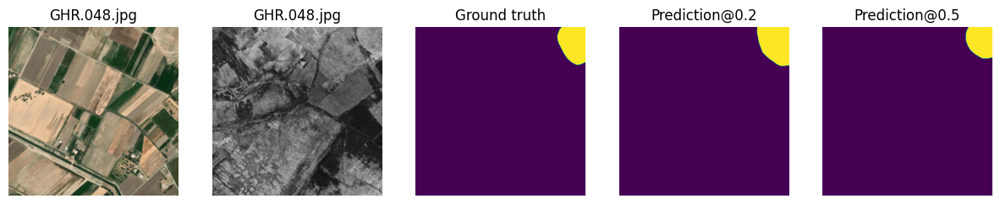


 Now model CCorona_Corona
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CCorona_Corona/best_model/epoch=27-step=504.ckpt
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/corona/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/corona/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


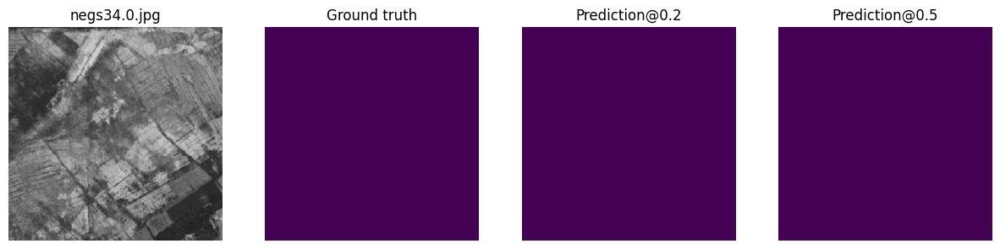

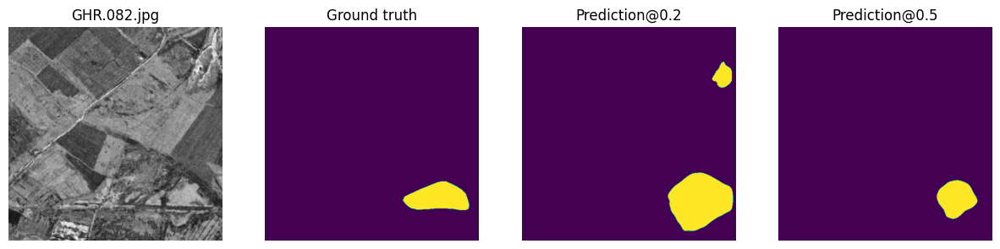

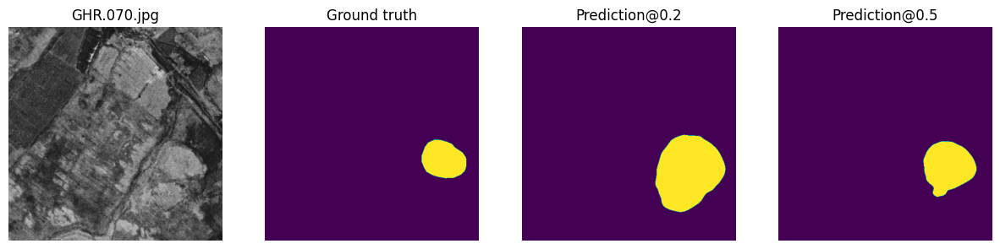

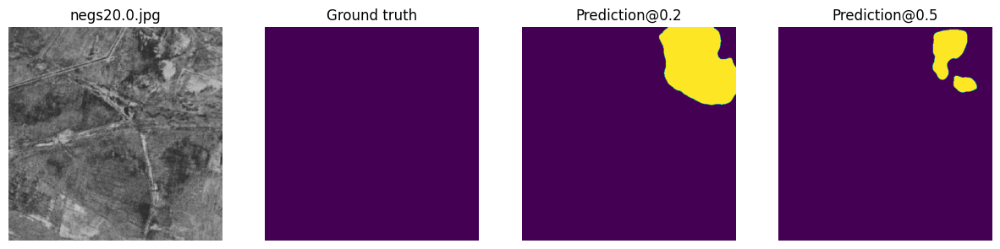

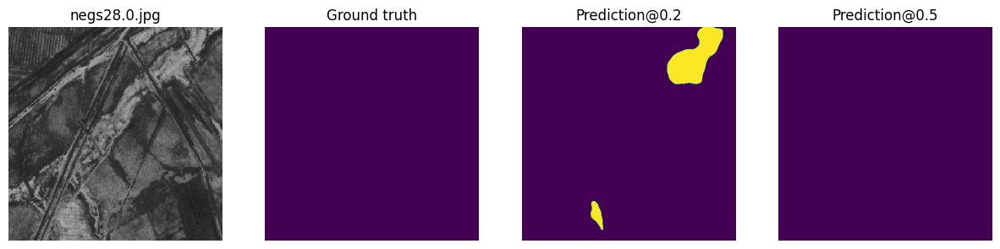

...

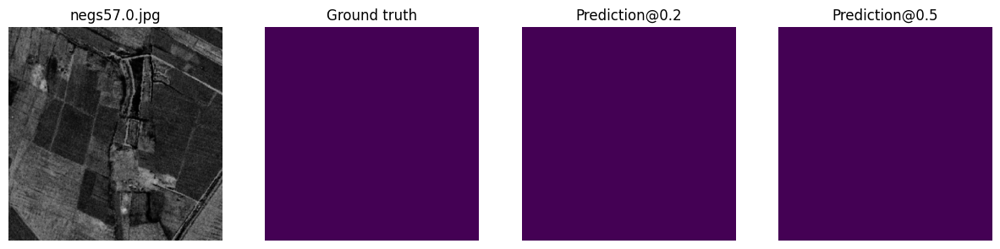

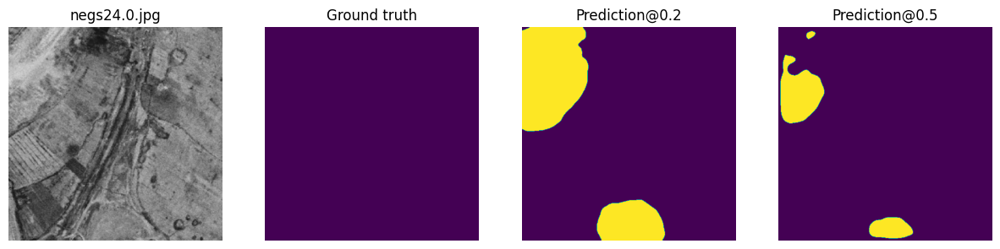

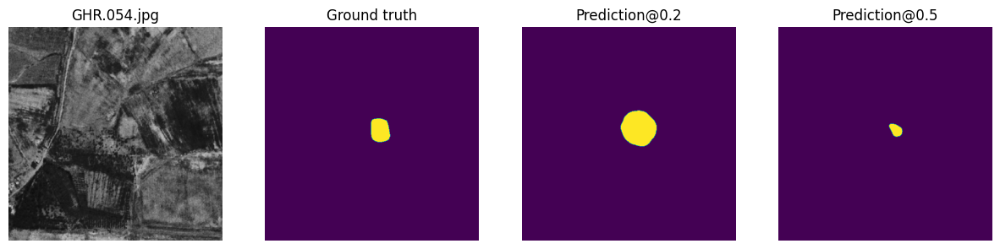

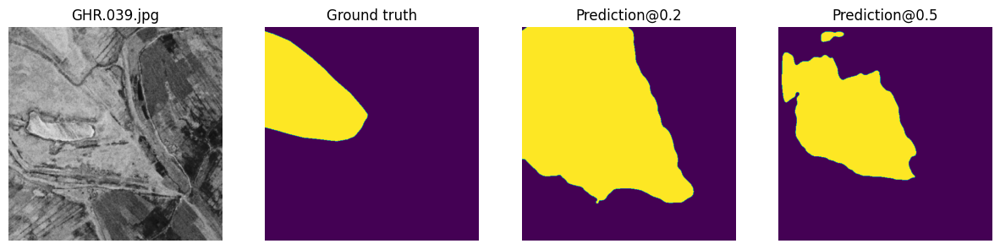

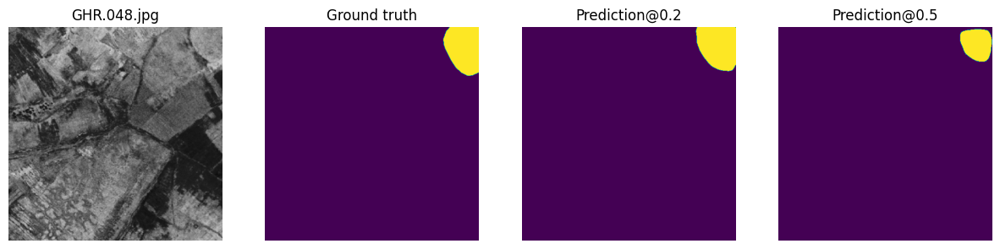

In [ ]:
models = ["CBing_Bing_Full", "CBingCorona_BingCorona", "CCorona_Corona"]

for i, model_name in enumerate(models):
  set_config(model_name)
  print(f"\n Now model {model_name}")

  ckpt_path = f"{PATH_OUTPUT}{model_name}/best_model/"
  name_ckpt = os.listdir(ckpt_path)[0]
  print('Using: ' + ckpt_path + name_ckpt)

  images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])
  test_dataset = ArcheoDataset(test_images_filenames, images_directory, masks_directory, transform=val_transform)
  test_dataloader = DataLoader(test_dataset,batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

  model = ArcheoModel.load_from_checkpoint(
      arch=config["arch"],
      encoder_name=config["encoder"],
      in_channels=config["in_channels"],
      out_classes=1,
      checkpoint_path =  ckpt_path + name_ckpt
  )

  model.to(device)
  it = iter(test_dataloader)

  for j in range(len(it)):
    batch = next(it)
    with torch.no_grad():
      model.eval()
      logits = model(batch[0])#.cuda())
    pr_masks = logits.sigmoid().detach().cpu()

    for image, gt_mask, pr_mask, filename in zip(batch[0], batch[1], pr_masks, batch[2]):
        prob_mask = pr_mask.numpy().squeeze()

        # cutoff
        image_cutoff = prob_mask.copy()
        image_cutoff = gaussian_filter(image_cutoff, sigma=5)
        image_cutoff = ((image_cutoff + 0.5)**2) - 0.5
        image_cutoff[image_cutoff <= 0.5] = 0.0
        image_cutoff[image_cutoff > 0.5] = 1.0

        image_cutoff2 = prob_mask.copy()
        image_cutoff2 = gaussian_filter(image_cutoff2, sigma=5)
        image_cutoff2 = ((image_cutoff2 + 0.5)**2) - 0.5
        image_cutoff2[image_cutoff2 <= 0.2] = 0.0
        image_cutoff2[image_cutoff2 > 0.2] = 1.0

        view_image_gtMask_pred(image, gt_mask, image_cutoff, image_cutoff2, filename)

## Fine tuning effect test

Dopo aver addestrato tutti i modelli proposti, si procede utilizzando i modelli del precedente lavoro, senza le immagini di AbuGhraib e si utilizzano come baseline in modo da quantificare l'aumento di performance dovuto al fine-tuning sul relativamente piccolo set di immagini a disposizione

In [ ]:
modelli_baseline = ["CBing", "CBingCorona", "CCorona"]

print_metrics(test_models(modelli_baseline, verbose=False))

STARTING CBing TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBing/best_model/Copia di epoch=19-step=10400.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.16572025418281555    │
│       test/IOU-img        │    0.7578879594802856     │
│         test/bIoU         │     0.132626011967659     │
│         test/loss         │            nan            │
│         test/mcc          │    0.22542031109333038    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.17624960839748383    │
│       test/IOU-img        │    0.8047415614128113     │
│         test/bIoU         │    0.2322305291891098     │
│         test/loss         │            nan            │
│         test/mcc          │    0.3595029413700104     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.23837527632713318    │
│       test/IOU-img        │     0.867741048336029     │
│         test/bIoU         │    0.2456292361021042     │
│         test/loss         │            nan            │
│         test/mcc          │    0.39134109020233154    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.18508045375347137    │
│       test/IOU-img        │     0.819378674030304     │
│         test/bIoU         │    0.31378909945487976    │
│         test/loss         │            nan            │
│         test/mcc          │    0.40877261757850647    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2587781548500061     │
│       test/IOU-img        │     0.843435525894165     │
│         test/bIoU         │    0.24263037741184235    │
│         test/loss         │            nan            │
│         test/mcc          │    0.37857556343078613    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.16224877536296844    │
│       test/IOU-img        │    0.8177608251571655     │
│         test/bIoU         │    0.30342647433280945    │
│         test/loss         │            nan            │
│         test/mcc          │    0.42272159457206726    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.10505108535289764    │
│       test/IOU-img        │    0.8079360723495483     │
│         test/bIoU         │    0.1851102113723755     │
│         test/loss         │            nan            │
│         test/mcc          │    0.32194849848747253    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.19421860575675964    │
│       test/IOU-img        │     0.854153573513031     │
│         test/bIoU         │    0.2528412342071533     │
│         test/loss         │    0.04424510523676872    │
│         test/mcc          │    0.42608538269996643    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.18155480921268463    │
│       test/IOU-img        │    0.8311918377876282     │
│         test/bIoU         │    0.2060273438692093     │
│         test/loss         │            nan            │
│         test/mcc          │    0.3174033463001251     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CBing


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.14294520020484924    │
│       test/IOU-img        │    0.8201184272766113     │
│         test/bIoU         │    0.15573227405548096    │
│         test/loss         │            nan            │
│         test/mcc          │    0.2722434997558594     │
└───────────────────────────┴───────────────────────────┘

STARTING CBingCorona TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CBingCorona/best_model/Copia di epoch=19-step=10400.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.30344337224960327    │
│       test/IOU-img        │    0.8431259393692017     │
│         test/bIoU         │    0.30516400933265686    │
│         test/loss         │    0.07053212076425552    │
│         test/mcc          │    0.5125294327735901     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2613462805747986     │
│       test/IOU-img        │     0.828104555606842     │
│         test/bIoU         │    0.27580028772354126    │
│         test/loss         │            nan            │
│         test/mcc          │    0.46940842270851135    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.17575427889823914    │
│       test/IOU-img        │    0.8186854720115662     │
│         test/bIoU         │    0.17783372104167938    │
│         test/loss         │    0.0761696845293045     │
│         test/mcc          │    0.32720187306404114    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3139716684818268     │
│       test/IOU-img        │    0.8433486223220825     │
│         test/bIoU         │    0.4086255133152008     │
│         test/loss         │   0.036625128239393234    │
│         test/mcc          │    0.5597212314605713     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.32061856985092163    │
│       test/IOU-img        │    0.8665458559989929     │
│         test/bIoU         │    0.2936619818210602     │
│         test/loss         │    0.0658612996339798     │
│         test/mcc          │    0.4525472819805145     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3655359148979187     │
│       test/IOU-img        │    0.8527323007583618     │
│         test/bIoU         │    0.3592638075351715     │
│         test/loss         │    0.0657103955745697     │
│         test/mcc          │     0.557613730430603     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2847260534763336     │
│       test/IOU-img        │    0.8339282274246216     │
│         test/bIoU         │    0.3273877799510956     │
│         test/loss         │            nan            │
│         test/mcc          │    0.5205199122428894     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.2084190398454666     │
│       test/IOU-img        │    0.8702970743179321     │
│         test/bIoU         │    0.2705179750919342     │
│         test/loss         │   0.056629572063684464    │
│         test/mcc          │    0.4476254880428314     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.24380648136138916    │
│       test/IOU-img        │    0.8425596952438354     │
│         test/bIoU         │    0.20895342528820038    │
│         test/loss         │            nan            │
│         test/mcc          │    0.34366628527641296    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CBingCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.32783496379852295    │
│       test/IOU-img        │    0.8309035301208496     │
│         test/bIoU         │    0.25249162316322327    │
│         test/loss         │            nan            │
│         test/mcc          │    0.38480082154273987    │
└───────────────────────────┴───────────────────────────┘

STARTING CCorona TESTING
Using: /content/drive/My Drive/ML/AbuGrahib/outputs/CCorona/best_model/Copia di epoch=19-step=10400.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/corona/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/corona/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.27959007024765015    │
│       test/IOU-img        │    0.8143338561058044     │
│         test/bIoU         │    0.23383118212223053    │
│         test/loss         │            nan            │
│         test/mcc          │    0.4188295304775238     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3109135031700134     │
│       test/IOU-img        │    0.8363868594169617     │
│         test/bIoU         │    0.3001224994659424     │
│         test/loss         │   0.027901330962777138    │
│         test/mcc          │    0.4542562663555145     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.06301632523536682    │
│       test/IOU-img        │    0.7957637906074524     │
│         test/bIoU         │    0.09042060375213623    │
│         test/loss         │            nan            │
│         test/mcc          │    0.14292104542255402    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.12565669417381287    │
│       test/IOU-img        │    0.8246926069259644     │
│         test/bIoU         │    0.11187722533941269    │
│         test/loss         │            nan            │
│         test/mcc          │    0.24450550973415375    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.19501741230487823    │
│       test/IOU-img        │    0.8355939388275146     │
│         test/bIoU         │    0.19754983484745026    │
│         test/loss         │            nan            │
│         test/mcc          │    0.3306180238723755     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.3557305932044983     │
│       test/IOU-img        │    0.8363972902297974     │
│         test/bIoU         │    0.24937330186367035    │
│         test/loss         │            nan            │
│         test/mcc          │    0.3779042959213257     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.1848626285791397     │
│       test/IOU-img        │    0.8329494595527649     │
│         test/bIoU         │    0.17983682453632355    │
│         test/loss         │            nan            │
│         test/mcc          │    0.3326132297515869     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.16904741525650024    │
│       test/IOU-img        │    0.8711230754852295     │
│         test/bIoU         │    0.17831003665924072    │
│         test/loss         │    0.02795727550983429    │
│         test/mcc          │    0.33909475803375244    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.20141564309597015    │
│       test/IOU-img        │    0.8576312065124512     │
│         test/bIoU         │    0.17969666421413422    │
│         test/loss         │   0.026418792083859444    │
│         test/mcc          │    0.30202051997184753    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello CCorona


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │    0.20747359097003937    │
│       test/IOU-img        │    0.8489489555358887     │
│         test/bIoU         │    0.15851883590221405    │
│         test/loss         │            nan            │
│         test/mcc          │    0.25502434372901917    │
└───────────────────────────┴───────────────────────────┘


Le statistiche sul test set per il modello CBing sono:
  IoU: 
    media: 0.8224 | min: 0.7579 | max: 0.8677 | std: 0.0288
  MCC: 
    media: 0.3524 | min: 0.2254 | max: 0.4261 | std: 0.0636
  BinaryIoU: 
    media: 0.227 | min: 0.1326 | max: 0.3138 | std: 0.0555


Le statistiche sul test set per il modello CBingCorona sono:
  IoU: 
    media: 0.843 | min: 0.8187 | max: 0.8703 | std: 0.0156
  MCC: 
    media: 0.4576 | min: 0.3272 | max: 0.5597 | std: 0.0793
  BinaryIoU: 
    media: 0.288 | min: 0.1778 | max: 0.4086 | std: 0.0645


Le statistiche sul test set per il modello CCorona sono:
  IoU: 
    media: 0.8354 | min: 0.7958 | max: 0.8711 | std: 0.0202
  MCC: 
    media: 0.3198 | min: 0.1429 | max: 0.4543 | std: 0.0857
  BinaryIoU: 
    media: 0.188 | min: 0.0904 | max: 0.3001 | std: 0.0591



## Ensemble Test

In [ ]:
#modelli = ["CCorona_Corona_Full", "CBing_Bing_Full", "CBingCorona_BingCorona_Full", "CCorona_Corona", "CBing_Bing", "CBingCorona_BingCorona"]
modelli = ["ensemble_model"]


# 10 test, con diverse trasformazioni, per ogni modello.
iou_test_modelli = {}
mcc_test_modelli = {}
biou_test_modelli = {}

for i, model_name in enumerate(modelli):
  set_config(model_name)

  ckpt_path = f"{PATH_OUTPUT}{model_name}/best_model/"
  name_ckpt = os.listdir(ckpt_path)[0]
  print("Using: " + name_ckpt)

  model = EnsembleArcheoModel.load_from_checkpoint(
      modelA = bing_model,
      modelB = corona_model,
      arch=config["arch"],
      encoder_name=config["encoder"],
      in_channels=config["in_channels"],
      out_classes=1,
      checkpoint_path =  ckpt_path + name_ckpt
  )

  images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])
  train_transform, val_transform = esegui_trasformazioni()

  testiou=[]
  testmcc=[]
  testbiou=[]
  for j in range(10):
    print("\n Risultato " + str(j) + " del modello " + modelli[i])

    test_dataset = ArcheoDataset(test_images_filenames, images_directory, masks_directory, transform=val_transform)
    test_dataloader = DataLoader(test_dataset,batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

    trainer = pl.Trainer(
        max_epochs=40,
        precision='16-mixed',
        accelerator="auto"
    )

    test_metrics = trainer.test(model, dataloaders = test_dataloader, verbose=True)
    testiou.append(test_metrics[0]['test/IOU-img'])
    testmcc.append(test_metrics[0]['test/mcc'])
    testbiou.append(test_metrics[0]['test/bIoU'])

  iou_test_modelli[modelli[i]] = testiou
  mcc_test_modelli[modelli[i]] = testmcc
  biou_test_modelli[modelli[i]] = testbiou

# Stampo le statistiche per ogni modello (mean,min,max,std)
for i in modelli:
  IoU = np.array(iou_test_modelli[i])
  mcc = np.array(mcc_test_modelli[i])
  biou = np.array(biou_test_modelli[i])

  print("\nLe statistiche sul test set per il modello " + i + " sono:")
  print("  IoU: ")
  print("    media: " + str(round(IoU.mean(), 4)) + " | min: " + str(round(IoU.min(), 4)) +" | max: " + str(round(IoU.max(), 4))+ " | std: " + str(round(IoU.std(), 4)))
  print("  MCC: ")
  print("    media: " + str(round(mcc.mean(), 4)) + " | min: " + str(round(mcc.min(), 4)) +" | max: " + str(round(mcc.max(), 4))+ " | std: " + str(round(mcc.std(), 4)))
  print("  BinaryIoU: ")
  print("    media: " + str(round(biou.mean(), 4)) + " | min: " + str(round(biou.min(), 4)) +" | max: " + str(round(biou.max(), 4))+ " | std: " + str(round(biou.std(), 4)) + "\n")


Using: full-epoch=2-step=54.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000

 Risultato 0 del modello ensemble_model


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │     0.789746105670929     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.0034052084665745497   │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 1 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │    0.8105469346046448     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.003967197146266699    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 2 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │    0.8225586414337158     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.003837303025647998    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 3 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │    0.8384765982627869     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.0035450563300400972   │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 4 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │    0.8587890267372131     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.004462793935090303    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 5 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │        0.037109375        │
│       test/IOU-img        │    0.8643555045127869     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.004048544447869062    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 6 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │    0.8352539539337158     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.003658647881820798    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 7 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │          0.03125          │
│       test/IOU-img        │     0.809277355670929     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.003919342532753944    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 8 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │    0.8462890982627869     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.004351713694632053    │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



 Risultato 9 del modello ensemble_model


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/IOU          │            0.0            │
│       test/IOU-img        │    0.8254883289337158     │
│         test/bIoU         │            0.0            │
│         test/loss         │            nan            │
│         test/mcc          │   0.0032046709675341845   │
└───────────────────────────┴───────────────────────────┘


Le statistiche sul test set per il modello ensemble_model sono:
  IoU: 
    media: 0.8301 | min: 0.7897 | max: 0.8644 | std: 0.0221
  MCC: 
    media: 0.0038 | min: 0.0032 | max: 0.0045 | std: 0.0004
  BinaryIoU: 
    media: 0.0 | min: 0.0 | max: 0.0 | std: 0.0

Using: full-epoch=2-step=54.ckpt


RuntimeError: Error(s) in loading state_dict for ArcheoModel:
	Missing key(s) in state_dict: "model.encoder._conv_stem.weight", "model.encoder._bn0.weight", "model.encoder._bn0.bias", "model.encoder._bn0.running_mean", "model.encoder._bn0.running_var", "model.encoder._blocks.0._depthwise_conv.weight", "model.encoder._blocks.0._bn1.weight", "model.encoder._blocks.0._bn1.bias", "model.encoder._blocks.0._bn1.running_mean", "model.encoder._blocks.0._bn1.running_var", "model.encoder._blocks.0._se_reduce.weight", "model.encoder._blocks.0._se_reduce.bias", "model.encoder._blocks.0._se_expand.weight", "model.encoder._blocks.0._se_expand.bias", "model.encoder._blocks.0._project_conv.weight", "model.encoder._blocks.0._bn2.weight", "model.encoder._blocks.0._bn2.bias", "model.encoder._blocks.0._bn2.running_mean", "model.encoder._blocks.0._bn2.running_var", "model.encoder._blocks.1._depthwise_conv.weight", "model.encoder._blocks.1._bn1.weight", "model.encoder._blocks.1._bn1.bias", "model.encoder._blocks.1._bn1.running_mean", "model.encoder._blocks.1._bn1.running_var", "model.encoder._blocks.1._se_reduce.weight", "model.encoder._blocks.1._se_reduce.bias", "model.encoder._blocks.1._se_expand.weight", "model.encoder._blocks.1._se_expand.bias", "model.encoder._blocks.1._project_conv.weight", "model.encoder._blocks.1._bn2.weight", "model.encoder._blocks.1._bn2.bias", "model.encoder._blocks.1._bn2.running_mean", "model.encoder._blocks.1._bn2.running_var", "model.encoder._blocks.2._expand_conv.weight", "model.encoder._blocks.2._bn0.weight", "model.encoder._blocks.2._bn0.bias", "model.encoder._blocks.2._bn0.running_mean", "model.encoder._blocks.2._bn0.running_var", "model.encoder._blocks.2._depthwise_conv.weight", "model.encoder._blocks.2._bn1.weight", "model.encoder._blocks.2._bn1.bias", "model.encoder._blocks.2._bn1.running_mean", "model.encoder._blocks.2._bn1.running_var", "model.encoder._blocks.2._se_reduce.weight", "model.encoder._blocks.2._se_reduce.bias", "model.encoder._blocks.2._se_expand.weight", "model.encoder._blocks.2._se_expand.bias", "model.encoder._blocks.2._project_conv.weight", "model.encoder._blocks.2._bn2.weight", "model.encoder._blocks.2._bn2.bias", "model.encoder._blocks.2._bn2.running_mean", "model.encoder._blocks.2._bn2.running_var", "model.encoder._blocks.3._expand_conv.weight", "model.encoder._blocks.3._bn0.weight", "model.encoder._blocks.3._bn0.bias", "model.encoder._blocks.3._bn0.running_mean", "model.encoder._blocks.3._bn0.running_var", "model.encoder._blocks.3._depthwise_conv.weight", "model.encoder._blocks.3._bn1.weight", "model.encoder._blocks.3._bn1.bias", "model.encoder._blocks.3._bn1.running_mean", "model.encoder._blocks.3._bn1.running_var", "model.encoder._blocks.3._se_reduce.weight", "model.encoder._blocks.3._se_reduce.bias", "model.encoder._blocks.3._se_expand.weight", "model.encoder._blocks.3._se_expand.bias", "model.encoder._blocks.3._project_conv.weight", "model.encoder._blocks.3._bn2.weight", "model.encoder._blocks.3._bn2.bias", "model.encoder._blocks.3._bn2.running_mean", "model.encoder._blocks.3._bn2.running_var", "model.encoder._blocks.4._expand_conv.weight", "model.encoder._blocks.4._bn0.weight", "model.encoder._blocks.4._bn0.bias", "model.encoder._blocks.4._bn0.running_mean", "model.encoder._blocks.4._bn0.running_var", "model.encoder._blocks.4._depthwise_conv.weight", "model.encoder._blocks.4._bn1.weight", "model.encoder._blocks.4._bn1.bias", "model.encoder._blocks.4._bn1.running_mean", "model.encoder._blocks.4._bn1.running_var", "model.encoder._blocks.4._se_reduce.weight", "model.encoder._blocks.4._se_reduce.bias", "model.encoder._blocks.4._se_expand.weight", "model.encoder._blocks.4._se_expand.bias", "model.encoder._blocks.4._project_conv.weight", "model.encoder._blocks.4._bn2.weight", "model.encoder._blocks.4._bn2.bias", "model.encoder._blocks.4._bn2.running_mean", "model.encoder._blocks.4._bn2.running_var", "model.encoder._blocks.5._expand_conv.weight", "model.encoder._blocks.5._bn0.weight", "model.encoder._blocks.5._bn0.bias", "model.encoder._blocks.5._bn0.running_mean", "model.encoder._blocks.5._bn0.running_var", "model.encoder._blocks.5._depthwise_conv.weight", "model.encoder._blocks.5._bn1.weight", "model.encoder._blocks.5._bn1.bias", "model.encoder._blocks.5._bn1.running_mean", "model.encoder._blocks.5._bn1.running_var", "model.encoder._blocks.5._se_reduce.weight", "model.encoder._blocks.5._se_reduce.bias", "model.encoder._blocks.5._se_expand.weight", "model.encoder._blocks.5._se_expand.bias", "model.encoder._blocks.5._project_conv.weight", "model.encoder._blocks.5._bn2.weight", "model.encoder._blocks.5._bn2.bias", "model.encoder._blocks.5._bn2.running_mean", "model.encoder._blocks.5._bn2.running_var", "model.encoder._blocks.6._expand_conv.weight", "model.encoder._blocks.6._bn0.weight", "model.encoder._blocks.6._bn0.bias", "model.encoder._blocks.6._bn0.running_mean", "model.encoder._blocks.6._bn0.running_var", "model.encoder._blocks.6._depthwise_conv.weight", "model.encoder._blocks.6._bn1.weight", "model.encoder._blocks.6._bn1.bias", "model.encoder._blocks.6._bn1.running_mean", "model.encoder._blocks.6._bn1.running_var", "model.encoder._blocks.6._se_reduce.weight", "model.encoder._blocks.6._se_reduce.bias", "model.encoder._blocks.6._se_expand.weight", "model.encoder._blocks.6._se_expand.bias", "model.encoder._blocks.6._project_conv.weight", "model.encoder._blocks.6._bn2.weight", "model.encoder._blocks.6._bn2.bias", "model.encoder._blocks.6._bn2.running_mean", "model.encoder._blocks.6._bn2.running_var", "model.encoder._blocks.7._expand_conv.weight", "model.encoder._blocks.7._bn0.weight", "model.encoder._blocks.7._bn0.bias", "model.encoder._blocks.7._bn0.running_mean", "model.encoder._blocks.7._bn0.running_var", "model.encoder._blocks.7._depthwise_conv.weight", "model.encoder._blocks.7._bn1.weight", "model.encoder._blocks.7._bn1.bias", "model.encoder._blocks.7._bn1.running_mean", "model.encoder._blocks.7._bn1.running_var", "model.encoder._blocks.7._se_reduce.weight", "model.encoder._blocks.7._se_reduce.bias", "model.encoder._blocks.7._se_expand.weight", "model.encoder._blocks.7._se_expand.bias", "model.encoder._blocks.7._project_conv.weight", "model.encoder._blocks.7._bn2.weight", "model.encoder._blocks.7._bn2.bias", "model.encoder._blocks.7._bn2.running_mean", "model.encoder._blocks.7._bn2.running_var", "model.encoder._blocks.8._expand_conv.weight", "model.encoder._blocks.8._bn0.weight", "model.encoder._blocks.8._bn0.bias", "model.encoder._blocks.8._bn0.running_mean", "model.encoder._blocks.8._bn0.running_var", "model.encoder._blocks.8._depthwise_conv.weight", "model.encoder._blocks.8._bn1.weight", "model.encoder._blocks.8._bn1.bias", "model.encoder._blocks.8._bn1.running_mean", "model.encoder._blocks.8._bn1.running_var", "model.encoder._blocks.8._se_reduce.weight", "model.encoder._blocks.8._se_reduce.bias", "model.encoder._blocks.8._se_expand.weight", "model.encoder._blocks.8._se_expand.bias", "model.encoder._blocks.8._project_conv.weight", "model.encoder._blocks.8._bn2.weight", "model.encoder._blocks.8._bn2.bias", "model.encoder._blocks.8._bn2.running_mean", "model.encoder._blocks.8._bn2.running_var", "model.encoder._blocks.9._expand_conv.weight", "model.encoder._blocks.9._bn0.weight", "model.encoder._blocks.9._bn0.bias", "model.encoder._blocks.9._bn0.running_mean", "model.encoder._blocks.9._bn0.running_var", "model.encoder._blocks.9._depthwise_conv.weight", "model.encoder._blocks.9._bn1.weight", "model.encoder._blocks.9._bn1.bias", "model.encoder._blocks.9._bn1.running_mean", "model.encoder._blocks.9._bn1.running_var", "model.encoder._blocks.9._se_reduce.weight", "model.encoder._blocks.9._se_reduce.bias", "model.encoder._blocks.9._se_expand.weight", "model.encoder._blocks.9._se_expand.bias", "model.encoder._blocks.9._project_conv.weight", "model.encoder._blocks.9._bn2.weight", "model.encoder._blocks.9._bn2.bias", "model.encoder._blocks.9._bn2.running_mean", "model.encoder._blocks.9._bn2.running_var", "model.encoder._blocks.10._expand_conv.weight", "model.encoder._blocks.10._bn0.weight", "model.encoder._blocks.10._bn0.bias", "model.encoder._blocks.10._bn0.running_mean", "model.encoder._blocks.10._bn0.running_var", "model.encoder._blocks.10._depthwise_conv.weight", "model.encoder._blocks.10._bn1.weight", "model.encoder._blocks.10._bn1.bias", "model.encoder._blocks.10._bn1.running_mean", "model.encoder._blocks.10._bn1.running_var", "model.encoder._blocks.10._se_reduce.weight", "model.encoder._blocks.10._se_reduce.bias", "model.encoder._blocks.10._se_expand.weight", "model.encoder._blocks.10._se_expand.bias", "model.encoder._blocks.10._project_conv.weight", "model.encoder._blocks.10._bn2.weight", "model.encoder._blocks.10._bn2.bias", "model.encoder._blocks.10._bn2.running_mean", "model.encoder._blocks.10._bn2.running_var", "model.encoder._blocks.11._expand_conv.weight", "model.encoder._blocks.11._bn0.weight", "model.encoder._blocks.11._bn0.bias", "model.encoder._blocks.11._bn0.running_mean", "model.encoder._blocks.11._bn0.running_var", "model.encoder._blocks.11._depthwise_conv.weight", "model.encoder._blocks.11._bn1.weight", "model.encoder._blocks.11._bn1.bias", "model.encoder._blocks.11._bn1.running_mean", "model.encoder._blocks.11._bn1.running_var", "model.encoder._blocks.11._se_reduce.weight", "model.encoder._blocks.11._se_reduce.bias", "model.encoder._blocks.11._se_expand.weight", "model.encoder._blocks.11._se_expand.bias", "model.encoder._blocks.11._project_conv.weight", "model.encoder._blocks.11._bn2.weight", "model.encoder._blocks.11._bn2.bias", "model.encoder._blocks.11._bn2.running_mean", "model.encoder._blocks.11._bn2.running_var", "model.encoder._blocks.12._expand_conv.weight", "model.encoder._blocks.12._bn0.weight", "model.encoder._blocks.12._bn0.bias", "model.encoder._blocks.12._bn0.running_mean", "model.encoder._blocks.12._bn0.running_var", "model.encoder._blocks.12._depthwise_conv.weight", "model.encoder._blocks.12._bn1.weight", "model.encoder._blocks.12._bn1.bias", "model.encoder._blocks.12._bn1.running_mean", "model.encoder._blocks.12._bn1.running_var", "model.encoder._blocks.12._se_reduce.weight", "model.encoder._blocks.12._se_reduce.bias", "model.encoder._blocks.12._se_expand.weight", "model.encoder._blocks.12._se_expand.bias", "model.encoder._blocks.12._project_conv.weight", "model.encoder._blocks.12._bn2.weight", "model.encoder._blocks.12._bn2.bias", "model.encoder._blocks.12._bn2.running_mean", "model.encoder._blocks.12._bn2.running_var", "model.encoder._blocks.13._expand_conv.weight", "model.encoder._blocks.13._bn0.weight", "model.encoder._blocks.13._bn0.bias", "model.encoder._blocks.13._bn0.running_mean", "model.encoder._blocks.13._bn0.running_var", "model.encoder._blocks.13._depthwise_conv.weight", "model.encoder._blocks.13._bn1.weight", "model.encoder._blocks.13._bn1.bias", "model.encoder._blocks.13._bn1.running_mean", "model.encoder._blocks.13._bn1.running_var", "model.encoder._blocks.13._se_reduce.weight", "model.encoder._blocks.13._se_reduce.bias", "model.encoder._blocks.13._se_expand.weight", "model.encoder._blocks.13._se_expand.bias", "model.encoder._blocks.13._project_conv.weight", "model.encoder._blocks.13._bn2.weight", "model.encoder._blocks.13._bn2.bias", "model.encoder._blocks.13._bn2.running_mean", "model.encoder._blocks.13._bn2.running_var", "model.encoder._blocks.14._expand_conv.weight", "model.encoder._blocks.14._bn0.weight", "model.encoder._blocks.14._bn0.bias", "model.encoder._blocks.14._bn0.running_mean", "model.encoder._blocks.14._bn0.running_var", "model.encoder._blocks.14._depthwise_conv.weight", "model.encoder._blocks.14._bn1.weight", "model.encoder._blocks.14._bn1.bias", "model.encoder._blocks.14._bn1.running_mean", "model.encoder._blocks.14._bn1.running_var", "model.encoder._blocks.14._se_reduce.weight", "model.encoder._blocks.14._se_reduce.bias", "model.encoder._blocks.14._se_expand.weight", "model.encoder._blocks.14._se_expand.bias", "model.encoder._blocks.14._project_conv.weight", "model.encoder._blocks.14._bn2.weight", "model.encoder._blocks.14._bn2.bias", "model.encoder._blocks.14._bn2.running_mean", "model.encoder._blocks.14._bn2.running_var", "model.encoder._blocks.15._expand_conv.weight", "model.encoder._blocks.15._bn0.weight", "model.encoder._blocks.15._bn0.bias", "model.encoder._blocks.15._bn0.running_mean", "model.encoder._blocks.15._bn0.running_var", "model.encoder._blocks.15._depthwise_conv.weight", "model.encoder._blocks.15._bn1.weight", "model.encoder._blocks.15._bn1.bias", "model.encoder._blocks.15._bn1.running_mean", "model.encoder._blocks.15._bn1.running_var", "model.encoder._blocks.15._se_reduce.weight", "model.encoder._blocks.15._se_reduce.bias", "model.encoder._blocks.15._se_expand.weight", "model.encoder._blocks.15._se_expand.bias", "model.encoder._blocks.15._project_conv.weight", "model.encoder._blocks.15._bn2.weight", "model.encoder._blocks.15._bn2.bias", "model.encoder._blocks.15._bn2.running_mean", "model.encoder._blocks.15._bn2.running_var", "model.encoder._blocks.16._expand_conv.weight", "model.encoder._blocks.16._bn0.weight", "model.encoder._blocks.16._bn0.bias", "model.encoder._blocks.16._bn0.running_mean", "model.encoder._blocks.16._bn0.running_var", "model.encoder._blocks.16._depthwise_conv.weight", "model.encoder._blocks.16._bn1.weight", "model.encoder._blocks.16._bn1.bias", "model.encoder._blocks.16._bn1.running_mean", "model.encoder._blocks.16._bn1.running_var", "model.encoder._blocks.16._se_reduce.weight", "model.encoder._blocks.16._se_reduce.bias", "model.encoder._blocks.16._se_expand.weight", "model.encoder._blocks.16._se_expand.bias", "model.encoder._blocks.16._project_conv.weight", "model.encoder._blocks.16._bn2.weight", "model.encoder._blocks.16._bn2.bias", "model.encoder._blocks.16._bn2.running_mean", "model.encoder._blocks.16._bn2.running_var", "model.encoder._blocks.17._expand_conv.weight", "model.encoder._blocks.17._bn0.weight", "model.encoder._blocks.17._bn0.bias", "model.encoder._blocks.17._bn0.running_mean", "model.encoder._blocks.17._bn0.running_var", "model.encoder._blocks.17._depthwise_conv.weight", "model.encoder._blocks.17._bn1.weight", "model.encoder._blocks.17._bn1.bias", "model.encoder._blocks.17._bn1.running_mean", "model.encoder._blocks.17._bn1.running_var", "model.encoder._blocks.17._se_reduce.weight", "model.encoder._blocks.17._se_reduce.bias", "model.encoder._blocks.17._se_expand.weight", "model.encoder._blocks.17._se_expand.bias", "model.encoder._blocks.17._project_conv.weight", "model.encoder._blocks.17._bn2.weight", "model.encoder._blocks.17._bn2.bias", "model.encoder._blocks.17._bn2.running_mean", "model.encoder._blocks.17._bn2.running_var", "model.encoder._blocks.18._expand_conv.weight", "model.encoder._blocks.18._bn0.weight", "model.encoder._blocks.18._bn0.bias", "model.encoder._blocks.18._bn0.running_mean", "model.encoder._blocks.18._bn0.running_var", "model.encoder._blocks.18._depthwise_conv.weight", "model.encoder._blocks.18._bn1.weight", "model.encoder._blocks.18._bn1.bias", "model.encoder._blocks.18._bn1.running_mean", "model.encoder._blocks.18._bn1.running_var", "model.encoder._blocks.18._se_reduce.weight", "model.encoder._blocks.18._se_reduce.bias", "model.encoder._blocks.18._se_expand.weight", "model.encoder._blocks.18._se_expand.bias", "model.encoder._blocks.18._project_conv.weight", "model.encoder._blocks.18._bn2.weight", "model.encoder._blocks.18._bn2.bias", "model.encoder._blocks.18._bn2.running_mean", "model.encoder._blocks.18._bn2.running_var", "model.encoder._blocks.19._expand_conv.weight", "model.encoder._blocks.19._bn0.weight", "model.encoder._blocks.19._bn0.bias", "model.encoder._blocks.19._bn0.running_mean", "model.encoder._blocks.19._bn0.running_var", "model.encoder._blocks.19._depthwise_conv.weight", "model.encoder._blocks.19._bn1.weight", "model.encoder._blocks.19._bn1.bias", "model.encoder._blocks.19._bn1.running_mean", "model.encoder._blocks.19._bn1.running_var", "model.encoder._blocks.19._se_reduce.weight", "model.encoder._blocks.19._se_reduce.bias", "model.encoder._blocks.19._se_expand.weight", "model.encoder._blocks.19._se_expand.bias", "model.encoder._blocks.19._project_conv.weight", "model.encoder._blocks.19._bn2.weight", "model.encoder._blocks.19._bn2.bias", "model.encoder._blocks.19._bn2.running_mean", "model.encoder._blocks.19._bn2.running_var", "model.encoder._blocks.20._expand_conv.weight", "model.encoder._blocks.20._bn0.weight", "model.encoder._blocks.20._bn0.bias", "model.encoder._blocks.20._bn0.running_mean", "model.encoder._blocks.20._bn0.running_var", "model.encoder._blocks.20._depthwise_conv.weight", "model.encoder._blocks.20._bn1.weight", "model.encoder._blocks.20._bn1.bias", "model.encoder._blocks.20._bn1.running_mean", "model.encoder._blocks.20._bn1.running_var", "model.encoder._blocks.20._se_reduce.weight", "model.encoder._blocks.20._se_reduce.bias", "model.encoder._blocks.20._se_expand.weight", "model.encoder._blocks.20._se_expand.bias", "model.encoder._blocks.20._project_conv.weight", "model.encoder._blocks.20._bn2.weight", "model.encoder._blocks.20._bn2.bias", "model.encoder._blocks.20._bn2.running_mean", "model.encoder._blocks.20._bn2.running_var", "model.encoder._blocks.21._expand_conv.weight", "model.encoder._blocks.21._bn0.weight", "model.encoder._blocks.21._bn0.bias", "model.encoder._blocks.21._bn0.running_mean", "model.encoder._blocks.21._bn0.running_var", "model.encoder._blocks.21._depthwise_conv.weight", "model.encoder._blocks.21._bn1.weight", "model.encoder._blocks.21._bn1.bias", "model.encoder._blocks.21._bn1.running_mean", "model.encoder._blocks.21._bn1.running_var", "model.encoder._blocks.21._se_reduce.weight", "model.encoder._blocks.21._se_reduce.bias", "model.encoder._blocks.21._se_expand.weight", "model.encoder._blocks.21._se_expand.bias", "model.encoder._blocks.21._project_conv.weight", "model.encoder._blocks.21._bn2.weight", "model.encoder._blocks.21._bn2.bias", "model.encoder._blocks.21._bn2.running_mean", "model.encoder._blocks.21._bn2.running_var", "model.encoder._blocks.22._expand_conv.weight", "model.encoder._blocks.22._bn0.weight", "model.encoder._blocks.22._bn0.bias", "model.encoder._blocks.22._bn0.running_mean", "model.encoder._blocks.22._bn0.running_var", "model.encoder._blocks.22._depthwise_conv.weight", "model.encoder._blocks.22._bn1.weight", "model.encoder._blocks.22._bn1.bias", "model.encoder._blocks.22._bn1.running_mean", "model.encoder._blocks.22._bn1.running_var", "model.encoder._blocks.22._se_reduce.weight", "model.encoder._blocks.22._se_reduce.bias", "model.encoder._blocks.22._se_expand.weight", "model.encoder._blocks.22._se_expand.bias", "model.encoder._blocks.22._project_conv.weight", "model.encoder._blocks.22._bn2.weight", "model.encoder._blocks.22._bn2.bias", "model.encoder._blocks.22._bn2.running_mean", "model.encoder._blocks.22._bn2.running_var", "model.encoder._blocks.23._expand_conv.weight", "model.encoder._blocks.23._bn0.weight", "model.encoder._blocks.23._bn0.bias", "model.encoder._blocks.23._bn0.running_mean", "model.encoder._blocks.23._bn0.running_var", "model.encoder._blocks.23._depthwise_conv.weight", "model.encoder._blocks.23._bn1.weight", "model.encoder._blocks.23._bn1.bias", "model.encoder._blocks.23._bn1.running_mean", "model.encoder._blocks.23._bn1.running_var", "model.encoder._blocks.23._se_reduce.weight", "model.encoder._blocks.23._se_reduce.bias", "model.encoder._blocks.23._se_expand.weight", "model.encoder._blocks.23._se_expand.bias", "model.encoder._blocks.23._project_conv.weight", "model.encoder._blocks.23._bn2.weight", "model.encoder._blocks.23._bn2.bias", "model.encoder._blocks.23._bn2.running_mean", "model.encoder._blocks.23._bn2.running_var", "model.encoder._blocks.24._expand_conv.weight", "model.encoder._blocks.24._bn0.weight", "model.encoder._blocks.24._bn0.bias", "model.encoder._blocks.24._bn0.running_mean", "model.encoder._blocks.24._bn0.running_var", "model.encoder._blocks.24._depthwise_conv.weight", "model.encoder._blocks.24._bn1.weight", "model.encoder._blocks.24._bn1.bias", "model.encoder._blocks.24._bn1.running_mean", "model.encoder._blocks.24._bn1.running_var", "model.encoder._blocks.24._se_reduce.weight", "model.encoder._blocks.24._se_reduce.bias", "model.encoder._blocks.24._se_expand.weight", "model.encoder._blocks.24._se_expand.bias", "model.encoder._blocks.24._project_conv.weight", "model.encoder._blocks.24._bn2.weight", "model.encoder._blocks.24._bn2.bias", "model.encoder._blocks.24._bn2.running_mean", "model.encoder._blocks.24._bn2.running_var", "model.encoder._blocks.25._expand_conv.weight", "model.encoder._blocks.25._bn0.weight", "model.encoder._blocks.25._bn0.bias", "model.encoder._blocks.25._bn0.running_mean", "model.encoder._blocks.25._bn0.running_var", "model.encoder._blocks.25._depthwise_conv.weight", "model.encoder._blocks.25._bn1.weight", "model.encoder._blocks.25._bn1.bias", "model.encoder._blocks.25._bn1.running_mean", "model.encoder._blocks.25._bn1.running_var", "model.encoder._blocks.25._se_reduce.weight", "model.encoder._blocks.25._se_reduce.bias", "model.encoder._blocks.25._se_expand.weight", "model.encoder._blocks.25._se_expand.bias", "model.encoder._blocks.25._project_conv.weight", "model.encoder._blocks.25._bn2.weight", "model.encoder._blocks.25._bn2.bias", "model.encoder._blocks.25._bn2.running_mean", "model.encoder._blocks.25._bn2.running_var", "model.encoder._conv_head.weight", "model.encoder._bn1.weight", "model.encoder._bn1.bias", "model.encoder._bn1.running_mean", "model.encoder._bn1.running_var", "model.decoder.center.top_conv.weight", "model.decoder.center.top_conv.bias", "model.decoder.center.center_conv.weight", "model.decoder.center.center_conv.bias", "model.decoder.center.bottom_conv.weight", "model.decoder.center.bottom_conv.bias", "model.decoder.center.out_conv.weight", "model.decoder.center.out_conv.bias", "model.decoder.blocks.0.hl_conv.0.0.weight", "model.decoder.blocks.0.hl_conv.0.1.weight", "model.decoder.blocks.0.hl_conv.0.1.bias", "model.decoder.blocks.0.hl_conv.0.1.running_mean", "model.decoder.blocks.0.hl_conv.0.1.running_var", "model.decoder.blocks.0.hl_conv.1.0.weight", "model.decoder.blocks.0.hl_conv.1.1.weight", "model.decoder.blocks.0.hl_conv.1.1.bias", "model.decoder.blocks.0.hl_conv.1.1.running_mean", "model.decoder.blocks.0.hl_conv.1.1.running_var", "model.decoder.blocks.0.SE_ll.1.weight", "model.decoder.blocks.0.SE_ll.1.bias", "model.decoder.blocks.0.SE_ll.3.weight", "model.decoder.blocks.0.SE_ll.3.bias", "model.decoder.blocks.0.SE_hl.1.weight", "model.decoder.blocks.0.SE_hl.1.bias", "model.decoder.blocks.0.SE_hl.3.weight", "model.decoder.blocks.0.SE_hl.3.bias", "model.decoder.blocks.0.conv1.0.weight", "model.decoder.blocks.0.conv1.1.weight", "model.decoder.blocks.0.conv1.1.bias", "model.decoder.blocks.0.conv1.1.running_mean", "model.decoder.blocks.0.conv1.1.running_var", "model.decoder.blocks.0.conv2.0.weight", "model.decoder.blocks.0.conv2.1.weight", "model.decoder.blocks.0.conv2.1.bias", "model.decoder.blocks.0.conv2.1.running_mean", "model.decoder.blocks.0.conv2.1.running_var", "model.decoder.blocks.1.hl_conv.0.0.weight", "model.decoder.blocks.1.hl_conv.0.1.weight", "model.decoder.blocks.1.hl_conv.0.1.bias", "model.decoder.blocks.1.hl_conv.0.1.running_mean", "model.decoder.blocks.1.hl_conv.0.1.running_var", "model.decoder.blocks.1.hl_conv.1.0.weight", "model.decoder.blocks.1.hl_conv.1.1.weight", "model.decoder.blocks.1.hl_conv.1.1.bias", "model.decoder.blocks.1.hl_conv.1.1.running_mean", "model.decoder.blocks.1.hl_conv.1.1.running_var", "model.decoder.blocks.1.SE_ll.1.weight", "model.decoder.blocks.1.SE_ll.1.bias", "model.decoder.blocks.1.SE_ll.3.weight", "model.decoder.blocks.1.SE_ll.3.bias", "model.decoder.blocks.1.SE_hl.1.weight", "model.decoder.blocks.1.SE_hl.1.bias", "model.decoder.blocks.1.SE_hl.3.weight", "model.decoder.blocks.1.SE_hl.3.bias", "model.decoder.blocks.1.conv1.0.weight", "model.decoder.blocks.1.conv1.1.weight", "model.decoder.blocks.1.conv1.1.bias", "model.decoder.blocks.1.conv1.1.running_mean", "model.decoder.blocks.1.conv1.1.running_var", "model.decoder.blocks.1.conv2.0.weight", "model.decoder.blocks.1.conv2.1.weight", "model.decoder.blocks.1.conv2.1.bias", "model.decoder.blocks.1.conv2.1.running_mean", "model.decoder.blocks.1.conv2.1.running_var", "model.decoder.blocks.2.hl_conv.0.0.weight", "model.decoder.blocks.2.hl_conv.0.1.weight", "model.decoder.blocks.2.hl_conv.0.1.bias", "model.decoder.blocks.2.hl_conv.0.1.running_mean", "model.decoder.blocks.2.hl_conv.0.1.running_var", "model.decoder.blocks.2.hl_conv.1.0.weight", "model.decoder.blocks.2.hl_conv.1.1.weight", "model.decoder.blocks.2.hl_conv.1.1.bias", "model.decoder.blocks.2.hl_conv.1.1.running_mean", "model.decoder.blocks.2.hl_conv.1.1.running_var", "model.decoder.blocks.2.SE_ll.1.weight", "model.decoder.blocks.2.SE_ll.1.bias", "model.decoder.blocks.2.SE_ll.3.weight", "model.decoder.blocks.2.SE_ll.3.bias", "model.decoder.blocks.2.SE_hl.1.weight", "model.decoder.blocks.2.SE_hl.1.bias", "model.decoder.blocks.2.SE_hl.3.weight", "model.decoder.blocks.2.SE_hl.3.bias", "model.decoder.blocks.2.conv1.0.weight", "model.decoder.blocks.2.conv1.1.weight", "model.decoder.blocks.2.conv1.1.bias", "model.decoder.blocks.2.conv1.1.running_mean", "model.decoder.blocks.2.conv1.1.running_var", "model.decoder.blocks.2.conv2.0.weight", "model.decoder.blocks.2.conv2.1.weight", "model.decoder.blocks.2.conv2.1.bias", "model.decoder.blocks.2.conv2.1.running_mean", "model.decoder.blocks.2.conv2.1.running_var", "model.decoder.blocks.3.hl_conv.0.0.weight", "model.decoder.blocks.3.hl_conv.0.1.weight", "model.decoder.blocks.3.hl_conv.0.1.bias", "model.decoder.blocks.3.hl_conv.0.1.running_mean", "model.decoder.blocks.3.hl_conv.0.1.running_var", "model.decoder.blocks.3.hl_conv.1.0.weight", "model.decoder.blocks.3.hl_conv.1.1.weight", "model.decoder.blocks.3.hl_conv.1.1.bias", "model.decoder.blocks.3.hl_conv.1.1.running_mean", "model.decoder.blocks.3.hl_conv.1.1.running_var", "model.decoder.blocks.3.SE_ll.1.weight", "model.decoder.blocks.3.SE_ll.1.bias", "model.decoder.blocks.3.SE_ll.3.weight", "model.decoder.blocks.3.SE_ll.3.bias", "model.decoder.blocks.3.SE_hl.1.weight", "model.decoder.blocks.3.SE_hl.1.bias", "model.decoder.blocks.3.SE_hl.3.weight", "model.decoder.blocks.3.SE_hl.3.bias", "model.decoder.blocks.3.conv1.0.weight", "model.decoder.blocks.3.conv1.1.weight", "model.decoder.blocks.3.conv1.1.bias", "model.decoder.blocks.3.conv1.1.running_mean", "model.decoder.blocks.3.conv1.1.running_var", "model.decoder.blocks.3.conv2.0.weight", "model.decoder.blocks.3.conv2.1.weight", "model.decoder.blocks.3.conv2.1.bias", "model.decoder.blocks.3.conv2.1.running_mean", "model.decoder.blocks.3.conv2.1.running_var", "model.decoder.blocks.4.conv1.0.weight", "model.decoder.blocks.4.conv1.1.weight", "model.decoder.blocks.4.conv1.1.bias", "model.decoder.blocks.4.conv1.1.running_mean", "model.decoder.blocks.4.conv1.1.running_var", "model.decoder.blocks.4.conv2.0.weight", "model.decoder.blocks.4.conv2.1.weight", "model.decoder.blocks.4.conv2.1.bias", "model.decoder.blocks.4.conv2.1.running_mean", "model.decoder.blocks.4.conv2.1.running_var", "model.segmentation_head.0.weight", "model.segmentation_head.0.bias". 
	Unexpected key(s) in state_dict: "modelA.std", "modelA.mean", "modelA.model.encoder._conv_stem.weight", "modelA.model.encoder._bn0.weight", "modelA.model.encoder._bn0.bias", "modelA.model.encoder._bn0.running_mean", "modelA.model.encoder._bn0.running_var", "modelA.model.encoder._bn0.num_batches_tracked", "modelA.model.encoder._blocks.0._depthwise_conv.weight", "modelA.model.encoder._blocks.0._bn1.weight", "modelA.model.encoder._blocks.0._bn1.bias", "modelA.model.encoder._blocks.0._bn1.running_mean", "modelA.model.encoder._blocks.0._bn1.running_var", "modelA.model.encoder._blocks.0._bn1.num_batches_tracked", "modelA.model.encoder._blocks.0._se_reduce.weight", "modelA.model.encoder._blocks.0._se_reduce.bias", "modelA.model.encoder._blocks.0._se_expand.weight", "modelA.model.encoder._blocks.0._se_expand.bias", "modelA.model.encoder._blocks.0._project_conv.weight", "modelA.model.encoder._blocks.0._bn2.weight", "modelA.model.encoder._blocks.0._bn2.bias", "modelA.model.encoder._blocks.0._bn2.running_mean", "modelA.model.encoder._blocks.0._bn2.running_var", "modelA.model.encoder._blocks.0._bn2.num_batches_tracked", "modelA.model.encoder._blocks.1._depthwise_conv.weight", "modelA.model.encoder._blocks.1._bn1.weight", "modelA.model.encoder._blocks.1._bn1.bias", "modelA.model.encoder._blocks.1._bn1.running_mean", "modelA.model.encoder._blocks.1._bn1.running_var", "modelA.model.encoder._blocks.1._bn1.num_batches_tracked", "modelA.model.encoder._blocks.1._se_reduce.weight", "modelA.model.encoder._blocks.1._se_reduce.bias", "modelA.model.encoder._blocks.1._se_expand.weight", "modelA.model.encoder._blocks.1._se_expand.bias", "modelA.model.encoder._blocks.1._project_conv.weight", "modelA.model.encoder._blocks.1._bn2.weight", "modelA.model.encoder._blocks.1._bn2.bias", "modelA.model.encoder._blocks.1._bn2.running_mean", "modelA.model.encoder._blocks.1._bn2.running_var", "modelA.model.encoder._blocks.1._bn2.num_batches_tracked", "modelA.model.encoder._blocks.2._expand_conv.weight", "modelA.model.encoder._blocks.2._bn0.weight", "modelA.model.encoder._blocks.2._bn0.bias", "modelA.model.encoder._blocks.2._bn0.running_mean", "modelA.model.encoder._blocks.2._bn0.running_var", "modelA.model.encoder._blocks.2._bn0.num_batches_tracked", "modelA.model.encoder._blocks.2._depthwise_conv.weight", "modelA.model.encoder._blocks.2._bn1.weight", "modelA.model.encoder._blocks.2._bn1.bias", "modelA.model.encoder._blocks.2._bn1.running_mean", "modelA.model.encoder._blocks.2._bn1.running_var", "modelA.model.encoder._blocks.2._bn1.num_batches_tracked", "modelA.model.encoder._blocks.2._se_reduce.weight", "modelA.model.encoder._blocks.2._se_reduce.bias", "modelA.model.encoder._blocks.2._se_expand.weight", "modelA.model.encoder._blocks.2._se_expand.bias", "modelA.model.encoder._blocks.2._project_conv.weight", "modelA.model.encoder._blocks.2._bn2.weight", "modelA.model.encoder._blocks.2._bn2.bias", "modelA.model.encoder._blocks.2._bn2.running_mean", "modelA.model.encoder._blocks.2._bn2.running_var", "modelA.model.encoder._blocks.2._bn2.num_batches_tracked", "modelA.model.encoder._blocks.3._expand_conv.weight", "modelA.model.encoder._blocks.3._bn0.weight", "modelA.model.encoder._blocks.3._bn0.bias", "modelA.model.encoder._blocks.3._bn0.running_mean", "modelA.model.encoder._blocks.3._bn0.running_var", "modelA.model.encoder._blocks.3._bn0.num_batches_tracked", "modelA.model.encoder._blocks.3._depthwise_conv.weight", "modelA.model.encoder._blocks.3._bn1.weight", "modelA.model.encoder._blocks.3._bn1.bias", "modelA.model.encoder._blocks.3._bn1.running_mean", "modelA.model.encoder._blocks.3._bn1.running_var", "modelA.model.encoder._blocks.3._bn1.num_batches_tracked", "modelA.model.encoder._blocks.3._se_reduce.weight", "modelA.model.encoder._blocks.3._se_reduce.bias", "modelA.model.encoder._blocks.3._se_expand.weight", "modelA.model.encoder._blocks.3._se_expand.bias", "modelA.model.encoder._blocks.3._project_conv.weight", "modelA.model.encoder._blocks.3._bn2.weight", "modelA.model.encoder._blocks.3._bn2.bias", "modelA.model.encoder._blocks.3._bn2.running_mean", "modelA.model.encoder._blocks.3._bn2.running_var", "modelA.model.encoder._blocks.3._bn2.num_batches_tracked", "modelA.model.encoder._blocks.4._expand_conv.weight", "modelA.model.encoder._blocks.4._bn0.weight", "modelA.model.encoder._blocks.4._bn0.bias", "modelA.model.encoder._blocks.4._bn0.running_mean", "modelA.model.encoder._blocks.4._bn0.running_var", "modelA.model.encoder._blocks.4._bn0.num_batches_tracked", "modelA.model.encoder._blocks.4._depthwise_conv.weight", "modelA.model.encoder._blocks.4._bn1.weight", "modelA.model.encoder._blocks.4._bn1.bias", "modelA.model.encoder._blocks.4._bn1.running_mean", "modelA.model.encoder._blocks.4._bn1.running_var", "modelA.model.encoder._blocks.4._bn1.num_batches_tracked", "modelA.model.encoder._blocks.4._se_reduce.weight", "modelA.model.encoder._blocks.4._se_reduce.bias", "modelA.model.encoder._blocks.4._se_expand.weight", "modelA.model.encoder._blocks.4._se_expand.bias", "modelA.model.encoder._blocks.4._project_conv.weight", "modelA.model.encoder._blocks.4._bn2.weight", "modelA.model.encoder._blocks.4._bn2.bias", "modelA.model.encoder._blocks.4._bn2.running_mean", "modelA.model.encoder._blocks.4._bn2.running_var", "modelA.model.encoder._blocks.4._bn2.num_batches_tracked", "modelA.model.encoder._blocks.5._expand_conv.weight", "modelA.model.encoder._blocks.5._bn0.weight", "modelA.model.encoder._blocks.5._bn0.bias", "modelA.model.encoder._blocks.5._bn0.running_mean", "modelA.model.encoder._blocks.5._bn0.running_var", "modelA.model.encoder._blocks.5._bn0.num_batches_tracked", "modelA.model.encoder._blocks.5._depthwise_conv.weight", "modelA.model.encoder._blocks.5._bn1.weight", "modelA.model.encoder._blocks.5._bn1.bias", "modelA.model.encoder._blocks.5._bn1.running_mean", "modelA.model.encoder._blocks.5._bn1.running_var", "modelA.model.encoder._blocks.5._bn1.num_batches_tracked", "modelA.model.encoder._blocks.5._se_reduce.weight", "modelA.model.encoder._blocks.5._se_reduce.bias", "modelA.model.encoder._blocks.5._se_expand.weight", "modelA.model.encoder._blocks.5._se_expand.bias", "modelA.model.encoder._blocks.5._project_conv.weight", "modelA.model.encoder._blocks.5._bn2.weight", "modelA.model.encoder._blocks.5._bn2.bias", "modelA.model.encoder._blocks.5._bn2.running_mean", "modelA.model.encoder._blocks.5._bn2.running_var", "modelA.model.encoder._blocks.5._bn2.num_batches_tracked", "modelA.model.encoder._blocks.6._expand_conv.weight", "modelA.model.encoder._blocks.6._bn0.weight", "modelA.model.encoder._blocks.6._bn0.bias", "modelA.model.encoder._blocks.6._bn0.running_mean", "modelA.model.encoder._blocks.6._bn0.running_var", "modelA.model.encoder._blocks.6._bn0.num_batches_tracked", "modelA.model.encoder._blocks.6._depthwise_conv.weight", "modelA.model.encoder._blocks.6._bn1.weight", "modelA.model.encoder._blocks.6._bn1.bias", "modelA.model.encoder._blocks.6._bn1.running_mean", "modelA.model.encoder._blocks.6._bn1.running_var", "modelA.model.encoder._blocks.6._bn1.num_batches_tracked", "modelA.model.encoder._blocks.6._se_reduce.weight", "modelA.model.encoder._blocks.6._se_reduce.bias", "modelA.model.encoder._blocks.6._se_expand.weight", "modelA.model.encoder._blocks.6._se_expand.bias", "modelA.model.encoder._blocks.6._project_conv.weight", "modelA.model.encoder._blocks.6._bn2.weight", "modelA.model.encoder._blocks.6._bn2.bias", "modelA.model.encoder._blocks.6._bn2.running_mean", "modelA.model.encoder._blocks.6._bn2.running_var", "modelA.model.encoder._blocks.6._bn2.num_batches_tracked", "modelA.model.encoder._blocks.7._expand_conv.weight", "modelA.model.encoder._blocks.7._bn0.weight", "modelA.model.encoder._blocks.7._bn0.bias", "modelA.model.encoder._blocks.7._bn0.running_mean", "modelA.model.encoder._blocks.7._bn0.running_var", "modelA.model.encoder._blocks.7._bn0.num_batches_tracked", "modelA.model.encoder._blocks.7._depthwise_conv.weight", "modelA.model.encoder._blocks.7._bn1.weight", "modelA.model.encoder._blocks.7._bn1.bias", "modelA.model.encoder._blocks.7._bn1.running_mean", "modelA.model.encoder._blocks.7._bn1.running_var", "modelA.model.encoder._blocks.7._bn1.num_batches_tracked", "modelA.model.encoder._blocks.7._se_reduce.weight", "modelA.model.encoder._blocks.7._se_reduce.bias", "modelA.model.encoder._blocks.7._se_expand.weight", "modelA.model.encoder._blocks.7._se_expand.bias", "modelA.model.encoder._blocks.7._project_conv.weight", "modelA.model.encoder._blocks.7._bn2.weight", "modelA.model.encoder._blocks.7._bn2.bias", "modelA.model.encoder._blocks.7._bn2.running_mean", "modelA.model.encoder._blocks.7._bn2.running_var", "modelA.model.encoder._blocks.7._bn2.num_batches_tracked", "modelA.model.encoder._blocks.8._expand_conv.weight", "modelA.model.encoder._blocks.8._bn0.weight", "modelA.model.encoder._blocks.8._bn0.bias", "modelA.model.encoder._blocks.8._bn0.running_mean", "modelA.model.encoder._blocks.8._bn0.running_var", "modelA.model.encoder._blocks.8._bn0.num_batches_tracked", "modelA.model.encoder._blocks.8._depthwise_conv.weight", "modelA.model.encoder._blocks.8._bn1.weight", "modelA.model.encoder._blocks.8._bn1.bias", "modelA.model.encoder._blocks.8._bn1.running_mean", "modelA.model.encoder._blocks.8._bn1.running_var", "modelA.model.encoder._blocks.8._bn1.num_batches_tracked", "modelA.model.encoder._blocks.8._se_reduce.weight", "modelA.model.encoder._blocks.8._se_reduce.bias", "modelA.model.encoder._blocks.8._se_expand.weight", "modelA.model.encoder._blocks.8._se_expand.bias", "modelA.model.encoder._blocks.8._project_conv.weight", "modelA.model.encoder._blocks.8._bn2.weight", "modelA.model.encoder._blocks.8._bn2.bias", "modelA.model.encoder._blocks.8._bn2.running_mean", "modelA.model.encoder._blocks.8._bn2.running_var", "modelA.model.encoder._blocks.8._bn2.num_batches_tracked", "modelA.model.encoder._blocks.9._expand_conv.weight", "modelA.model.encoder._blocks.9._bn0.weight", "modelA.model.encoder._blocks.9._bn0.bias", "modelA.model.encoder._blocks.9._bn0.running_mean", "modelA.model.encoder._blocks.9._bn0.running_var", "modelA.model.encoder._blocks.9._bn0.num_batches_tracked", "modelA.model.encoder._blocks.9._depthwise_conv.weight", "modelA.model.encoder._blocks.9._bn1.weight", "modelA.model.encoder._blocks.9._bn1.bias", "modelA.model.encoder._blocks.9._bn1.running_mean", "modelA.model.encoder._blocks.9._bn1.running_var", "modelA.model.encoder._blocks.9._bn1.num_batches_tracked", "modelA.model.encoder._blocks.9._se_reduce.weight", "modelA.model.encoder._blocks.9._se_reduce.bias", "modelA.model.encoder._blocks.9._se_expand.weight", "modelA.model.encoder._blocks.9._se_expand.bias", "modelA.model.encoder._blocks.9._project_conv.weight", "modelA.model.encoder._blocks.9._bn2.weight", "modelA.model.encoder._blocks.9._bn2.bias", "modelA.model.encoder._blocks.9._bn2.running_mean", "modelA.model.encoder._blocks.9._bn2.running_var", "modelA.model.encoder._blocks.9._bn2.num_batches_tracked", "modelA.model.encoder._blocks.10._expand_conv.weight", "modelA.model.encoder._blocks.10._bn0.weight", "modelA.model.encoder._blocks.10._bn0.bias", "modelA.model.encoder._blocks.10._bn0.running_mean", "modelA.model.encoder._blocks.10._bn0.running_var", "modelA.model.encoder._blocks.10._bn0.num_batches_tracked", "modelA.model.encoder._blocks.10._depthwise_conv.weight", "modelA.model.encoder._blocks.10._bn1.weight", "modelA.model.encoder._blocks.10._bn1.bias", "modelA.model.encoder._blocks.10._bn1.running_mean", "modelA.model.encoder._blocks.10._bn1.running_var", "modelA.model.encoder._blocks.10._bn1.num_batches_tracked", "modelA.model.encoder._blocks.10._se_reduce.weight", "modelA.model.encoder._blocks.10._se_reduce.bias", "modelA.model.encoder._blocks.10._se_expand.weight", "modelA.model.encoder._blocks.10._se_expand.bias", "modelA.model.encoder._blocks.10._project_conv.weight", "modelA.model.encoder._blocks.10._bn2.weight", "modelA.model.encoder._blocks.10._bn2.bias", "modelA.model.encoder._blocks.10._bn2.running_mean", "modelA.model.encoder._blocks.10._bn2.running_var", "modelA.model.encoder._blocks.10._bn2.num_batches_tracked", "modelA.model.encoder._blocks.11._expand_conv.weight", "modelA.model.encoder._blocks.11._bn0.weight", "modelA.model.encoder._blocks.11._bn0.bias", "modelA.model.encoder._blocks.11._bn0.running_mean", "modelA.model.encoder._blocks.11._bn0.running_var", "modelA.model.encoder._blocks.11._bn0.num_batches_tracked", "modelA.model.encoder._blocks.11._depthwise_conv.weight", "modelA.model.encoder._blocks.11._bn1.weight", "modelA.model.encoder._blocks.11._bn1.bias", "modelA.model.encoder._blocks.11._bn1.running_mean", "modelA.model.encoder._blocks.11._bn1.running_var", "modelA.model.encoder._blocks.11._bn1.num_batches_tracked", "modelA.model.encoder._blocks.11._se_reduce.weight", "modelA.model.encoder._blocks.11._se_reduce.bias", "modelA.model.encoder._blocks.11._se_expand.weight", "modelA.model.encoder._blocks.11._se_expand.bias", "modelA.model.encoder._blocks.11._project_conv.weight", "modelA.model.encoder._blocks.11._bn2.weight", "modelA.model.encoder._blocks.11._bn2.bias", "modelA.model.encoder._blocks.11._bn2.running_mean", "modelA.model.encoder._blocks.11._bn2.running_var", "modelA.model.encoder._blocks.11._bn2.num_batches_tracked", "modelA.model.encoder._blocks.12._expand_conv.weight", "modelA.model.encoder._blocks.12._bn0.weight", "modelA.model.encoder._blocks.12._bn0.bias", "modelA.model.encoder._blocks.12._bn0.running_mean", "modelA.model.encoder._blocks.12._bn0.running_var", "modelA.model.encoder._blocks.12._bn0.num_batches_tracked", "modelA.model.encoder._blocks.12._depthwise_conv.weight", "modelA.model.encoder._blocks.12._bn1.weight", "modelA.model.encoder._blocks.12._bn1.bias", "modelA.model.encoder._blocks.12._bn1.running_mean", "modelA.model.encoder._blocks.12._bn1.running_var", "modelA.model.encoder._blocks.12._bn1.num_batches_tracked", "modelA.model.encoder._blocks.12._se_reduce.weight", "modelA.model.encoder._blocks.12._se_reduce.bias", "modelA.model.encoder._blocks.12._se_expand.weight", "modelA.model.encoder._blocks.12._se_expand.bias", "modelA.model.encoder._blocks.12._project_conv.weight", "modelA.model.encoder._blocks.12._bn2.weight", "modelA.model.encoder._blocks.12._bn2.bias", "modelA.model.encoder._blocks.12._bn2.running_mean", "modelA.model.encoder._blocks.12._bn2.running_var", "modelA.model.encoder._blocks.12._bn2.num_batches_tracked", "modelA.model.encoder._blocks.13._expand_conv.weight", "modelA.model.encoder._blocks.13._bn0.weight", "modelA.model.encoder._blocks.13._bn0.bias", "modelA.model.encoder._blocks.13._bn0.running_mean", "modelA.model.encoder._blocks.13._bn0.running_var", "modelA.model.encoder._blocks.13._bn0.num_batches_tracked", "modelA.model.encoder._blocks.13._depthwise_conv.weight", "modelA.model.encoder._blocks.13._bn1.weight", "modelA.model.encoder._blocks.13._bn1.bias", "modelA.model.encoder._blocks.13._bn1.running_mean", "modelA.model.encoder._blocks.13._bn1.running_var", "modelA.model.encoder._blocks.13._bn1.num_batches_tracked", "modelA.model.encoder._blocks.13._se_reduce.weight", "modelA.model.encoder._blocks.13._se_reduce.bias", "modelA.model.encoder._blocks.13._se_expand.weight", "modelA.model.encoder._blocks.13._se_expand.bias", "modelA.model.encoder._blocks.13._project_conv.weight", "modelA.model.encoder._blocks.13._bn2.weight", "modelA.model.encoder._blocks.13._bn2.bias", "modelA.model.encoder._blocks.13._bn2.running_mean", "modelA.model.encoder._blocks.13._bn2.running_var", "modelA.model.encoder._blocks.13._bn2.num_batches_tracked", "modelA.model.encoder._blocks.14._expand_conv.weight", "modelA.model.encoder._blocks.14._bn0.weight", "modelA.model.encoder._blocks.14._bn0.bias", "modelA.model.encoder._blocks.14._bn0.running_mean", "modelA.model.encoder._blocks.14._bn0.running_var", "modelA.model.encoder._blocks.14._bn0.num_batches_tracked", "modelA.model.encoder._blocks.14._depthwise_conv.weight", "modelA.model.encoder._blocks.14._bn1.weight", "modelA.model.encoder._blocks.14._bn1.bias", "modelA.model.encoder._blocks.14._bn1.running_mean", "modelA.model.encoder._blocks.14._bn1.running_var", "modelA.model.encoder._blocks.14._bn1.num_batches_tracked", "modelA.model.encoder._blocks.14._se_reduce.weight", "modelA.model.encoder._blocks.14._se_reduce.bias", "modelA.model.encoder._blocks.14._se_expand.weight", "modelA.model.encoder._blocks.14._se_expand.bias", "modelA.model.encoder._blocks.14._project_conv.weight", "modelA.model.encoder._blocks.14._bn2.weight", "modelA.model.encoder._blocks.14._bn2.bias", "modelA.model.encoder._blocks.14._bn2.running_mean", "modelA.model.encoder._blocks.14._bn2.running_var", "modelA.model.encoder._blocks.14._bn2.num_batches_tracked", "modelA.model.encoder._blocks.15._expand_conv.weight", "modelA.model.encoder._blocks.15._bn0.weight", "modelA.model.encoder._blocks.15._bn0.bias", "modelA.model.encoder._blocks.15._bn0.running_mean", "modelA.model.encoder._blocks.15._bn0.running_var", "modelA.model.encoder._blocks.15._bn0.num_batches_tracked", "modelA.model.encoder._blocks.15._depthwise_conv.weight", "modelA.model.encoder._blocks.15._bn1.weight", "modelA.model.encoder._blocks.15._bn1.bias", "modelA.model.encoder._blocks.15._bn1.running_mean", "modelA.model.encoder._blocks.15._bn1.running_var", "modelA.model.encoder._blocks.15._bn1.num_batches_tracked", "modelA.model.encoder._blocks.15._se_reduce.weight", "modelA.model.encoder._blocks.15._se_reduce.bias", "modelA.model.encoder._blocks.15._se_expand.weight", "modelA.model.encoder._blocks.15._se_expand.bias", "modelA.model.encoder._blocks.15._project_conv.weight", "modelA.model.encoder._blocks.15._bn2.weight", "modelA.model.encoder._blocks.15._bn2.bias", "modelA.model.encoder._blocks.15._bn2.running_mean", "modelA.model.encoder._blocks.15._bn2.running_var", "modelA.model.encoder._blocks.15._bn2.num_batches_tracked", "modelA.model.encoder._blocks.16._expand_conv.weight", "modelA.model.encoder._blocks.16._bn0.weight", "modelA.model.encoder._blocks.16._bn0.bias", "modelA.model.encoder._blocks.16._bn0.running_mean", "modelA.model.encoder._blocks.16._bn0.running_var", "modelA.model.encoder._blocks.16._bn0.num_batches_tracked", "modelA.model.encoder._blocks.16._depthwise_conv.weight", "modelA.model.encoder._blocks.16._bn1.weight", "modelA.model.encoder._blocks.16._bn1.bias", "modelA.model.encoder._blocks.16._bn1.running_mean", "modelA.model.encoder._blocks.16._bn1.running_var", "modelA.model.encoder._blocks.16._bn1.num_batches_tracked", "modelA.model.encoder._blocks.16._se_reduce.weight", "modelA.model.encoder._blocks.16._se_reduce.bias", "modelA.model.encoder._blocks.16._se_expand.weight", "modelA.model.encoder._blocks.16._se_expand.bias", "modelA.model.encoder._blocks.16._project_conv.weight", "modelA.model.encoder._blocks.16._bn2.weight", "modelA.model.encoder._blocks.16._bn2.bias", "modelA.model.encoder._blocks.16._bn2.running_mean", "modelA.model.encoder._blocks.16._bn2.running_var", "modelA.model.encoder._blocks.16._bn2.num_batches_tracked", "modelA.model.encoder._blocks.17._expand_conv.weight", "modelA.model.encoder._blocks.17._bn0.weight", "modelA.model.encoder._blocks.17._bn0.bias", "modelA.model.encoder._blocks.17._bn0.running_mean", "modelA.model.encoder._blocks.17._bn0.running_var", "modelA.model.encoder._blocks.17._bn0.num_batches_tracked", "modelA.model.encoder._blocks.17._depthwise_conv.weight", "modelA.model.encoder._blocks.17._bn1.weight", "modelA.model.encoder._blocks.17._bn1.bias", "modelA.model.encoder._blocks.17._bn1.running_mean", "modelA.model.encoder._blocks.17._bn1.running_var", "modelA.model.encoder._blocks.17._bn1.num_batches_tracked", "modelA.model.encoder._blocks.17._se_reduce.weight", "modelA.model.encoder._blocks.17._se_reduce.bias", "modelA.model.encoder._blocks.17._se_expand.weight", "modelA.model.encoder._blocks.17._se_expand.bias", "modelA.model.encoder._blocks.17._project_conv.weight", "modelA.model.encoder._blocks.17._bn2.weight", "modelA.model.encoder._blocks.17._bn2.bias", "modelA.model.encoder._blocks.17._bn2.running_mean", "modelA.model.encoder._blocks.17._bn2.running_var", "modelA.model.encoder._blocks.17._bn2.num_batches_tracked", "modelA.model.encoder._blocks.18._expand_conv.weight", "modelA.model.encoder._blocks.18._bn0.weight", "modelA.model.encoder._blocks.18._bn0.bias", "modelA.model.encoder._blocks.18._bn0.running_mean", "modelA.model.encoder._blocks.18._bn0.running_var", "modelA.model.encoder._blocks.18._bn0.num_batches_tracked", "modelA.model.encoder._blocks.18._depthwise_conv.weight", "modelA.model.encoder._blocks.18._bn1.weight", "modelA.model.encoder._blocks.18._bn1.bias", "modelA.model.encoder._blocks.18._bn1.running_mean", "modelA.model.encoder._blocks.18._bn1.running_var", "modelA.model.encoder._blocks.18._bn1.num_batches_tracked", "modelA.model.encoder._blocks.18._se_reduce.weight", "modelA.model.encoder._blocks.18._se_reduce.bias", "modelA.model.encoder._blocks.18._se_expand.weight", "modelA.model.encoder._blocks.18._se_expand.bias", "modelA.model.encoder._blocks.18._project_conv.weight", "modelA.model.encoder._blocks.18._bn2.weight", "modelA.model.encoder._blocks.18._bn2.bias", "modelA.model.encoder._blocks.18._bn2.running_mean", "modelA.model.encoder._blocks.18._bn2.running_var", "modelA.model.encoder._blocks.18._bn2.num_batches_tracked", "modelA.model.encoder._blocks.19._expand_conv.weight", "modelA.model.encoder._blocks.19._bn0.weight", "modelA.model.encoder._blocks.19._bn0.bias", "modelA.model.encoder._blocks.19._bn0.running_mean", "modelA.model.encoder._blocks.19._bn0.running_var", "modelA.model.encoder._blocks.19._bn0.num_batches_tracked", "modelA.model.encoder._blocks.19._depthwise_conv.weight", "modelA.model.encoder._blocks.19._bn1.weight", "modelA.model.encoder._blocks.19._bn1.bias", "modelA.model.encoder._blocks.19._bn1.running_mean", "modelA.model.encoder._blocks.19._bn1.running_var", "modelA.model.encoder._blocks.19._bn1.num_batches_tracked", "modelA.model.encoder._blocks.19._se_reduce.weight", "modelA.model.encoder._blocks.19._se_reduce.bias", "modelA.model.encoder._blocks.19._se_expand.weight", "modelA.model.encoder._blocks.19._se_expand.bias", "modelA.model.encoder._blocks.19._project_conv.weight", "modelA.model.encoder._blocks.19._bn2.weight", "modelA.model.encoder._blocks.19._bn2.bias", "modelA.model.encoder._blocks.19._bn2.running_mean", "modelA.model.encoder._blocks.19._bn2.running_var", "modelA.model.encoder._blocks.19._bn2.num_batches_tracked", "modelA.model.encoder._blocks.20._expand_conv.weight", "modelA.model.encoder._blocks.20._bn0.weight", "modelA.model.encoder._blocks.20._bn0.bias", "modelA.model.encoder._blocks.20._bn0.running_mean", "modelA.model.encoder._blocks.20._bn0.running_var", "modelA.model.encoder._blocks.20._bn0.num_batches_tracked", "modelA.model.encoder._blocks.20._depthwise_conv.weight", "modelA.model.encoder._blocks.20._bn1.weight", "modelA.model.encoder._blocks.20._bn1.bias", "modelA.model.encoder._blocks.20._bn1.running_mean", "modelA.model.encoder._blocks.20._bn1.running_var", "modelA.model.encoder._blocks.20._bn1.num_batches_tracked", "modelA.model.encoder._blocks.20._se_reduce.weight", "modelA.model.encoder._blocks.20._se_reduce.bias", "modelA.model.encoder._blocks.20._se_expand.weight", "modelA.model.encoder._blocks.20._se_expand.bias", "modelA.model.encoder._blocks.20._project_conv.weight", "modelA.model.encoder._blocks.20._bn2.weight", "modelA.model.encoder._blocks.20._bn2.bias", "modelA.model.encoder._blocks.20._bn2.running_mean", "modelA.model.encoder._blocks.20._bn2.running_var", "modelA.model.encoder._blocks.20._bn2.num_batches_tracked", "modelA.model.encoder._blocks.21._expand_conv.weight", "modelA.model.encoder._blocks.21._bn0.weight", "modelA.model.encoder._blocks.21._bn0.bias", "modelA.model.encoder._blocks.21._bn0.running_mean", "modelA.model.encoder._blocks.21._bn0.running_var", "modelA.model.encoder._blocks.21._bn0.num_batches_tracked", "modelA.model.encoder._blocks.21._depthwise_conv.weight", "modelA.model.encoder._blocks.21._bn1.weight", "modelA.model.encoder._blocks.21._bn1.bias", "modelA.model.encoder._blocks.21._bn1.running_mean", "modelA.model.encoder._blocks.21._bn1.running_var", "modelA.model.encoder._blocks.21._bn1.num_batches_tracked", "modelA.model.encoder._blocks.21._se_reduce.weight", "modelA.model.encoder._blocks.21._se_reduce.bias", "modelA.model.encoder._blocks.21._se_expand.weight", "modelA.model.encoder._blocks.21._se_expand.bias", "modelA.model.encoder._blocks.21._project_conv.weight", "modelA.model.encoder._blocks.21._bn2.weight", "modelA.model.encoder._blocks.21._bn2.bias", "modelA.model.encoder._blocks.21._bn2.running_mean", "modelA.model.encoder._blocks.21._bn2.running_var", "modelA.model.encoder._blocks.21._bn2.num_batches_tracked", "modelA.model.encoder._blocks.22._expand_conv.weight", "modelA.model.encoder._blocks.22._bn0.weight", "modelA.model.encoder._blocks.22._bn0.bias", "modelA.model.encoder._blocks.22._bn0.running_mean", "modelA.model.encoder._blocks.22._bn0.running_var", "modelA.model.encoder._blocks.22._bn0.num_batches_tracked", "modelA.model.encoder._blocks.22._depthwise_conv.weight", "modelA.model.encoder._blocks.22._bn1.weight", "modelA.model.encoder._blocks.22._bn1.bias", "modelA.model.encoder._blocks.22._bn1.running_mean", "modelA.model.encoder._blocks.22._bn1.running_var", "modelA.model.encoder._blocks.22._bn1.num_batches_tracked", "modelA.model.encoder._blocks.22._se_reduce.weight", "modelA.model.encoder._blocks.22._se_reduce.bias", "modelA.model.encoder._blocks.22._se_expand.weight", "modelA.model.encoder._blocks.22._se_expand.bias", "modelA.model.encoder._blocks.22._project_conv.weight", "modelA.model.encoder._blocks.22._bn2.weight", "modelA.model.encoder._blocks.22._bn2.bias", "modelA.model.encoder._blocks.22._bn2.running_mean", "modelA.model.encoder._blocks.22._bn2.running_var", "modelA.model.encoder._blocks.22._bn2.num_batches_tracked", "modelA.model.encoder._blocks.23._expand_conv.weight", "modelA.model.encoder._blocks.23._bn0.weight", "modelA.model.encoder._blocks.23._bn0.bias", "modelA.model.encoder._blocks.23._bn0.running_mean", "modelA.model.encoder._blocks.23._bn0.running_var", "modelA.model.encoder._blocks.23._bn0.num_batches_tracked", "modelA.model.encoder._blocks.23._depthwise_conv.weight", "modelA.model.encoder._blocks.23._bn1.weight", "modelA.model.encoder._blocks.23._bn1.bias", "modelA.model.encoder._blocks.23._bn1.running_mean", "modelA.model.encoder._blocks.23._bn1.running_var", "modelA.model.encoder._blocks.23._bn1.num_batches_tracked", "modelA.model.encoder._blocks.23._se_reduce.weight", "modelA.model.encoder._blocks.23._se_reduce.bias", "modelA.model.encoder._blocks.23._se_expand.weight", "modelA.model.encoder._blocks.23._se_expand.bias", "modelA.model.encoder._blocks.23._project_conv.weight", "modelA.model.encoder._blocks.23._bn2.weight", "modelA.model.encoder._blocks.23._bn2.bias", "modelA.model.encoder._blocks.23._bn2.running_mean", "modelA.model.encoder._blocks.23._bn2.running_var", "modelA.model.encoder._blocks.23._bn2.num_batches_tracked", "modelA.model.encoder._blocks.24._expand_conv.weight", "modelA.model.encoder._blocks.24._bn0.weight", "modelA.model.encoder._blocks.24._bn0.bias", "modelA.model.encoder._blocks.24._bn0.running_mean", "modelA.model.encoder._blocks.24._bn0.running_var", "modelA.model.encoder._blocks.24._bn0.num_batches_tracked", "modelA.model.encoder._blocks.24._depthwise_conv.weight", "modelA.model.encoder._blocks.24._bn1.weight", "modelA.model.encoder._blocks.24._bn1.bias", "modelA.model.encoder._blocks.24._bn1.running_mean", "modelA.model.encoder._blocks.24._bn1.running_var", "modelA.model.encoder._blocks.24._bn1.num_batches_tracked", "modelA.model.encoder._blocks.24._se_reduce.weight", "modelA.model.encoder._blocks.24._se_reduce.bias", "modelA.model.encoder._blocks.24._se_expand.weight", "modelA.model.encoder._blocks.24._se_expand.bias", "modelA.model.encoder._blocks.24._project_conv.weight", "modelA.model.encoder._blocks.24._bn2.weight", "modelA.model.encoder._blocks.24._bn2.bias", "modelA.model.encoder._blocks.24._bn2.running_mean", "modelA.model.encoder._blocks.24._bn2.running_var", "modelA.model.encoder._blocks.24._bn2.num_batches_tracked", "modelA.model.encoder._blocks.25._expand_conv.weight", "modelA.model.encoder._blocks.25._bn0.weight", "modelA.model.encoder._blocks.25._bn0.bias", "modelA.model.encoder._blocks.25._bn0.running_mean", "modelA.model.encoder._blocks.25._bn0.running_var", "modelA.model.encoder._blocks.25._bn0.num_batches_tracked", "modelA.model.encoder._blocks.25._depthwise_conv.weight", "modelA.model.encoder._blocks.25._bn1.weight", "modelA.model.encoder._blocks.25._bn1.bias", "modelA.model.encoder._blocks.25._bn1.running_mean", "modelA.model.encoder._blocks.25._bn1.running_var", "modelA.model.encoder._blocks.25._bn1.num_batches_tracked", "modelA.model.encoder._blocks.25._se_reduce.weight", "modelA.model.encoder._blocks.25._se_reduce.bias", "modelA.model.encoder._blocks.25._se_expand.weight", "modelA.model.encoder._blocks.25._se_expand.bias", "modelA.model.encoder._blocks.25._project_conv.weight", "modelA.model.encoder._blocks.25._bn2.weight", "modelA.model.encoder._blocks.25._bn2.bias", "modelA.model.encoder._blocks.25._bn2.running_mean", "modelA.model.encoder._blocks.25._bn2.running_var", "modelA.model.encoder._blocks.25._bn2.num_batches_tracked", "modelA.model.encoder._conv_head.weight", "modelA.model.encoder._bn1.weight", "modelA.model.encoder._bn1.bias", "modelA.model.encoder._bn1.running_mean", "modelA.model.encoder._bn1.running_var", "modelA.model.encoder._bn1.num_batches_tracked", "modelA.model.decoder.center.top_conv.weight", "modelA.model.decoder.center.top_conv.bias", "modelA.model.decoder.center.center_conv.weight", "modelA.model.decoder.center.center_conv.bias", "modelA.model.decoder.center.bottom_conv.weight", "modelA.model.decoder.center.bottom_conv.bias", "modelA.model.decoder.center.out_conv.weight", "modelA.model.decoder.center.out_conv.bias", "modelA.model.decoder.blocks.0.hl_conv.0.0.weight", "modelA.model.decoder.blocks.0.hl_conv.0.1.weight", "modelA.model.decoder.blocks.0.hl_conv.0.1.bias", "modelA.model.decoder.blocks.0.hl_conv.0.1.running_mean", "modelA.model.decoder.blocks.0.hl_conv.0.1.running_var", "modelA.model.decoder.blocks.0.hl_conv.0.1.num_batches_tracked", "modelA.model.decoder.blocks.0.hl_conv.1.0.weight", "modelA.model.decoder.blocks.0.hl_conv.1.1.weight", "modelA.model.decoder.blocks.0.hl_conv.1.1.bias", "modelA.model.decoder.blocks.0.hl_conv.1.1.running_mean", "modelA.model.decoder.blocks.0.hl_conv.1.1.running_var", "modelA.model.decoder.blocks.0.hl_conv.1.1.num_batches_tracked", "modelA.model.decoder.blocks.0.SE_ll.1.weight", "modelA.model.decoder.blocks.0.SE_ll.1.bias", "modelA.model.decoder.blocks.0.SE_ll.3.weight", "modelA.model.decoder.blocks.0.SE_ll.3.bias", "modelA.model.decoder.blocks.0.SE_hl.1.weight", "modelA.model.decoder.blocks.0.SE_hl.1.bias", "modelA.model.decoder.blocks.0.SE_hl.3.weight", "modelA.model.decoder.blocks.0.SE_hl.3.bias", "modelA.model.decoder.blocks.0.conv1.0.weight", "modelA.model.decoder.blocks.0.conv1.1.weight", "modelA.model.decoder.blocks.0.conv1.1.bias", "modelA.model.decoder.blocks.0.conv1.1.running_mean", "modelA.model.decoder.blocks.0.conv1.1.running_var", "modelA.model.decoder.blocks.0.conv1.1.num_batches_tracked", "modelA.model.decoder.blocks.0.conv2.0.weight", "modelA.model.decoder.blocks.0.conv2.1.weight", "modelA.model.decoder.blocks.0.conv2.1.bias", "modelA.model.decoder.blocks.0.conv2.1.running_mean", "modelA.model.decoder.blocks.0.conv2.1.running_var", "modelA.model.decoder.blocks.0.conv2.1.num_batches_tracked", "modelA.model.decoder.blocks.1.hl_conv.0.0.weight", "modelA.model.decoder.blocks.1.hl_conv.0.1.weight", "modelA.model.decoder.blocks.1.hl_conv.0.1.bias", "modelA.model.decoder.blocks.1.hl_conv.0.1.running_mean", "modelA.model.decoder.blocks.1.hl_conv.0.1.running_var", "modelA.model.decoder.blocks.1.hl_conv.0.1.num_batches_tracked", "modelA.model.decoder.blocks.1.hl_conv.1.0.weight", "modelA.model.decoder.blocks.1.hl_conv.1.1.weight", "modelA.model.decoder.blocks.1.hl_conv.1.1.bias", "modelA.model.decoder.blocks.1.hl_conv.1.1.running_mean", "modelA.model.decoder.blocks.1.hl_conv.1.1.running_var", "modelA.model.decoder.blocks.1.hl_conv.1.1.num_batches_tracked", "modelA.model.decoder.blocks.1.SE_ll.1.weight", "modelA.model.decoder.blocks.1.SE_ll.1.bias", "modelA.model.decoder.blocks.1.SE_ll.3.weight", "modelA.model.decoder.blocks.1.SE_ll.3.bias", "modelA.model.decoder.blocks.1.SE_hl.1.weight", "modelA.model.decoder.blocks.1.SE_hl.1.bias", "modelA.model.decoder.blocks.1.SE_hl.3.weight", "modelA.model.decoder.blocks.1.SE_hl.3.bias", "modelA.model.decoder.blocks.1.conv1.0.weight", "modelA.model.decoder.blocks.1.conv1.1.weight", "modelA.model.decoder.blocks.1.conv1.1.bias", "modelA.model.decoder.blocks.1.conv1.1.running_mean", "modelA.model.decoder.blocks.1.conv1.1.running_var", "modelA.model.decoder.blocks.1.conv1.1.num_batches_tracked", "modelA.model.decoder.blocks.1.conv2.0.weight", "modelA.model.decoder.blocks.1.conv2.1.weight", "modelA.model.decoder.blocks.1.conv2.1.bias", "modelA.model.decoder.blocks.1.conv2.1.running_mean", "modelA.model.decoder.blocks.1.conv2.1.running_var", "modelA.model.decoder.blocks.1.conv2.1.num_batches_tracked", "modelA.model.decoder.blocks.2.hl_conv.0.0.weight", "modelA.model.decoder.blocks.2.hl_conv.0.1.weight", "modelA.model.decoder.blocks.2.hl_conv.0.1.bias", "modelA.model.decoder.blocks.2.hl_conv.0.1.running_mean", "modelA.model.decoder.blocks.2.hl_conv.0.1.running_var", "modelA.model.decoder.blocks.2.hl_conv.0.1.num_batches_tracked", "modelA.model.decoder.blocks.2.hl_conv.1.0.weight", "modelA.model.decoder.blocks.2.hl_conv.1.1.weight", "modelA.model.decoder.blocks.2.hl_conv.1.1.bias", "modelA.model.decoder.blocks.2.hl_conv.1.1.running_mean", "modelA.model.decoder.blocks.2.hl_conv.1.1.running_var", "modelA.model.decoder.blocks.2.hl_conv.1.1.num_batches_tracked", "modelA.model.decoder.blocks.2.SE_ll.1.weight", "modelA.model.decoder.blocks.2.SE_ll.1.bias", "modelA.model.decoder.blocks.2.SE_ll.3.weight", "modelA.model.decoder.blocks.2.SE_ll.3.bias", "modelA.model.decoder.blocks.2.SE_hl.1.weight", "modelA.model.decoder.blocks.2.SE_hl.1.bias", "modelA.model.decoder.blocks.2.SE_hl.3.weight", "modelA.model.decoder.blocks.2.SE_hl.3.bias", "modelA.model.decoder.blocks.2.conv1.0.weight", "modelA.model.decoder.blocks.2.conv1.1.weight", "modelA.model.decoder.blocks.2.conv1.1.bias", "modelA.model.decoder.blocks.2.conv1.1.running_mean", "modelA.model.decoder.blocks.2.conv1.1.running_var", "modelA.model.decoder.blocks.2.conv1.1.num_batches_tracked", "modelA.model.decoder.blocks.2.conv2.0.weight", "modelA.model.decoder.blocks.2.conv2.1.weight", "modelA.model.decoder.blocks.2.conv2.1.bias", "modelA.model.decoder.blocks.2.conv2.1.running_mean", "modelA.model.decoder.blocks.2.conv2.1.running_var", "modelA.model.decoder.blocks.2.conv2.1.num_batches_tracked", "modelA.model.decoder.blocks.3.hl_conv.0.0.weight", "modelA.model.decoder.blocks.3.hl_conv.0.1.weight", "modelA.model.decoder.blocks.3.hl_conv.0.1.bias", "modelA.model.decoder.blocks.3.hl_conv.0.1.running_mean", "modelA.model.decoder.blocks.3.hl_conv.0.1.running_var", "modelA.model.decoder.blocks.3.hl_conv.0.1.num_batches_tracked", "modelA.model.decoder.blocks.3.hl_conv.1.0.weight", "modelA.model.decoder.blocks.3.hl_conv.1.1.weight", "modelA.model.decoder.blocks.3.hl_conv.1.1.bias", "modelA.model.decoder.blocks.3.hl_conv.1.1.running_mean", "modelA.model.decoder.blocks.3.hl_conv.1.1.running_var", "modelA.model.decoder.blocks.3.hl_conv.1.1.num_batches_tracked", "modelA.model.decoder.blocks.3.SE_ll.1.weight", "modelA.model.decoder.blocks.3.SE_ll.1.bias", "modelA.model.decoder.blocks.3.SE_ll.3.weight", "modelA.model.decoder.blocks.3.SE_ll.3.bias", "modelA.model.decoder.blocks.3.SE_hl.1.weight", "modelA.model.decoder.blocks.3.SE_hl.1.bias", "modelA.model.decoder.blocks.3.SE_hl.3.weight", "modelA.model.decoder.blocks.3.SE_hl.3.bias", "modelA.model.decoder.blocks.3.conv1.0.weight", "modelA.model.decoder.blocks.3.conv1.1.weight", "modelA.model.decoder.blocks.3.conv1.1.bias", "modelA.model.decoder.blocks.3.conv1.1.running_mean", "modelA.model.decoder.blocks.3.conv1.1.running_var", "modelA.model.decoder.blocks.3.conv1.1.num_batches_tracked", "modelA.model.decoder.blocks.3.conv2.0.weight", "modelA.model.decoder.blocks.3.conv2.1.weight", "modelA.model.decoder.blocks.3.conv2.1.bias", "modelA.model.decoder.blocks.3.conv2.1.running_mean", "modelA.model.decoder.blocks.3.conv2.1.running_var", "modelA.model.decoder.blocks.3.conv2.1.num_batches_tracked", "modelA.model.decoder.blocks.4.conv1.0.weight", "modelA.model.decoder.blocks.4.conv1.1.weight", "modelA.model.decoder.blocks.4.conv1.1.bias", "modelA.model.decoder.blocks.4.conv1.1.running_mean", "modelA.model.decoder.blocks.4.conv1.1.running_var", "modelA.model.decoder.blocks.4.conv1.1.num_batches_tracked", "modelA.model.decoder.blocks.4.conv2.0.weight", "modelA.model.decoder.blocks.4.conv2.1.weight", "modelA.model.decoder.blocks.4.conv2.1.bias", "modelA.model.decoder.blocks.4.conv2.1.running_mean", "modelA.model.decoder.blocks.4.conv2.1.running_var", "modelA.model.decoder.blocks.4.conv2.1.num_batches_tracked", "modelA.model.segmentation_head.0.weight", "modelA.model.segmentation_head.0.bias", "modelB.std", "modelB.mean", "modelB.model.encoder._conv_stem.weight", "modelB.model.encoder._bn0.weight", "modelB.model.encoder._bn0.bias", "modelB.model.encoder._bn0.running_mean", "modelB.model.encoder._bn0.running_var", "modelB.model.encoder._bn0.num_batches_tracked", "modelB.model.encoder._blocks.0._depthwise_conv.weight", "modelB.model.encoder._blocks.0._bn1.weight", "modelB.model.encoder._blocks.0._bn1.bias", "modelB.model.encoder._blocks.0._bn1.running_mean", "modelB.model.encoder._blocks.0._bn1.running_var", "modelB.model.encoder._blocks.0._bn1.num_batches_tracked", "modelB.model.encoder._blocks.0._se_reduce.weight", "modelB.model.encoder._blocks.0._se_reduce.bias", "modelB.model.encoder._blocks.0._se_expand.weight", "modelB.model.encoder._blocks.0._se_expand.bias", "modelB.model.encoder._blocks.0._project_conv.weight", "modelB.model.encoder._blocks.0._bn2.weight", "modelB.model.encoder._blocks.0._bn2.bias", "modelB.model.encoder._blocks.0._bn2.running_mean", "modelB.model.encoder._blocks.0._bn2.running_var", "modelB.model.encoder._blocks.0._bn2.num_batches_tracked", "modelB.model.encoder._blocks.1._depthwise_conv.weight", "modelB.model.encoder._blocks.1._bn1.weight", "modelB.model.encoder._blocks.1._bn1.bias", "modelB.model.encoder._blocks.1._bn1.running_mean", "modelB.model.encoder._blocks.1._bn1.running_var", "modelB.model.encoder._blocks.1._bn1.num_batches_tracked", "modelB.model.encoder._blocks.1._se_reduce.weight", "modelB.model.encoder._blocks.1._se_reduce.bias", "modelB.model.encoder._blocks.1._se_expand.weight", "modelB.model.encoder._blocks.1._se_expand.bias", "modelB.model.encoder._blocks.1._project_conv.weight", "modelB.model.encoder._blocks.1._bn2.weight", "modelB.model.encoder._blocks.1._bn2.bias", "modelB.model.encoder._blocks.1._bn2.running_mean", "modelB.model.encoder._blocks.1._bn2.running_var", "modelB.model.encoder._blocks.1._bn2.num_batches_tracked", "modelB.model.encoder._blocks.2._expand_conv.weight", "modelB.model.encoder._blocks.2._bn0.weight", "modelB.model.encoder._blocks.2._bn0.bias", "modelB.model.encoder._blocks.2._bn0.running_mean", "modelB.model.encoder._blocks.2._bn0.running_var", "modelB.model.encoder._blocks.2._bn0.num_batches_tracked", "modelB.model.encoder._blocks.2._depthwise_conv.weight", "modelB.model.encoder._blocks.2._bn1.weight", "modelB.model.encoder._blocks.2._bn1.bias", "modelB.model.encoder._blocks.2._bn1.running_mean", "modelB.model.encoder._blocks.2._bn1.running_var", "modelB.model.encoder._blocks.2._bn1.num_batches_tracked", "modelB.model.encoder._blocks.2._se_reduce.weight", "modelB.model.encoder._blocks.2._se_reduce.bias", "modelB.model.encoder._blocks.2._se_expand.weight", "modelB.model.encoder._blocks.2._se_expand.bias", "modelB.model.encoder._blocks.2._project_conv.weight", "modelB.model.encoder._blocks.2._bn2.weight", "modelB.model.encoder._blocks.2._bn2.bias", "modelB.model.encoder._blocks.2._bn2.running_mean", "modelB.model.encoder._blocks.2._bn2.running_var", "modelB.model.encoder._blocks.2._bn2.num_batches_tracked", "modelB.model.encoder._blocks.3._expand_conv.weight", "modelB.model.encoder._blocks.3._bn0.weight", "modelB.model.encoder._blocks.3._bn0.bias", "modelB.model.encoder._blocks.3._bn0.running_mean", "modelB.model.encoder._blocks.3._bn0.running_var", "modelB.model.encoder._blocks.3._bn0.num_batches_tracked", "modelB.model.encoder._blocks.3._depthwise_conv.weight", "modelB.model.encoder._blocks.3._bn1.weight", "modelB.model.encoder._blocks.3._bn1.bias", "modelB.model.encoder._blocks.3._bn1.running_mean", "modelB.model.encoder._blocks.3._bn1.running_var", "modelB.model.encoder._blocks.3._bn1.num_batches_tracked", "modelB.model.encoder._blocks.3._se_reduce.weight", "modelB.model.encoder._blocks.3._se_reduce.bias", "modelB.model.encoder._blocks.3._se_expand.weight", "modelB.model.encoder._blocks.3._se_expand.bias", "modelB.model.encoder._blocks.3._project_conv.weight", "modelB.model.encoder._blocks.3._bn2.weight", "modelB.model.encoder._blocks.3._bn2.bias", "modelB.model.encoder._blocks.3._bn2.running_mean", "modelB.model.encoder._blocks.3._bn2.running_var", "modelB.model.encoder._blocks.3._bn2.num_batches_tracked", "modelB.model.encoder._blocks.4._expand_conv.weight", "modelB.model.encoder._blocks.4._bn0.weight", "modelB.model.encoder._blocks.4._bn0.bias", "modelB.model.encoder._blocks.4._bn0.running_mean", "modelB.model.encoder._blocks.4._bn0.running_var", "modelB.model.encoder._blocks.4._bn0.num_batches_tracked", "modelB.model.encoder._blocks.4._depthwise_conv.weight", "modelB.model.encoder._blocks.4._bn1.weight", "modelB.model.encoder._blocks.4._bn1.bias", "modelB.model.encoder._blocks.4._bn1.running_mean", "modelB.model.encoder._blocks.4._bn1.running_var", "modelB.model.encoder._blocks.4._bn1.num_batches_tracked", "modelB.model.encoder._blocks.4._se_reduce.weight", "modelB.model.encoder._blocks.4._se_reduce.bias", "modelB.model.encoder._blocks.4._se_expand.weight", "modelB.model.encoder._blocks.4._se_expand.bias", "modelB.model.encoder._blocks.4._project_conv.weight", "modelB.model.encoder._blocks.4._bn2.weight", "modelB.model.encoder._blocks.4._bn2.bias", "modelB.model.encoder._blocks.4._bn2.running_mean", "modelB.model.encoder._blocks.4._bn2.running_var", "modelB.model.encoder._blocks.4._bn2.num_batches_tracked", "modelB.model.encoder._blocks.5._expand_conv.weight", "modelB.model.encoder._blocks.5._bn0.weight", "modelB.model.encoder._blocks.5._bn0.bias", "modelB.model.encoder._blocks.5._bn0.running_mean", "modelB.model.encoder._blocks.5._bn0.running_var", "modelB.model.encoder._blocks.5._bn0.num_batches_tracked", "modelB.model.encoder._blocks.5._depthwise_conv.weight", "modelB.model.encoder._blocks.5._bn1.weight", "modelB.model.encoder._blocks.5._bn1.bias", "modelB.model.encoder._blocks.5._bn1.running_mean", "modelB.model.encoder._blocks.5._bn1.running_var", "modelB.model.encoder._blocks.5._bn1.num_batches_tracked", "modelB.model.encoder._blocks.5._se_reduce.weight", "modelB.model.encoder._blocks.5._se_reduce.bias", "modelB.model.encoder._blocks.5._se_expand.weight", "modelB.model.encoder._blocks.5._se_expand.bias", "modelB.model.encoder._blocks.5._project_conv.weight", "modelB.model.encoder._blocks.5._bn2.weight", "modelB.model.encoder._blocks.5._bn2.bias", "modelB.model.encoder._blocks.5._bn2.running_mean", "modelB.model.encoder._blocks.5._bn2.running_var", "modelB.model.encoder._blocks.5._bn2.num_batches_tracked", "modelB.model.encoder._blocks.6._expand_conv.weight", "modelB.model.encoder._blocks.6._bn0.weight", "modelB.model.encoder._blocks.6._bn0.bias", "modelB.model.encoder._blocks.6._bn0.running_mean", "modelB.model.encoder._blocks.6._bn0.running_var", "modelB.model.encoder._blocks.6._bn0.num_batches_tracked", "modelB.model.encoder._blocks.6._depthwise_conv.weight", "modelB.model.encoder._blocks.6._bn1.weight", "modelB.model.encoder._blocks.6._bn1.bias", "modelB.model.encoder._blocks.6._bn1.running_mean", "modelB.model.encoder._blocks.6._bn1.running_var", "modelB.model.encoder._blocks.6._bn1.num_batches_tracked", "modelB.model.encoder._blocks.6._se_reduce.weight", "modelB.model.encoder._blocks.6._se_reduce.bias", "modelB.model.encoder._blocks.6._se_expand.weight", "modelB.model.encoder._blocks.6._se_expand.bias", "modelB.model.encoder._blocks.6._project_conv.weight", "modelB.model.encoder._blocks.6._bn2.weight", "modelB.model.encoder._blocks.6._bn2.bias", "modelB.model.encoder._blocks.6._bn2.running_mean", "modelB.model.encoder._blocks.6._bn2.running_var", "modelB.model.encoder._blocks.6._bn2.num_batches_tracked", "modelB.model.encoder._blocks.7._expand_conv.weight", "modelB.model.encoder._blocks.7._bn0.weight", "modelB.model.encoder._blocks.7._bn0.bias", "modelB.model.encoder._blocks.7._bn0.running_mean", "modelB.model.encoder._blocks.7._bn0.running_var", "modelB.model.encoder._blocks.7._bn0.num_batches_tracked", "modelB.model.encoder._blocks.7._depthwise_conv.weight", "modelB.model.encoder._blocks.7._bn1.weight", "modelB.model.encoder._blocks.7._bn1.bias", "modelB.model.encoder._blocks.7._bn1.running_mean", "modelB.model.encoder._blocks.7._bn1.running_var", "modelB.model.encoder._blocks.7._bn1.num_batches_tracked", "modelB.model.encoder._blocks.7._se_reduce.weight", "modelB.model.encoder._blocks.7._se_reduce.bias", "modelB.model.encoder._blocks.7._se_expand.weight", "modelB.model.encoder._blocks.7._se_expand.bias", "modelB.model.encoder._blocks.7._project_conv.weight", "modelB.model.encoder._blocks.7._bn2.weight", "modelB.model.encoder._blocks.7._bn2.bias", "modelB.model.encoder._blocks.7._bn2.running_mean", "modelB.model.encoder._blocks.7._bn2.running_var", "modelB.model.encoder._blocks.7._bn2.num_batches_tracked", "modelB.model.encoder._blocks.8._expand_conv.weight", "modelB.model.encoder._blocks.8._bn0.weight", "modelB.model.encoder._blocks.8._bn0.bias", "modelB.model.encoder._blocks.8._bn0.running_mean", "modelB.model.encoder._blocks.8._bn0.running_var", "modelB.model.encoder._blocks.8._bn0.num_batches_tracked", "modelB.model.encoder._blocks.8._depthwise_conv.weight", "modelB.model.encoder._blocks.8._bn1.weight", "modelB.model.encoder._blocks.8._bn1.bias", "modelB.model.encoder._blocks.8._bn1.running_mean", "modelB.model.encoder._blocks.8._bn1.running_var", "modelB.model.encoder._blocks.8._bn1.num_batches_tracked", "modelB.model.encoder._blocks.8._se_reduce.weight", "modelB.model.encoder._blocks.8._se_reduce.bias", "modelB.model.encoder._blocks.8._se_expand.weight", "modelB.model.encoder._blocks.8._se_expand.bias", "modelB.model.encoder._blocks.8._project_conv.weight", "modelB.model.encoder._blocks.8._bn2.weight", "modelB.model.encoder._blocks.8._bn2.bias", "modelB.model.encoder._blocks.8._bn2.running_mean", "modelB.model.encoder._blocks.8._bn2.running_var", "modelB.model.encoder._blocks.8._bn2.num_batches_tracked", "modelB.model.encoder._blocks.9._expand_conv.weight", "modelB.model.encoder._blocks.9._bn0.weight", "modelB.model.encoder._blocks.9._bn0.bias", "modelB.model.encoder._blocks.9._bn0.running_mean", "modelB.model.encoder._blocks.9._bn0.running_var", "modelB.model.encoder._blocks.9._bn0.num_batches_tracked", "modelB.model.encoder._blocks.9._depthwise_conv.weight", "modelB.model.encoder._blocks.9._bn1.weight", "modelB.model.encoder._blocks.9._bn1.bias", "modelB.model.encoder._blocks.9._bn1.running_mean", "modelB.model.encoder._blocks.9._bn1.running_var", "modelB.model.encoder._blocks.9._bn1.num_batches_tracked", "modelB.model.encoder._blocks.9._se_reduce.weight", "modelB.model.encoder._blocks.9._se_reduce.bias", "modelB.model.encoder._blocks.9._se_expand.weight", "modelB.model.encoder._blocks.9._se_expand.bias", "modelB.model.encoder._blocks.9._project_conv.weight", "modelB.model.encoder._blocks.9._bn2.weight", "modelB.model.encoder._blocks.9._bn2.bias", "modelB.model.encoder._blocks.9._bn2.running_mean", "modelB.model.encoder._blocks.9._bn2.running_var", "modelB.model.encoder._blocks.9._bn2.num_batches_tracked", "modelB.model.encoder._blocks.10._expand_conv.weight", "modelB.model.encoder._blocks.10._bn0.weight", "modelB.model.encoder._blocks.10._bn0.bias", "modelB.model.encoder._blocks.10._bn0.running_mean", "modelB.model.encoder._blocks.10._bn0.running_var", "modelB.model.encoder._blocks.10._bn0.num_batches_tracked", "modelB.model.encoder._blocks.10._depthwise_conv.weight", "modelB.model.encoder._blocks.10._bn1.weight", "modelB.model.encoder._blocks.10._bn1.bias", "modelB.model.encoder._blocks.10._bn1.running_mean", "modelB.model.encoder._blocks.10._bn1.running_var", "modelB.model.encoder._blocks.10._bn1.num_batches_tracked", "modelB.model.encoder._blocks.10._se_reduce.weight", "modelB.model.encoder._blocks.10._se_reduce.bias", "modelB.model.encoder._blocks.10._se_expand.weight", "modelB.model.encoder._blocks.10._se_expand.bias", "modelB.model.encoder._blocks.10._project_conv.weight", "modelB.model.encoder._blocks.10._bn2.weight", "modelB.model.encoder._blocks.10._bn2.bias", "modelB.model.encoder._blocks.10._bn2.running_mean", "modelB.model.encoder._blocks.10._bn2.running_var", "modelB.model.encoder._blocks.10._bn2.num_batches_tracked", "modelB.model.encoder._blocks.11._expand_conv.weight", "modelB.model.encoder._blocks.11._bn0.weight", "modelB.model.encoder._blocks.11._bn0.bias", "modelB.model.encoder._blocks.11._bn0.running_mean", "modelB.model.encoder._blocks.11._bn0.running_var", "modelB.model.encoder._blocks.11._bn0.num_batches_tracked", "modelB.model.encoder._blocks.11._depthwise_conv.weight", "modelB.model.encoder._blocks.11._bn1.weight", "modelB.model.encoder._blocks.11._bn1.bias", "modelB.model.encoder._blocks.11._bn1.running_mean", "modelB.model.encoder._blocks.11._bn1.running_var", "modelB.model.encoder._blocks.11._bn1.num_batches_tracked", "modelB.model.encoder._blocks.11._se_reduce.weight", "modelB.model.encoder._blocks.11._se_reduce.bias", "modelB.model.encoder._blocks.11._se_expand.weight", "modelB.model.encoder._blocks.11._se_expand.bias", "modelB.model.encoder._blocks.11._project_conv.weight", "modelB.model.encoder._blocks.11._bn2.weight", "modelB.model.encoder._blocks.11._bn2.bias", "modelB.model.encoder._blocks.11._bn2.running_mean", "modelB.model.encoder._blocks.11._bn2.running_var", "modelB.model.encoder._blocks.11._bn2.num_batches_tracked", "modelB.model.encoder._blocks.12._expand_conv.weight", "modelB.model.encoder._blocks.12._bn0.weight", "modelB.model.encoder._blocks.12._bn0.bias", "modelB.model.encoder._blocks.12._bn0.running_mean", "modelB.model.encoder._blocks.12._bn0.running_var", "modelB.model.encoder._blocks.12._bn0.num_batches_tracked", "modelB.model.encoder._blocks.12._depthwise_conv.weight", "modelB.model.encoder._blocks.12._bn1.weight", "modelB.model.encoder._blocks.12._bn1.bias", "modelB.model.encoder._blocks.12._bn1.running_mean", "modelB.model.encoder._blocks.12._bn1.running_var", "modelB.model.encoder._blocks.12._bn1.num_batches_tracked", "modelB.model.encoder._blocks.12._se_reduce.weight", "modelB.model.encoder._blocks.12._se_reduce.bias", "modelB.model.encoder._blocks.12._se_expand.weight", "modelB.model.encoder._blocks.12._se_expand.bias", "modelB.model.encoder._blocks.12._project_conv.weight", "modelB.model.encoder._blocks.12._bn2.weight", "modelB.model.encoder._blocks.12._bn2.bias", "modelB.model.encoder._blocks.12._bn2.running_mean", "modelB.model.encoder._blocks.12._bn2.running_var", "modelB.model.encoder._blocks.12._bn2.num_batches_tracked", "modelB.model.encoder._blocks.13._expand_conv.weight", "modelB.model.encoder._blocks.13._bn0.weight", "modelB.model.encoder._blocks.13._bn0.bias", "modelB.model.encoder._blocks.13._bn0.running_mean", "modelB.model.encoder._blocks.13._bn0.running_var", "modelB.model.encoder._blocks.13._bn0.num_batches_tracked", "modelB.model.encoder._blocks.13._depthwise_conv.weight", "modelB.model.encoder._blocks.13._bn1.weight", "modelB.model.encoder._blocks.13._bn1.bias", "modelB.model.encoder._blocks.13._bn1.running_mean", "modelB.model.encoder._blocks.13._bn1.running_var", "modelB.model.encoder._blocks.13._bn1.num_batches_tracked", "modelB.model.encoder._blocks.13._se_reduce.weight", "modelB.model.encoder._blocks.13._se_reduce.bias", "modelB.model.encoder._blocks.13._se_expand.weight", "modelB.model.encoder._blocks.13._se_expand.bias", "modelB.model.encoder._blocks.13._project_conv.weight", "modelB.model.encoder._blocks.13._bn2.weight", "modelB.model.encoder._blocks.13._bn2.bias", "modelB.model.encoder._blocks.13._bn2.running_mean", "modelB.model.encoder._blocks.13._bn2.running_var", "modelB.model.encoder._blocks.13._bn2.num_batches_tracked", "modelB.model.encoder._blocks.14._expand_conv.weight", "modelB.model.encoder._blocks.14._bn0.weight", "modelB.model.encoder._blocks.14._bn0.bias", "modelB.model.encoder._blocks.14._bn0.running_mean", "modelB.model.encoder._blocks.14._bn0.running_var", "modelB.model.encoder._blocks.14._bn0.num_batches_tracked", "modelB.model.encoder._blocks.14._depthwise_conv.weight", "modelB.model.encoder._blocks.14._bn1.weight", "modelB.model.encoder._blocks.14._bn1.bias", "modelB.model.encoder._blocks.14._bn1.running_mean", "modelB.model.encoder._blocks.14._bn1.running_var", "modelB.model.encoder._blocks.14._bn1.num_batches_tracked", "modelB.model.encoder._blocks.14._se_reduce.weight", "modelB.model.encoder._blocks.14._se_reduce.bias", "modelB.model.encoder._blocks.14._se_expand.weight", "modelB.model.encoder._blocks.14._se_expand.bias", "modelB.model.encoder._blocks.14._project_conv.weight", "modelB.model.encoder._blocks.14._bn2.weight", "modelB.model.encoder._blocks.14._bn2.bias", "modelB.model.encoder._blocks.14._bn2.running_mean", "modelB.model.encoder._blocks.14._bn2.running_var", "modelB.model.encoder._blocks.14._bn2.num_batches_tracked", "modelB.model.encoder._blocks.15._expand_conv.weight", "modelB.model.encoder._blocks.15._bn0.weight", "modelB.model.encoder._blocks.15._bn0.bias", "modelB.model.encoder._blocks.15._bn0.running_mean", "modelB.model.encoder._blocks.15._bn0.running_var", "modelB.model.encoder._blocks.15._bn0.num_batches_tracked", "modelB.model.encoder._blocks.15._depthwise_conv.weight", "modelB.model.encoder._blocks.15._bn1.weight", "modelB.model.encoder._blocks.15._bn1.bias", "modelB.model.encoder._blocks.15._bn1.running_mean", "modelB.model.encoder._blocks.15._bn1.running_var", "modelB.model.encoder._blocks.15._bn1.num_batches_tracked", "modelB.model.encoder._blocks.15._se_reduce.weight", "modelB.model.encoder._blocks.15._se_reduce.bias", "modelB.model.encoder._blocks.15._se_expand.weight", "modelB.model.encoder._blocks.15._se_expand.bias", "modelB.model.encoder._blocks.15._project_conv.weight", "modelB.model.encoder._blocks.15._bn2.weight", "modelB.model.encoder._blocks.15._bn2.bias", "modelB.model.encoder._blocks.15._bn2.running_mean", "modelB.model.encoder._blocks.15._bn2.running_var", "modelB.model.encoder._blocks.15._bn2.num_batches_tracked", "modelB.model.encoder._blocks.16._expand_conv.weight", "modelB.model.encoder._blocks.16._bn0.weight", "modelB.model.encoder._blocks.16._bn0.bias", "modelB.model.encoder._blocks.16._bn0.running_mean", "modelB.model.encoder._blocks.16._bn0.running_var", "modelB.model.encoder._blocks.16._bn0.num_batches_tracked", "modelB.model.encoder._blocks.16._depthwise_conv.weight", "modelB.model.encoder._blocks.16._bn1.weight", "modelB.model.encoder._blocks.16._bn1.bias", "modelB.model.encoder._blocks.16._bn1.running_mean", "modelB.model.encoder._blocks.16._bn1.running_var", "modelB.model.encoder._blocks.16._bn1.num_batches_tracked", "modelB.model.encoder._blocks.16._se_reduce.weight", "modelB.model.encoder._blocks.16._se_reduce.bias", "modelB.model.encoder._blocks.16._se_expand.weight", "modelB.model.encoder._blocks.16._se_expand.bias", "modelB.model.encoder._blocks.16._project_conv.weight", "modelB.model.encoder._blocks.16._bn2.weight", "modelB.model.encoder._blocks.16._bn2.bias", "modelB.model.encoder._blocks.16._bn2.running_mean", "modelB.model.encoder._blocks.16._bn2.running_var", "modelB.model.encoder._blocks.16._bn2.num_batches_tracked", "modelB.model.encoder._blocks.17._expand_conv.weight", "modelB.model.encoder._blocks.17._bn0.weight", "modelB.model.encoder._blocks.17._bn0.bias", "modelB.model.encoder._blocks.17._bn0.running_mean", "modelB.model.encoder._blocks.17._bn0.running_var", "modelB.model.encoder._blocks.17._bn0.num_batches_tracked", "modelB.model.encoder._blocks.17._depthwise_conv.weight", "modelB.model.encoder._blocks.17._bn1.weight", "modelB.model.encoder._blocks.17._bn1.bias", "modelB.model.encoder._blocks.17._bn1.running_mean", "modelB.model.encoder._blocks.17._bn1.running_var", "modelB.model.encoder._blocks.17._bn1.num_batches_tracked", "modelB.model.encoder._blocks.17._se_reduce.weight", "modelB.model.encoder._blocks.17._se_reduce.bias", "modelB.model.encoder._blocks.17._se_expand.weight", "modelB.model.encoder._blocks.17._se_expand.bias", "modelB.model.encoder._blocks.17._project_conv.weight", "modelB.model.encoder._blocks.17._bn2.weight", "modelB.model.encoder._blocks.17._bn2.bias", "modelB.model.encoder._blocks.17._bn2.running_mean", "modelB.model.encoder._blocks.17._bn2.running_var", "modelB.model.encoder._blocks.17._bn2.num_batches_tracked", "modelB.model.encoder._blocks.18._expand_conv.weight", "modelB.model.encoder._blocks.18._bn0.weight", "modelB.model.encoder._blocks.18._bn0.bias", "modelB.model.encoder._blocks.18._bn0.running_mean", "modelB.model.encoder._blocks.18._bn0.running_var", "modelB.model.encoder._blocks.18._bn0.num_batches_tracked", "modelB.model.encoder._blocks.18._depthwise_conv.weight", "modelB.model.encoder._blocks.18._bn1.weight", "modelB.model.encoder._blocks.18._bn1.bias", "modelB.model.encoder._blocks.18._bn1.running_mean", "modelB.model.encoder._blocks.18._bn1.running_var", "modelB.model.encoder._blocks.18._bn1.num_batches_tracked", "modelB.model.encoder._blocks.18._se_reduce.weight", "modelB.model.encoder._blocks.18._se_reduce.bias", "modelB.model.encoder._blocks.18._se_expand.weight", "modelB.model.encoder._blocks.18._se_expand.bias", "modelB.model.encoder._blocks.18._project_conv.weight", "modelB.model.encoder._blocks.18._bn2.weight", "modelB.model.encoder._blocks.18._bn2.bias", "modelB.model.encoder._blocks.18._bn2.running_mean", "modelB.model.encoder._blocks.18._bn2.running_var", "modelB.model.encoder._blocks.18._bn2.num_batches_tracked", "modelB.model.encoder._blocks.19._expand_conv.weight", "modelB.model.encoder._blocks.19._bn0.weight", "modelB.model.encoder._blocks.19._bn0.bias", "modelB.model.encoder._blocks.19._bn0.running_mean", "modelB.model.encoder._blocks.19._bn0.running_var", "modelB.model.encoder._blocks.19._bn0.num_batches_tracked", "modelB.model.encoder._blocks.19._depthwise_conv.weight", "modelB.model.encoder._blocks.19._bn1.weight", "modelB.model.encoder._blocks.19._bn1.bias", "modelB.model.encoder._blocks.19._bn1.running_mean", "modelB.model.encoder._blocks.19._bn1.running_var", "modelB.model.encoder._blocks.19._bn1.num_batches_tracked", "modelB.model.encoder._blocks.19._se_reduce.weight", "modelB.model.encoder._blocks.19._se_reduce.bias", "modelB.model.encoder._blocks.19._se_expand.weight", "modelB.model.encoder._blocks.19._se_expand.bias", "modelB.model.encoder._blocks.19._project_conv.weight", "modelB.model.encoder._blocks.19._bn2.weight", "modelB.model.encoder._blocks.19._bn2.bias", "modelB.model.encoder._blocks.19._bn2.running_mean", "modelB.model.encoder._blocks.19._bn2.running_var", "modelB.model.encoder._blocks.19._bn2.num_batches_tracked", "modelB.model.encoder._blocks.20._expand_conv.weight", "modelB.model.encoder._blocks.20._bn0.weight", "modelB.model.encoder._blocks.20._bn0.bias", "modelB.model.encoder._blocks.20._bn0.running_mean", "modelB.model.encoder._blocks.20._bn0.running_var", "modelB.model.encoder._blocks.20._bn0.num_batches_tracked", "modelB.model.encoder._blocks.20._depthwise_conv.weight", "modelB.model.encoder._blocks.20._bn1.weight", "modelB.model.encoder._blocks.20._bn1.bias", "modelB.model.encoder._blocks.20._bn1.running_mean", "modelB.model.encoder._blocks.20._bn1.running_var", "modelB.model.encoder._blocks.20._bn1.num_batches_tracked", "modelB.model.encoder._blocks.20._se_reduce.weight", "modelB.model.encoder._blocks.20._se_reduce.bias", "modelB.model.encoder._blocks.20._se_expand.weight", "modelB.model.encoder._blocks.20._se_expand.bias", "modelB.model.encoder._blocks.20._project_conv.weight", "modelB.model.encoder._blocks.20._bn2.weight", "modelB.model.encoder._blocks.20._bn2.bias", "modelB.model.encoder._blocks.20._bn2.running_mean", "modelB.model.encoder._blocks.20._bn2.running_var", "modelB.model.encoder._blocks.20._bn2.num_batches_tracked", "modelB.model.encoder._blocks.21._expand_conv.weight", "modelB.model.encoder._blocks.21._bn0.weight", "modelB.model.encoder._blocks.21._bn0.bias", "modelB.model.encoder._blocks.21._bn0.running_mean", "modelB.model.encoder._blocks.21._bn0.running_var", "modelB.model.encoder._blocks.21._bn0.num_batches_tracked", "modelB.model.encoder._blocks.21._depthwise_conv.weight", "modelB.model.encoder._blocks.21._bn1.weight", "modelB.model.encoder._blocks.21._bn1.bias", "modelB.model.encoder._blocks.21._bn1.running_mean", "modelB.model.encoder._blocks.21._bn1.running_var", "modelB.model.encoder._blocks.21._bn1.num_batches_tracked", "modelB.model.encoder._blocks.21._se_reduce.weight", "modelB.model.encoder._blocks.21._se_reduce.bias", "modelB.model.encoder._blocks.21._se_expand.weight", "modelB.model.encoder._blocks.21._se_expand.bias", "modelB.model.encoder._blocks.21._project_conv.weight", "modelB.model.encoder._blocks.21._bn2.weight", "modelB.model.encoder._blocks.21._bn2.bias", "modelB.model.encoder._blocks.21._bn2.running_mean", "modelB.model.encoder._blocks.21._bn2.running_var", "modelB.model.encoder._blocks.21._bn2.num_batches_tracked", "modelB.model.encoder._blocks.22._expand_conv.weight", "modelB.model.encoder._blocks.22._bn0.weight", "modelB.model.encoder._blocks.22._bn0.bias", "modelB.model.encoder._blocks.22._bn0.running_mean", "modelB.model.encoder._blocks.22._bn0.running_var", "modelB.model.encoder._blocks.22._bn0.num_batches_tracked", "modelB.model.encoder._blocks.22._depthwise_conv.weight", "modelB.model.encoder._blocks.22._bn1.weight", "modelB.model.encoder._blocks.22._bn1.bias", "modelB.model.encoder._blocks.22._bn1.running_mean", "modelB.model.encoder._blocks.22._bn1.running_var", "modelB.model.encoder._blocks.22._bn1.num_batches_tracked", "modelB.model.encoder._blocks.22._se_reduce.weight", "modelB.model.encoder._blocks.22._se_reduce.bias", "modelB.model.encoder._blocks.22._se_expand.weight", "modelB.model.encoder._blocks.22._se_expand.bias", "modelB.model.encoder._blocks.22._project_conv.weight", "modelB.model.encoder._blocks.22._bn2.weight", "modelB.model.encoder._blocks.22._bn2.bias", "modelB.model.encoder._blocks.22._bn2.running_mean", "modelB.model.encoder._blocks.22._bn2.running_var", "modelB.model.encoder._blocks.22._bn2.num_batches_tracked", "modelB.model.encoder._blocks.23._expand_conv.weight", "modelB.model.encoder._blocks.23._bn0.weight", "modelB.model.encoder._blocks.23._bn0.bias", "modelB.model.encoder._blocks.23._bn0.running_mean", "modelB.model.encoder._blocks.23._bn0.running_var", "modelB.model.encoder._blocks.23._bn0.num_batches_tracked", "modelB.model.encoder._blocks.23._depthwise_conv.weight", "modelB.model.encoder._blocks.23._bn1.weight", "modelB.model.encoder._blocks.23._bn1.bias", "modelB.model.encoder._blocks.23._bn1.running_mean", "modelB.model.encoder._blocks.23._bn1.running_var", "modelB.model.encoder._blocks.23._bn1.num_batches_tracked", "modelB.model.encoder._blocks.23._se_reduce.weight", "modelB.model.encoder._blocks.23._se_reduce.bias", "modelB.model.encoder._blocks.23._se_expand.weight", "modelB.model.encoder._blocks.23._se_expand.bias", "modelB.model.encoder._blocks.23._project_conv.weight", "modelB.model.encoder._blocks.23._bn2.weight", "modelB.model.encoder._blocks.23._bn2.bias", "modelB.model.encoder._blocks.23._bn2.running_mean", "modelB.model.encoder._blocks.23._bn2.running_var", "modelB.model.encoder._blocks.23._bn2.num_batches_tracked", "modelB.model.encoder._blocks.24._expand_conv.weight", "modelB.model.encoder._blocks.24._bn0.weight", "modelB.model.encoder._blocks.24._bn0.bias", "modelB.model.encoder._blocks.24._bn0.running_mean", "modelB.model.encoder._blocks.24._bn0.running_var", "modelB.model.encoder._blocks.24._bn0.num_batches_tracked", "modelB.model.encoder._blocks.24._depthwise_conv.weight", "modelB.model.encoder._blocks.24._bn1.weight", "modelB.model.encoder._blocks.24._bn1.bias", "modelB.model.encoder._blocks.24._bn1.running_mean", "modelB.model.encoder._blocks.24._bn1.running_var", "modelB.model.encoder._blocks.24._bn1.num_batches_tracked", "modelB.model.encoder._blocks.24._se_reduce.weight", "modelB.model.encoder._blocks.24._se_reduce.bias", "modelB.model.encoder._blocks.24._se_expand.weight", "modelB.model.encoder._blocks.24._se_expand.bias", "modelB.model.encoder._blocks.24._project_conv.weight", "modelB.model.encoder._blocks.24._bn2.weight", "modelB.model.encoder._blocks.24._bn2.bias", "modelB.model.encoder._blocks.24._bn2.running_mean", "modelB.model.encoder._blocks.24._bn2.running_var", "modelB.model.encoder._blocks.24._bn2.num_batches_tracked", "modelB.model.encoder._blocks.25._expand_conv.weight", "modelB.model.encoder._blocks.25._bn0.weight", "modelB.model.encoder._blocks.25._bn0.bias", "modelB.model.encoder._blocks.25._bn0.running_mean", "modelB.model.encoder._blocks.25._bn0.running_var", "modelB.model.encoder._blocks.25._bn0.num_batches_tracked", "modelB.model.encoder._blocks.25._depthwise_conv.weight", "modelB.model.encoder._blocks.25._bn1.weight", "modelB.model.encoder._blocks.25._bn1.bias", "modelB.model.encoder._blocks.25._bn1.running_mean", "modelB.model.encoder._blocks.25._bn1.running_var", "modelB.model.encoder._blocks.25._bn1.num_batches_tracked", "modelB.model.encoder._blocks.25._se_reduce.weight", "modelB.model.encoder._blocks.25._se_reduce.bias", "modelB.model.encoder._blocks.25._se_expand.weight", "modelB.model.encoder._blocks.25._se_expand.bias", "modelB.model.encoder._blocks.25._project_conv.weight", "modelB.model.encoder._blocks.25._bn2.weight", "modelB.model.encoder._blocks.25._bn2.bias", "modelB.model.encoder._blocks.25._bn2.running_mean", "modelB.model.encoder._blocks.25._bn2.running_var", "modelB.model.encoder._blocks.25._bn2.num_batches_tracked", "modelB.model.encoder._conv_head.weight", "modelB.model.encoder._bn1.weight", "modelB.model.encoder._bn1.bias", "modelB.model.encoder._bn1.running_mean", "modelB.model.encoder._bn1.running_var", "modelB.model.encoder._bn1.num_batches_tracked", "modelB.model.decoder.center.top_conv.weight", "modelB.model.decoder.center.top_conv.bias", "modelB.model.decoder.center.center_conv.weight", "modelB.model.decoder.center.center_conv.bias", "modelB.model.decoder.center.bottom_conv.weight", "modelB.model.decoder.center.bottom_conv.bias", "modelB.model.decoder.center.out_conv.weight", "modelB.model.decoder.center.out_conv.bias", "modelB.model.decoder.blocks.0.hl_conv.0.0.weight", "modelB.model.decoder.blocks.0.hl_conv.0.1.weight", "modelB.model.decoder.blocks.0.hl_conv.0.1.bias", "modelB.model.decoder.blocks.0.hl_conv.0.1.running_mean", "modelB.model.decoder.blocks.0.hl_conv.0.1.running_var", "modelB.model.decoder.blocks.0.hl_conv.0.1.num_batches_tracked", "modelB.model.decoder.blocks.0.hl_conv.1.0.weight", "modelB.model.decoder.blocks.0.hl_conv.1.1.weight", "modelB.model.decoder.blocks.0.hl_conv.1.1.bias", "modelB.model.decoder.blocks.0.hl_conv.1.1.running_mean", "modelB.model.decoder.blocks.0.hl_conv.1.1.running_var", "modelB.model.decoder.blocks.0.hl_conv.1.1.num_batches_tracked", "modelB.model.decoder.blocks.0.SE_ll.1.weight", "modelB.model.decoder.blocks.0.SE_ll.1.bias", "modelB.model.decoder.blocks.0.SE_ll.3.weight", "modelB.model.decoder.blocks.0.SE_ll.3.bias", "modelB.model.decoder.blocks.0.SE_hl.1.weight", "modelB.model.decoder.blocks.0.SE_hl.1.bias", "modelB.model.decoder.blocks.0.SE_hl.3.weight", "modelB.model.decoder.blocks.0.SE_hl.3.bias", "modelB.model.decoder.blocks.0.conv1.0.weight", "modelB.model.decoder.blocks.0.conv1.1.weight", "modelB.model.decoder.blocks.0.conv1.1.bias", "modelB.model.decoder.blocks.0.conv1.1.running_mean", "modelB.model.decoder.blocks.0.conv1.1.running_var", "modelB.model.decoder.blocks.0.conv1.1.num_batches_tracked", "modelB.model.decoder.blocks.0.conv2.0.weight", "modelB.model.decoder.blocks.0.conv2.1.weight", "modelB.model.decoder.blocks.0.conv2.1.bias", "modelB.model.decoder.blocks.0.conv2.1.running_mean", "modelB.model.decoder.blocks.0.conv2.1.running_var", "modelB.model.decoder.blocks.0.conv2.1.num_batches_tracked", "modelB.model.decoder.blocks.1.hl_conv.0.0.weight", "modelB.model.decoder.blocks.1.hl_conv.0.1.weight", "modelB.model.decoder.blocks.1.hl_conv.0.1.bias", "modelB.model.decoder.blocks.1.hl_conv.0.1.running_mean", "modelB.model.decoder.blocks.1.hl_conv.0.1.running_var", "modelB.model.decoder.blocks.1.hl_conv.0.1.num_batches_tracked", "modelB.model.decoder.blocks.1.hl_conv.1.0.weight", "modelB.model.decoder.blocks.1.hl_conv.1.1.weight", "modelB.model.decoder.blocks.1.hl_conv.1.1.bias", "modelB.model.decoder.blocks.1.hl_conv.1.1.running_mean", "modelB.model.decoder.blocks.1.hl_conv.1.1.running_var", "modelB.model.decoder.blocks.1.hl_conv.1.1.num_batches_tracked", "modelB.model.decoder.blocks.1.SE_ll.1.weight", "modelB.model.decoder.blocks.1.SE_ll.1.bias", "modelB.model.decoder.blocks.1.SE_ll.3.weight", "modelB.model.decoder.blocks.1.SE_ll.3.bias", "modelB.model.decoder.blocks.1.SE_hl.1.weight", "modelB.model.decoder.blocks.1.SE_hl.1.bias", "modelB.model.decoder.blocks.1.SE_hl.3.weight", "modelB.model.decoder.blocks.1.SE_hl.3.bias", "modelB.model.decoder.blocks.1.conv1.0.weight", "modelB.model.decoder.blocks.1.conv1.1.weight", "modelB.model.decoder.blocks.1.conv1.1.bias", "modelB.model.decoder.blocks.1.conv1.1.running_mean", "modelB.model.decoder.blocks.1.conv1.1.running_var", "modelB.model.decoder.blocks.1.conv1.1.num_batches_tracked", "modelB.model.decoder.blocks.1.conv2.0.weight", "modelB.model.decoder.blocks.1.conv2.1.weight", "modelB.model.decoder.blocks.1.conv2.1.bias", "modelB.model.decoder.blocks.1.conv2.1.running_mean", "modelB.model.decoder.blocks.1.conv2.1.running_var", "modelB.model.decoder.blocks.1.conv2.1.num_batches_tracked", "modelB.model.decoder.blocks.2.hl_conv.0.0.weight", "modelB.model.decoder.blocks.2.hl_conv.0.1.weight", "modelB.model.decoder.blocks.2.hl_conv.0.1.bias", "modelB.model.decoder.blocks.2.hl_conv.0.1.running_mean", "modelB.model.decoder.blocks.2.hl_conv.0.1.running_var", "modelB.model.decoder.blocks.2.hl_conv.0.1.num_batches_tracked", "modelB.model.decoder.blocks.2.hl_conv.1.0.weight", "modelB.model.decoder.blocks.2.hl_conv.1.1.weight", "modelB.model.decoder.blocks.2.hl_conv.1.1.bias", "modelB.model.decoder.blocks.2.hl_conv.1.1.running_mean", "modelB.model.decoder.blocks.2.hl_conv.1.1.running_var", "modelB.model.decoder.blocks.2.hl_conv.1.1.num_batches_tracked", "modelB.model.decoder.blocks.2.SE_ll.1.weight", "modelB.model.decoder.blocks.2.SE_ll.1.bias", "modelB.model.decoder.blocks.2.SE_ll.3.weight", "modelB.model.decoder.blocks.2.SE_ll.3.bias", "modelB.model.decoder.blocks.2.SE_hl.1.weight", "modelB.model.decoder.blocks.2.SE_hl.1.bias", "modelB.model.decoder.blocks.2.SE_hl.3.weight", "modelB.model.decoder.blocks.2.SE_hl.3.bias", "modelB.model.decoder.blocks.2.conv1.0.weight", "modelB.model.decoder.blocks.2.conv1.1.weight", "modelB.model.decoder.blocks.2.conv1.1.bias", "modelB.model.decoder.blocks.2.conv1.1.running_mean", "modelB.model.decoder.blocks.2.conv1.1.running_var", "modelB.model.decoder.blocks.2.conv1.1.num_batches_tracked", "modelB.model.decoder.blocks.2.conv2.0.weight", "modelB.model.decoder.blocks.2.conv2.1.weight", "modelB.model.decoder.blocks.2.conv2.1.bias", "modelB.model.decoder.blocks.2.conv2.1.running_mean", "modelB.model.decoder.blocks.2.conv2.1.running_var", "modelB.model.decoder.blocks.2.conv2.1.num_batches_tracked", "modelB.model.decoder.blocks.3.hl_conv.0.0.weight", "modelB.model.decoder.blocks.3.hl_conv.0.1.weight", "modelB.model.decoder.blocks.3.hl_conv.0.1.bias", "modelB.model.decoder.blocks.3.hl_conv.0.1.running_mean", "modelB.model.decoder.blocks.3.hl_conv.0.1.running_var", "modelB.model.decoder.blocks.3.hl_conv.0.1.num_batches_tracked", "modelB.model.decoder.blocks.3.hl_conv.1.0.weight", "modelB.model.decoder.blocks.3.hl_conv.1.1.weight", "modelB.model.decoder.blocks.3.hl_conv.1.1.bias", "modelB.model.decoder.blocks.3.hl_conv.1.1.running_mean", "modelB.model.decoder.blocks.3.hl_conv.1.1.running_var", "modelB.model.decoder.blocks.3.hl_conv.1.1.num_batches_tracked", "modelB.model.decoder.blocks.3.SE_ll.1.weight", "modelB.model.decoder.blocks.3.SE_ll.1.bias", "modelB.model.decoder.blocks.3.SE_ll.3.weight", "modelB.model.decoder.blocks.3.SE_ll.3.bias", "modelB.model.decoder.blocks.3.SE_hl.1.weight", "modelB.model.decoder.blocks.3.SE_hl.1.bias", "modelB.model.decoder.blocks.3.SE_hl.3.weight", "modelB.model.decoder.blocks.3.SE_hl.3.bias", "modelB.model.decoder.blocks.3.conv1.0.weight", "modelB.model.decoder.blocks.3.conv1.1.weight", "modelB.model.decoder.blocks.3.conv1.1.bias", "modelB.model.decoder.blocks.3.conv1.1.running_mean", "modelB.model.decoder.blocks.3.conv1.1.running_var", "modelB.model.decoder.blocks.3.conv1.1.num_batches_tracked", "modelB.model.decoder.blocks.3.conv2.0.weight", "modelB.model.decoder.blocks.3.conv2.1.weight", "modelB.model.decoder.blocks.3.conv2.1.bias", "modelB.model.decoder.blocks.3.conv2.1.running_mean", "modelB.model.decoder.blocks.3.conv2.1.running_var", "modelB.model.decoder.blocks.3.conv2.1.num_batches_tracked", "modelB.model.decoder.blocks.4.conv1.0.weight", "modelB.model.decoder.blocks.4.conv1.1.weight", "modelB.model.decoder.blocks.4.conv1.1.bias", "modelB.model.decoder.blocks.4.conv1.1.running_mean", "modelB.model.decoder.blocks.4.conv1.1.running_var", "modelB.model.decoder.blocks.4.conv1.1.num_batches_tracked", "modelB.model.decoder.blocks.4.conv2.0.weight", "modelB.model.decoder.blocks.4.conv2.1.weight", "modelB.model.decoder.blocks.4.conv2.1.bias", "modelB.model.decoder.blocks.4.conv2.1.running_mean", "modelB.model.decoder.blocks.4.conv2.1.running_var", "modelB.model.decoder.blocks.4.conv2.1.num_batches_tracked", "modelB.model.segmentation_head.0.weight", "modelB.model.segmentation_head.0.bias", "conv.weight", "conv.bias". 


 Now model ensemble_model
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000
Using: full-epoch=28-step=522.ckpt


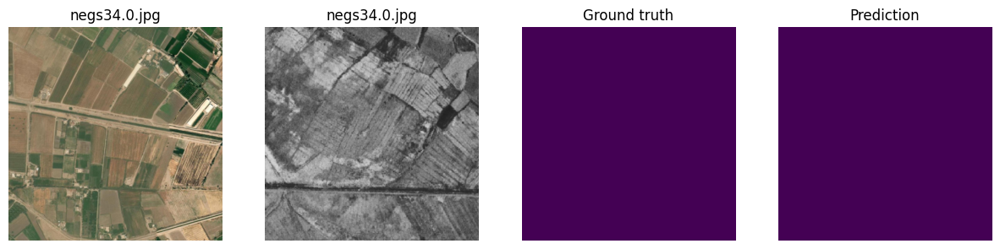

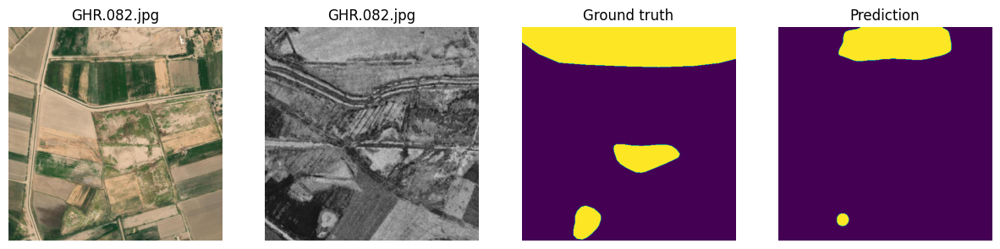

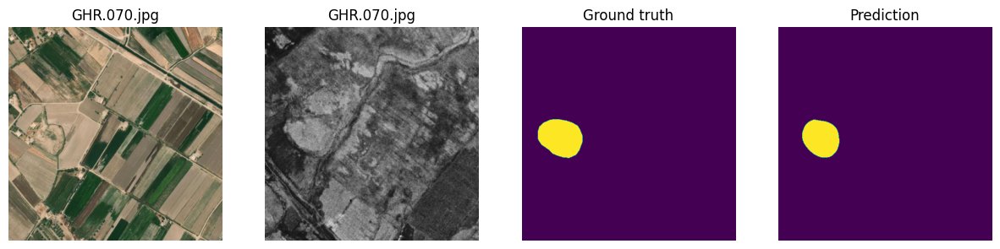

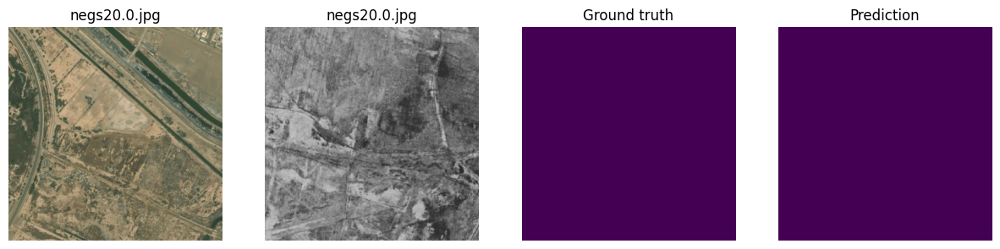

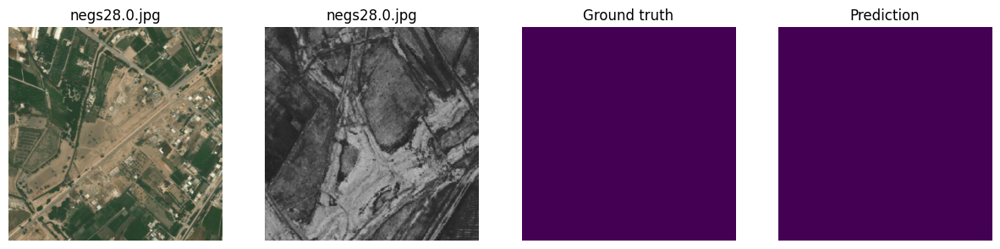

...

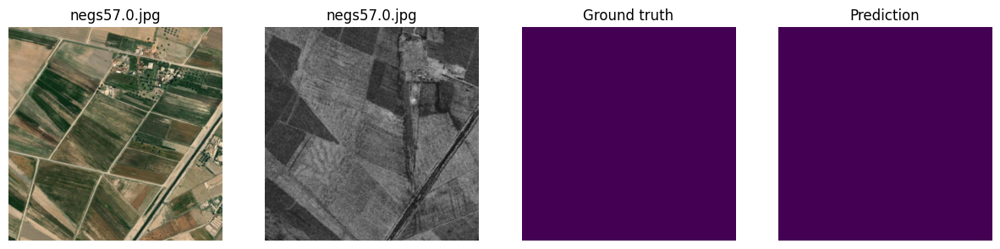

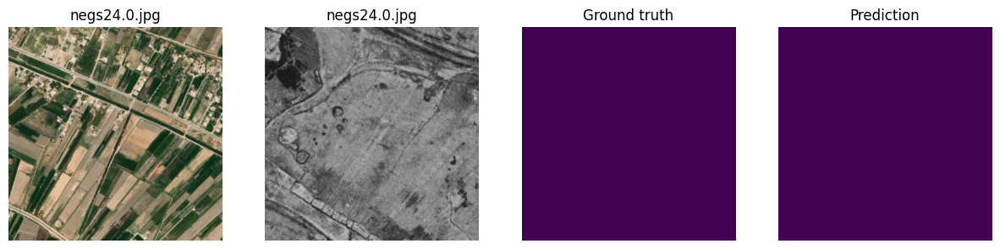

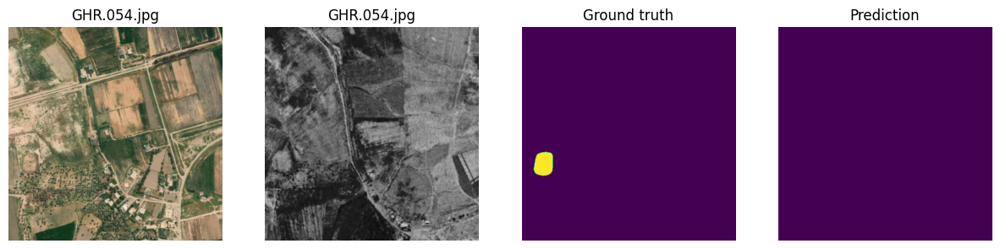

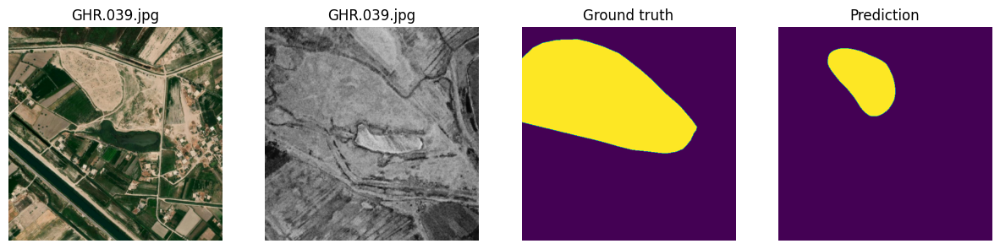

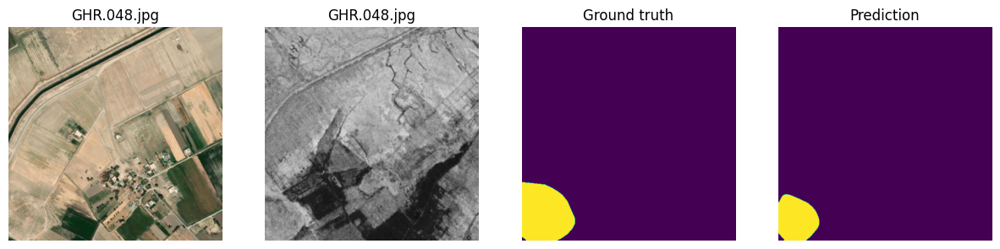

In [ ]:
modelli = ["ensemble_model"]

for i, model_name in enumerate(modelli):
  set_config(modelli[i])
  print(f"\n Now model {model_name}")

  images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])
  test_dataset = ArcheoDataset(test_images_filenames, images_directory, masks_directory, transform=val_transform)
  test_dataloader = DataLoader(test_dataset,batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=1)

  set_config(modelli[i])

  ckpt_path = f"{PATH_OUTPUT}{model_name}/best_model/"
  name_ckpt = os.listdir(ckpt_path)[0]
  print("Using: " + name_ckpt)

  model = EnsembleArcheoModel.load_from_checkpoint(
      modelA = bing_model,
      modelB = corona_model,
      arch=config["arch"],
      encoder_name=config["encoder"],
      in_channels=config["in_channels"],
      out_classes=1,
      checkpoint_path =  ckpt_path + name_ckpt
  )

  #model.to(torch.device('cuda'))
  it = iter(test_dataloader)

  for j in range(len(it)):
    batch = next(it)
    with torch.no_grad():
      model.eval()
      logits = model(batch[0])#.cuda())
    pr_masks = logits#.sigmoid().detach().cpu()

    for image, gt_mask, pr_mask, filename in zip(batch[0], batch[1], pr_masks, batch[2]):
        prob_mask = pr_mask.numpy().squeeze()

        # cutoff
        image_cutoff = prob_mask.copy()
        image_cutoff = gaussian_filter(image_cutoff, sigma=5)
        image_cutoff = ((image_cutoff + 0.5)**2) - 0.5
        image_cutoff[image_cutoff <= 0.2] = 0.0
        image_cutoff[image_cutoff > 0.2] = 1.0

        view_image_gtMask_pred(image, gt_mask, image_cutoff, filename)

# Tell detection on AbuGhraib

## Auxilaries functions

### Csv loading
I file csv contengono le coordinate dei tell

In [ ]:
namesite2Centroid={}
nameneg2Centroid={}

namesitetest2Centroid={}
nametestneg2Centroid={}


with open(PATH_DATASETS + 'dataset.csv', 'r') as file:
    reader = csv.reader(file)
    for row in reader:
      namesite2Centroid[row[0]]=[row[2],row[3]]


with open(PATH_DATASETS + 'negs110.csv', 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        nameneg2Centroid[row[0]]=[row[1],row[2]]


# just 4 test images (#10)
with open(PATH_CASINI + "datasets/dataset1000withFilter.csv", 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        namesitetest2Centroid[row[2]]=[row[3],row[4]]

with open(PATH_CASINI + 'datasets/negs1000.csv', 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        nametestneg2Centroid[row[5]]=[row[3],row[4]]

### Saving scripted random model crop

In [ ]:
import random

def generate_random_coordinates(test_images_filenames, output_csv_file):
    # Controlla se il file di output esiste già
    if os.path.exists(output_csv_file):
        print("Model transformations already created")
        return

    all_entry_ids = test_images_filenames

    # Crea un DataFrame vuoto per i dati di output
    output_data = pd.DataFrame(columns=["entry_id", "x_min", "y_min"])

    # Per ogni entry_id
    for entry_id in all_entry_ids:
        # Genera due numeri casuali per x_min e y_min nell'intervallo (0, 1024)
        x_min = int(random.uniform(0, 1024))
        y_min = int(random.uniform(0, 1024))

        # Aggiungi una nuova riga al DataFrame di output
        output_data = output_data.append({"entry_id": entry_id, "x_min": x_min, "y_min": y_min}, ignore_index=True)

    # Salva il DataFrame di output in un nuovo file CSV
    output_data.to_csv(output_csv_file, index=False)


In [ ]:
set_config("CBingCorona_BingCorona")
images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])
test_images_filenames = [filename[:-4] for filename in test_images_filenames]
generate_random_coordinates(test_images_filenames, PATH_DATASETS + "model_transformations.csv")

total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000
Model transformations already created


In [ ]:
def crea_trasformazione(path_csv):
  test_sites=[]
  name2min={}
  count=0
  with open(path_csv, 'r') as file:
    reader = csv.reader(file)
    for row in (reader):
        if(count!=0):
          test_sites.append(row[0])
          name2min[row[0]]=[row[1],row[2]]
        count+=1

  return test_sites,name2min

### Save preds with cutoff

In [ ]:
# data la predizione, viene applicato un cutoff
# ibatch rappresenta l'i-esimo batch composto da 3 elementi:
#  - ibatch[0] -> immagini in input
#  - ibatch[1] -> sono le maschere di ground truth associate
#  - ibatch[2] -> sono le previsioni del modello
#  - ipr_masks_11 -> sono le maschere di probabilità (logits.sigmoid())

def stampa_predizioni_cutoff(ibatch, ipr_masks_11, nome_modello, cutoff_val):
    for i, (input_image, groundtruth_mask, prob_mask, image_filename) in enumerate(zip(ibatch[0], ibatch[1], ipr_masks_11, ibatch[2])):
      prob_mask = prob_mask.numpy().squeeze()

      # cutoff
      image_cutoff = prob_mask.copy()
      image_cutoff = gaussian_filter(image_cutoff, sigma=5)
      image_cutoff = ((image_cutoff + 0.5)**2) - 0.5
      image_cutoff[image_cutoff <= cutoff_val] = 0.0
      image_cutoff[image_cutoff > cutoff_val] = 1.0

      # view_image_gtMask_pred(input_image, groundtruth_mask, image_cutoff, image_filename)

      output_directory = PATH_OUTPUT + nome_modello + '/pred_siti_tronc'+ str(cutoff_val) + '/'
      output_filename = image_filename[:-4] + '.png'
      output_path = os.path.join(output_directory, output_filename)

      os.makedirs(output_directory, exist_ok=True)

      plt.imsave(output_path, image_cutoff, cmap="magma", vmin=0.0, vmax=1.0)
      plt.show()

### Create tif from image
CreateTif + ConvertImageToTif

Data la predizione, viene creato il tif associato. La funzione createTif è utilizzata internamente dalla funzione convertImageToTif

In [ ]:
def createTif(ovest, sud, est, nord, patin, patout):
  dataset = rasterio.open(patin, 'r')
  bands = [1, 2, 3]
  data = dataset.read(bands)
  transform = rasterio.transform.from_bounds(ovest, sud, est, nord, data.shape[2], data.shape[1])
  crs = {'init': 'epsg:3857'}

  with rasterio.open(patout, 'w', driver='GTiff', width=data.shape[2], height=data.shape[1], count=3, dtype=data.dtype, nodata=0, transform=transform, crs=crs) as dst:
      dst.write(data, indexes=bands)


def convertImageToTif(nome_modello, cutoff_val):

  path_predizioni = PATH_OUTPUT + nome_modello + '/pred_siti_tronc'+ str(cutoff_val) + '/'
  output_directory = PATH_OUTPUT + nome_modello + '/tif' + str(cutoff_val) + '/'
  os.makedirs(output_directory, exist_ok=True)

  for i in range(len(test_images_filenames)):

    im_sfondo = Image.open(PATH_DATASETS + 'black_2048.jpg')
    im_sito = Image.open(path_predizioni + test_images_filenames[i] + ".png")
    newsize = (1024, 1024)
    im_sito = im_sito.resize(newsize)

    x_min=int(name2tras[test_images_filenames[i]][0])
    x_max=(int(name2tras[test_images_filenames[i]][0])+1024)
    y_min=int(name2tras[test_images_filenames[i]][1])
    y_max=(int(name2tras[test_images_filenames[i]][1])+1024)

    im_sfondo.paste(im_sito, (x_min, y_min,x_max,y_max))
    im_sfondo = im_sfondo.save(path_predizioni + test_images_filenames[i]+".png")


    # ho fatto un casino per le 10 immagini di test aggiunte
    if("test" in test_images_filenames[i] and "neg" in test_images_filenames[i]):
      x_centroide=float(nametestneg2Centroid[test_images_filenames[i][5:-4]][0])
      y_centroide=float(nametestneg2Centroid[test_images_filenames[i][5:-4]][1])
    elif("test" in test_images_filenames[i]):
      x_centroide=float(namesitetest2Centroid[test_images_filenames[i][5:-4]][0])
      y_centroide=float(namesitetest2Centroid[test_images_filenames[i][5:-4]][1])
    elif("neg" in test_images_filenames[i]):
      x_centroide=float(nameneg2Centroid[test_images_filenames[i]][0])
      y_centroide=float(nameneg2Centroid[test_images_filenames[i]][1])
    else:
      x_centroide=float(namesite2Centroid[test_images_filenames[i]][0])
      y_centroide=float(namesite2Centroid[test_images_filenames[i]][1])

    ovest = x_centroide-1000
    est = x_centroide+1000
    sud = y_centroide-1000
    nord = y_centroide+1000

    createTif(
        ovest=ovest, sud=sud, est=est, nord=nord,
        patin = path_predizioni + test_images_filenames[i]+".png",
        patout = output_directory + test_images_filenames[i]+".tif"
    )

### Convert Tif to Shapefile

In [ ]:
def convertTifToShape(tif_path, shape_path):

  # mapping between gdal type and ogr field type
  type_mapping = { gdal.GDT_Byte: ogr.OFTInteger,
                   gdal.GDT_UInt16: ogr.OFTInteger,
                   gdal.GDT_Int16: ogr.OFTInteger,
                   gdal.GDT_UInt32: ogr.OFTInteger,
                   gdal.GDT_Int32: ogr.OFTInteger,
                   gdal.GDT_Float32: ogr.OFTReal,
                   gdal.GDT_Float64: ogr.OFTReal,
                   gdal.GDT_CInt16: ogr.OFTInteger,
                   gdal.GDT_CInt32: ogr.OFTInteger,
                   gdal.GDT_CFloat32: ogr.OFTReal,
                   gdal.GDT_CFloat64: ogr.OFTReal }

  filenames = os.listdir(tif_path)



  os.makedirs(shape_path, exist_ok=True)
  print("Totale tif: " + str(len(filenames)))
  for f in tqdm(filenames):
    # print(f[:-4])
    # subprocess.run(["gdal_contour.exe", "-i", "128", "-p", tif_path + f, shape_path + f[:-4] + ".shp"], capture_output=True, shell=True, check=False)

    # Apre il dataset raster
    src_ds = gdal.Open(tif_path + f)
    src_band = src_ds.GetRasterBand(1)  # default band 1

    # Crea un vettore per i poligoni di contorno
    dst_layer = None

    # Creazione del driver per lo shapefile
    driver = ogr.GetDriverByName("ESRI Shapefile")

    # Crea il dataset shapefile
    dst_ds = driver.CreateDataSource(shape_path + f[:-4] + ".shp")

    # Crea il layer
    spatial_ref = osr.SpatialReference()
    spatial_ref.ImportFromEPSG(3857)
    dst_layer = dst_ds.CreateLayer(f[:-4], srs=spatial_ref, geom_type=ogr.wkbPolygon)

    raster_field = ogr.FieldDefn('elevation', type_mapping[src_band.DataType]) ## aggiunto
    dst_layer.CreateField(raster_field)


    # Copia i poligoni nel layer
    # gdal.Polygonize(src_band, None, dst_layer, -1, [], callback=None) # eliminato
    gdal.Polygonize(src_band, None, dst_layer, 0, [], callback=None) ## aggiunto

    # Chiude il dataset raster e il dataset shapefile
    src_ds = None
    dst_ds = None


def convertSingleTifToShape(tif_path, shape_path):
  # mapping between gdal type and ogr field type
  type_mapping = { gdal.GDT_Byte: ogr.OFTInteger,
                   gdal.GDT_UInt16: ogr.OFTInteger,
                   gdal.GDT_Int16: ogr.OFTInteger,
                   gdal.GDT_UInt32: ogr.OFTInteger,
                   gdal.GDT_Int32: ogr.OFTInteger,
                   gdal.GDT_Float32: ogr.OFTReal,
                   gdal.GDT_Float64: ogr.OFTReal,
                   gdal.GDT_CInt16: ogr.OFTInteger,
                   gdal.GDT_CInt32: ogr.OFTInteger,
                   gdal.GDT_CFloat32: ogr.OFTReal,
                   gdal.GDT_CFloat64: ogr.OFTReal }

  os.makedirs(shape_path[:-4], exist_ok=True)
  # Apre il dataset raster
  src_ds = gdal.Open(tif_path)
  src_band = src_ds.GetRasterBand(1)  # default band 1

  # Crea un vettore per i poligoni di contorno
  dst_layer = None

  # Creazione del driver per lo shapefile
  driver = ogr.GetDriverByName("ESRI Shapefile")

  # Crea il dataset shapefile
  dst_ds = driver.CreateDataSource(shape_path)

  # Crea il layer
  spatial_ref = osr.SpatialReference()
  spatial_ref.ImportFromEPSG(3857)
  dst_layer = dst_ds.CreateLayer(shape_path[:-4], srs=spatial_ref, geom_type=ogr.wkbPolygon)

  raster_field = ogr.FieldDefn('elevation', type_mapping[src_band.DataType]) ## aggiunto
  dst_layer.CreateField(raster_field)


  # Copia i poligoni nel layer
  # gdal.Polygonize(src_band, None, dst_layer, -1, [], callback=None) # eliminato
  gdal.Polygonize(src_band, None, dst_layer, 0, [], callback=None) ## aggiunto

  # Chiude il dataset raster e il dataset shapefile
  src_ds = None
  dst_ds = None

### Convert shapefile to geojson
Utilizzato poi per calcolare la matrice di confusione, functions:

testForIntersection: assegna ad ogni sito un valore tra (tp, tn, fp, fn) in base all'intersezione della forma predetta con la forma originale


convertShapeToGeojson: prende in input gli shapefile dei siti e ritorna un geojson contenente id, nome sito, geometria e valore tra tp,tn,fp,fn


In [ ]:
def testForIntersection(site_id, path, verbose=False):

    if verbose: print("Processing site: " + site_id)

    ### get shape for the original site
    # incasinato per immagini di test
    if("test" in site_id):
        sites = geopd.read_file(PATH_CASINI + 'shapefile/vw_site_survey_poly.shp').to_crs("EPSG:3857")
        a = sites[sites.entry_id == site_id[5:]][["entry_id", "geometry"]]
    else:
        sites = geopd.read_file(base_url + "shapefile/RS ABU-GHRAIB.shp").to_crs("EPSG:3857")
        a = sites[sites.entry_id == site_id][["entry_id", "geometry"]]


    b = geopd.read_file(path + site_id + ".shp").set_crs("EPSG:3857")
    b.geometry = b.geometry.convex_hull
    b["entry_id"] = "pred"

    ### alla creazione dello shapefile, viene assegnato un valore di elevation per contraddistinguere le parti dello shape che sono regioni (poligoni)
    ### validi da quelli che rappresentano lo "sfondo" tuttavia non capisco perchè per le shape0.2 quelle con valore 0 siano i poligoni regolari mentre
    ### per le shape0.5 sia il contrario

    b = b[b['elevation'] != 0]

    if verbose:
        print("Number of features:", len(b))
        #print(b)

    if len(b) > 1: # if there is more than one shape
        b["geometry"] = MultiPolygon([feature for feature in b["geometry"]])
        b = b[:1].copy()
        if verbose:
            print("Detected more than one shape, created multipolygon")
            #print(b)
            #b.plot()
    # negs should have no geometry
    if len(b) == 0 and "neg" in site_id:
        if verbose: print("true negative")
        return "TN", site_id, None

    # if neg has geometry then FP
    elif len(b) > 0 and"neg" in site_id:
        if verbose: print("false positive")
        return "FP", site_id, b.iloc[0]["geometry"] #False

    # if no geometry and not neg then FN. use a.geometry for use in QGIS
    elif len(b) == 0 and not "neg" in site_id:
        if verbose: print("false negative")
        return "FN", site_id, a.iloc[0]["geometry"]

    # compute intersection
    if ~b.iloc[0].geometry.is_valid:
        b.geometry = b.geometry.buffer(0)
    intersects = a.iloc[0]["geometry"].intersects(b.iloc[0]["geometry"])
    if verbose:
        #c = pd.concat([a,b])
        #c.plot(column="entry_id", legend=True, figsize=(5,5), cmap="Set3")
        print("INTERSECTION: ", intersects)

    if intersects: # right geometry
        return "TP", site_id, b.iloc[0]["geometry"]
    else: # wrong geometry
        return "FP", site_id, b.iloc[0]["geometry"]

In [ ]:
def convertShapeToGeojson(testset, path_in, path_out):
  res = {"index":[], "entry_id":[], "geometry":[], "cat":[]}
  indice = 0
  for sito in testset:
      #sito = sito[:-4]
      cat, eid, geom = testForIntersection(sito, path_in, verbose = True)
      res["index"].append(indice)
      res["entry_id"].append(eid)
      res["geometry"].append(geom)
      res["cat"].append(cat)
      indice += 1
  res_df = geopd.GeoDataFrame(res)
  res_df = res_df.set_index("index")
  res_df.to_file(path_out, driver='GeoJSON', crs="EPSG:3857")

### Confusion matrix and print metrics

Adjusted CM deriva dalla consultazione con archeologia

In [ ]:
def calculate_matrix(preds):
  tp = preds[preds.cat == "TP"]['entry_id'].shape[0]
  tn = preds[preds.cat == "TN"]['entry_id'].shape[0]
  fp = preds[preds.cat == "FP"]['entry_id'].shape[0]
  fn = preds[preds.cat == "FN"]['entry_id'].shape[0]

  matrix = [tp, tn, fp, fn]


  # adjusted

  # sono siti non visibili, quindi classificati erroneamente come tn
  # fn2tn = preds[(preds.cat == "FN")&(preds.correction == "TN")]['entry_id'].shape[0]

  # sites_inside_ot = preds[(preds.notes.str.contains('INSIDE OTHER', na=False)) ].shape[0]

  # siti non visibili e il modello ne trova un altro esistente
  # fp2tp = preds[
  #  (preds.cat == "FP") & ((preds.notes.str.contains('NV', na=False))|
  #                        (preds.notes.str.contains('NOT VISIBLE', na=False)) |
  #                        (preds.notes.str.contains('NOT VISIBILE', na=False)) |
  #                        (preds.entry_id.str.contains('neg', na=False))) &
  #                        (preds.notes.str.contains('INSIDE OTHER', na=False))].shape[0]

  # siti visibili e il modello ne trova un altro esistente
  # fp2fn = sites_inside_ot - fp2tp

  # tn_a = tn + fn2tn + fp2tp
  # fn_a = fn - fn2tn + fp2fn
  # tp_a = tp + (fp2tp + fp2fn)
  # fp_a = fp - (fp2tp + fp2fn)

  # matrix_adj=[tp_a,tn_a,fp_a,fn_a]

  # return(matrix, matrix_adj)
  return matrix



# mi stampo le statistiche in termini di valori della matrice di confusione oltre a
# precisione, recall.

def stampa_stats(cm, modello, cm_adj = None):
  print('--------------------------------------------')
  print("Stats Modello " + str(modello))
  print('---')

  print("Valutazione automatica:")
  print("TP: " + str(cm[0]) + " TN: " + str(cm[1]) + " FP: " + str(cm[2]) + " FN: " + str(cm[3]))
  print("Accuracy: ", round( (cm[0] + cm[1]) / (cm[0] + cm[1] + cm[2] + cm[3] ), 4))
  print("Recall: ", round( cm[0] / (cm[0] + cm[3]), 4))

  if(cm_adj is not None):
    print('---')

    print("Valutazione manuale:")
    print("TP: "+ str(cm_adj[0]) + " TN: " + str(cm_adj[1]) + " FP: " + str(cm_adj[2]) + " FN: " + str(cm_adj[3]))
    print("Accuracy: ", round((cm_adj[0] + cm_adj[1]) / (cm_adj[0] + cm_adj[1] + cm_adj[2] + cm_adj[3]), 4))
    print("Recall: ", round(cm_adj[0] / (cm_adj[0] + cm_adj[3]), 4))

  print('--------------------------------------------')

## Tell detection for every model

In [ ]:
modelli = ["CBing_Bing_Full", "CBingCorona_BingCorona", "CCorona_Corona"]

for i, model_name in enumerate(modelli):

  print("*** Model: " + str(model_name))

  set_config(model_name)

  current_output_path = PATH_OUTPUT + model_name + '/'

  ckpt_path = f"{PATH_OUTPUT}{model_name}/best_model/"
  name_ckpt = os.listdir(ckpt_path)[0]

  model = ArcheoModel.load_from_checkpoint(
      arch=config["arch"],
      encoder_name=config["encoder"],
      in_channels=config["in_channels"],
      out_classes=1,
      checkpoint_path =  ckpt_path + name_ckpt
  )

  random.seed(config["random_seed"])
  np.random.seed(config["random_seed"])
  torch.manual_seed(config["random_seed"])

  test_images_filenames, name2tras = crea_trasformazione(PATH_DATASETS + 'model_transformations.csv')

  images_directory = config["dataset_path"] + 'sites'
  masks_directory = config["dataset_path"] + 'masks'

  test_dataset = ArcheoDatasetModify(test_images_filenames, images_directory, masks_directory)
  test_dataloader = DataLoader(test_dataset,batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

  it = iter(test_dataloader)

  for j in range(len(it)):
    batch = next(it)
    with torch.no_grad():
      model.eval()
      logits = model(batch[0].cuda())
    pr_masks = logits.sigmoid().detach().cpu()
    stampa_predizioni_cutoff(batch, pr_masks, model_name, 0.2)
    stampa_predizioni_cutoff(batch, pr_masks, model_name, 0.5)

  convertImageToTif(model_name, 0.2)
  convertImageToTif(model_name, 0.5)

  convertTifToShape(current_output_path + '/tif0.2/', current_output_path + '/shape0.2/')
  convertTifToShape(current_output_path + '/tif0.5/', current_output_path + '/shape0.5/')

  os.makedirs(current_output_path + '/GeoJson', exist_ok=True)
  convertShapeToGeojson(test_images_filenames, current_output_path + '/shape0.2/', current_output_path + '/GeoJson/preds02.geojson')
  convertShapeToGeojson(test_images_filenames, current_output_path + '/shape0.5/', current_output_path + '/GeoJson/preds05.geojson')
  print("\n\n")

*** Model: CBing_Bing_Full


/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

Processing site: negs34.0
Number of features: 0
true negative
Processing site: GHR.082
Number of features: 4193
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: GHR.070
Number of features: 2704
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: negs20.0
Number of features: 0
true negative
Processing site: negs28.0
Number of features: 1179
Detected more than one shape, created multipolygon
false positive
Processing site: negs26.0
Number of features: 0
true negative
Processing site: GHR.027
Number of features: 3445
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: negs31.0
Number of features: 0
true negative
Processing site: negs62.0
Number of features: 0
true negative
Processing site: negs74.0
Number of features: 1542
Detected more than one shape, created multipolygon
false positive
Processing site: GHR.031
Number of features: 4211
Detected more than one shape, created multi

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

Processing site: negs34.0
Number of features: 2644
Detected more than one shape, created multipolygon
false positive
Processing site: GHR.082
Number of features: 4445
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: GHR.070
Number of features: 3728
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: negs20.0
Number of features: 1651
Detected more than one shape, created multipolygon
false positive
Processing site: negs28.0
Number of features: 1231
Detected more than one shape, created multipolygon
false positive
Processing site: negs26.0
Number of features: 5673
Detected more than one shape, created multipolygon
false positive
Processing site: GHR.027
Number of features: 3102
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: negs31.0
Number of features: 0
true negative
Processing site: negs62.0
Number of features: 675
Detected more than one shape, created multipolygon
false 

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

Processing site: negs34.0
Number of features: 0
true negative
Processing site: GHR.082
Number of features: 5303
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: GHR.070
Number of features: 2625
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: negs20.0
Number of features: 0
true negative
Processing site: negs28.0
Number of features: 0
true negative
Processing site: negs26.0
Number of features: 683
Detected more than one shape, created multipolygon
false positive
Processing site: GHR.027
Number of features: 4932
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: negs31.0
Number of features: 0
true negative
Processing site: negs62.0
Number of features: 0
true negative
Processing site: negs74.0
Number of features: 0
true negative
Processing site: GHR.031
Number of features: 1022
Detected more than one shape, created multipolygon
INTERSECTION:  True
Processing site: negs59.0
Nu

## Tell detection for ensemble model

In [ ]:
modelli = ["ensemble_model"]#["sm_baseline", "sm_bing_full", "sm_corona_full", "sm_bing_corona_full", "sm_bing", "sm_corona", "sm_bing_corona"]

for i, model_name in enumerate(modelli):

  print("*** Model: " + str(model_name))

  set_config(modelli[i])

  images_directory, masks_directory, train_images_filenames, val_images_filenames, test_images_filenames = load_dataset(config["dataset_path"])

  current_output_path = PATH_OUTPUT + model_name + '/'

  ckpt_path = f"{PATH_OUTPUT}{model_name}/best_model/"
  name_ckpt = os.listdir(ckpt_path)[0]

  bing_model = ArcheoModel.load_from_checkpoint(
    arch = config["arch"],
    encoder_name = config["encoder"],
    encoder_weights = config["weights"],
    in_channels = 3,
    out_classes = 1,
    checkpoint_path = sm_bing_path + bing_ckpt
  )

  corona_model = ArcheoModel.load_from_checkpoint(
      arch = config["arch"],
      encoder_name = config["encoder"],
      encoder_weights = config["weights"],
      in_channels = 3,
      out_classes = 1,
      checkpoint_path = sm_corona_path + corona_ckpt
  )

  ensemble_model = EnsembleArcheoModel(bing_model, corona_model)

  test_dataset = ArcheoDataset(test_images_filenames, images_directory, masks_directory)
  test_dataloader = DataLoader(test_dataset, batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=0)

  it = iter(test_dataloader)

  for j in range(len(it)):
    batch = next(it)
    with torch.no_grad():
      ensemble_model.eval()
      logits = ensemble_model(batch[0])#.cuda())
    pr_masks = logits#.sigmoid().detach().cpu()
    stampa_predizioni_cutoff(batch, pr_masks, model_name, 0.2)
    stampa_predizioni_cutoff(batch, pr_masks, model_name, 0.5)

  convertImageToTif(model_name, 0.2)
  convertImageToTif(model_name, 0.5)

  convertTifToShape(current_output_path + '/tif0.2/', current_output_path + '/shape0.2/')
  convertTifToShape(current_output_path + '/tif0.5/', current_output_path + '/shape0.5/')

  os.makedirs(current_output_path + '/GeoJson', exist_ok=True)
  convertShapeToGeojson(test_images_filenames, current_output_path + '/shape0.2/', current_output_path + '/GeoJson/preds02.geojson')
  convertShapeToGeojson(test_images_filenames, current_output_path + '/shape0.5/', current_output_path + '/GeoJson/preds05.geojson')
  print("\n\n")

*** Model: ensemble_model
total files: 209
root: /content/drive/My Drive/ML/AbuGrahib/ 
 images /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/sites/ 
 masks /content/drive/My Drive/ML/AbuGrahib/datasets/bing_2k/masks/ 
 --- 
 train images 150 
 val images 29 
 test images 20 
 ---
total images 209
empty masks percentage: 0.5533 0.5172 0.6000


/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

negs34.0
GHR.082
GHR.070
negs20.0
negs28.0
negs26.0
GHR.027
negs31.0
negs62.0
negs74.0
GHR.031
negs59.0
GHR.024
negs8.0
negs49.0
negs57.0
negs24.0
GHR.054
GHR.039
GHR.048
Totale tif: 20


  0%|          | 0/20 [00:00<?, ?it/s]

negs34.0
GHR.082
GHR.070
negs20.0
negs28.0
negs26.0
GHR.027
negs31.0
negs62.0
negs74.0
GHR.031
negs59.0
GHR.024
negs8.0
negs49.0
negs57.0
negs24.0
GHR.054
GHR.039
GHR.048
Processing site: negs34.0
Number of features: 11
Detected more than one shape, created multipolygon
false positive
Processing site: GHR.082
Number of features: 1
INTERSECTION:  True
Processing site: GHR.070
Number of features: 6
Detected more than one shape, created multipolygon
INTERSECTION:  False
Processing site: negs20.0
Number of features: 0
true negative
Processing site: negs28.0
Number of features: 5
Detected more than one shape, created multipolygon
false positive
Processing site: negs26.0
Number of features: 2
Detected more than one shape, created multipolygon
false positive
Processing site: GHR.027
Number of features: 3
Detected more than one shape, created multipolygon
INTERSECTION:  False
Processing site: negs31.0
Number of features: 1
false positive
Processing site: negs62.0
Number of features: 0
true neg

In [ ]:
for i, model_name in enumerate(modelli):
  PATH_GEOJSON_02 = PATH_OUTPUT + model_name +'/GeoJson/preds02.geojson'
  PATH_GEOJSON_05 = PATH_OUTPUT + model_name +'/GeoJson/preds05.geojson'

  print("\nCutoff: 0.2")
  preds = geopd.read_file(PATH_GEOJSON_02).sort_values("index").reset_index(drop=True)
  confusion_matrix = calculate_matrix(preds)
  stampa_stats(confusion_matrix, model_name, None)

  print("\nCutoff: 0.5")
  preds = geopd.read_file(PATH_GEOJSON_05).sort_values("index").reset_index(drop=True)
  confusion_matrix = calculate_matrix(preds)
  stampa_stats(confusion_matrix, model_name, None)
  print("\n\n")


Cutoff: 0.2
--------------------------------------------
Stats Modello ensemble_model
---
Valutazione automatica:
TP: 3 TN: 2 FP: 14 FN: 1
Accuracy:  0.25
Recall:  0.75
--------------------------------------------

Cutoff: 0.5
--------------------------------------------
Stats Modello ensemble_model
---
Valutazione automatica:
TP: 3 TN: 2 FP: 14 FN: 1
Accuracy:  0.25
Recall:  0.75
--------------------------------------------





## Detection metrics

In [ ]:
modelli = ["CBing_Bing_Full", "CBingCorona_BingCorona", "CCorona_Corona"]

In [ ]:
for i, model_name in enumerate(modelli):
  PATH_GEOJSON_02 = PATH_OUTPUT + model_name +'/GeoJson/preds02.geojson'
  PATH_GEOJSON_05 = PATH_OUTPUT + model_name +'/GeoJson/preds05.geojson'

  print("\nCutoff: 0.2")
  preds = geopd.read_file(PATH_GEOJSON_02).sort_values("index").reset_index(drop=True)
  confusion_matrix = calculate_matrix(preds)
  stampa_stats(confusion_matrix, model_name, None)

  print("\nCutoff: 0.5")
  preds = geopd.read_file(PATH_GEOJSON_05).sort_values("index").reset_index(drop=True)
  confusion_matrix = calculate_matrix(preds)
  stampa_stats(confusion_matrix, model_name, None)
  print("\n\n")


Cutoff: 0.2
--------------------------------------------
Stats Modello CBing_Bing_Full
---
Valutazione automatica:
TP: 7 TN: 7 FP: 5 FN: 1
Accuracy:  0.7
Recall:  0.875
--------------------------------------------

Cutoff: 0.5
--------------------------------------------
Stats Modello CBing_Bing_Full
---
Valutazione automatica:
TP: 4 TN: 11 FP: 1 FN: 4
Accuracy:  0.75
Recall:  0.5
--------------------------------------------




Cutoff: 0.2
--------------------------------------------
Stats Modello CBingCorona_BingCorona
---
Valutazione automatica:
TP: 8 TN: 2 FP: 10 FN: 0
Accuracy:  0.5
Recall:  1.0
--------------------------------------------

Cutoff: 0.5
--------------------------------------------
Stats Modello CBingCorona_BingCorona
---
Valutazione automatica:
TP: 7 TN: 11 FP: 1 FN: 1
Accuracy:  0.9
Recall:  0.875
--------------------------------------------




Cutoff: 0.2
--------------------------------------------
Stats Modello CCorona_Corona
---
Valutazione automatica:
TP: 6

# Generazione heatmap AbuGhraib

In [ ]:
PATH_SEL_ABU_DATASET = PATH_DATASETS + 'abu_sel_tile_1k/'
PATH_SEL_ABU_OUTPUT = PATH_OUTPUT + 'CBingCorona_BingCorona/abu_sel_area/'
PATH_MODEL_USED = PATH_OUTPUT + 'CBingCorona_BingCorona/best_model/epoch=9-step=180.ckpt'

selected_areas = ["selezione_area_1", "selezione_area_2"]

random.seed(config["random_seed"])
np.random.seed(config["random_seed"])
torch.manual_seed(config["random_seed"])

In [ ]:
def stampa_predizioni(ibatch, ipr_masks_11, patout):
  os.makedirs(patout + 'pred_magma_v1/', exist_ok=True)
  for i,(image, gt_mask, masks_11, fn) in enumerate(zip(ibatch[0], ibatch[1], ipr_masks_11, ibatch[2])):
    masks_11 = masks_11.numpy().squeeze()
    plt.imsave(patout + 'pred_magma_v1/'+ fn[:-4] + '.png', masks_11, cmap="magma", vmin=0.0, vmax=1.0)

## Predizioni

In [ ]:
for area in selected_areas:
  current_area_path = PATH_SEL_ABU_DATASET + area + "/"
  current_area_output_path = PATH_SEL_ABU_OUTPUT + area + "/"
  config['corona_path'] = current_area_path + 'corona/'

  filenames_test_abu = np.asarray(list(sorted(os.listdir(current_area_path + 'sites'))))

  transform_abu = A.Compose([
      A.Resize(512, 512),
      A.pytorch.ToTensorV2()
      ], additional_targets={'secondary_image': 'image'})

  test_dataset_sel_abu = ArcheoDataset(
      filenames_test_abu,
      current_area_path + 'sites/',
      current_area_path + 'masks/',
      transform=transform_abu
  )

  test_loader_sel_abu = DataLoader(test_dataset_sel_abu, batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=NUM_WORKERS)

  model = ArcheoModel.load_from_checkpoint(
      arch = config["arch"],
      encoder_name = config["encoder"],
      in_channels = 6,
      out_classes = 1,
      checkpoint_path = PATH_MODEL_USED
  )

  model.to(device)

  it_abu=iter(test_loader_sel_abu)

  for i in range(len(it_abu)):
    batch = next(it_abu)
    with torch.no_grad():
      model.eval()
      logits = model(batch[0].cuda())
    pr_masks = logits.sigmoid().detach().cpu()
    stampa_predizioni(batch, pr_masks, current_area_output_path)


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b3-5fb5a3c3.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b3-5fb5a3c3.pth
100%|██████████| 47.1M/47.1M [00:00<00:00, 275MB/s]


## Composizione heatmap

### Funzioni ausiliare

In [ ]:
def crea_righe(imm_size, l_x, l_y, fn, resize=False, num_res=256, format=".png"):
  righe = []
  altezza = 1
  if(resize == True):
    image_tot = Image.open(fn + "1" + format).resize((num_res, num_res))
  else:
    image_tot = Image.open(fn + "1" + format)
  for i in range(2, l_x * l_y + 1):
    if((i-1) % l_x == 0):
      if(resize == True):
        image_tot=Image.open(fn + str(i)+format).resize((num_res, num_res))
      else:
        image_tot=Image.open(fn + str(i)+format)
    else:
      if(resize == True):
        image_open=Image.open(fn + str(i) + format).resize((num_res, num_res))
      else:
        image_open=Image.open(fn + str(i) + format)
      new_image = Image.new('RGB', (imm_size*l_x, imm_size))
      new_image.paste(image_tot, (0,0))
      posizione = i % l_x
      if(posizione == 0):
        posizione = l_x
      new_image.paste(image_open, (imm_size * (posizione - 1), ((altezza - 1) * image_open.size[1])))
      image_tot = new_image
      if(posizione == l_x):
        righe.append(image_tot)
  return righe

def crea_immagine(righ, dim, l_x, l_y, nome):
  imm_totale = Image.new('RGB', (l_x * dim, l_y * dim))
  x =- dim
  for i in reversed(range(len(righ))):
    x += dim
    imm_totale.paste(righ[i], (0, x))
  imm_totale.save(nome + '.jpg')

### creazione

In [ ]:
for area in selected_areas:
  current_area_output_path = PATH_SEL_ABU_OUTPUT + area + "/"
  f = open(PATH_SEL_ABU_DATASET + 'coor_' + area + '_abu.json')
  data = json.load(f)
  # distanza tra centroidi
  spost = data[1]['cx'] - data[0]['cx']

  ovest = int(data[0]['cx'] - spost/2)
  sud = int(data[0]['cy'] - spost/2)
  nord = int(data[len(data) - 1]['cy'] + (spost/2))
  num_righe = int((nord - sud) / spost)
  num_colonne = int(len(data) / num_righe)
  est = int(data[num_colonne - 1]['cx'] + spost/2)

  righe = crea_righe(512, num_colonne, num_righe, current_area_output_path + 'pred_magma_v1/')

  crea_immagine(righe, 512, num_colonne, num_righe, current_area_output_path + "imm_tot_magma_v1")
  createTif(ovest, sud, est, nord, current_area_output_path + "imm_tot_magma_v1.jpg", current_area_output_path + "imm_tot_magma_v1.tif")


/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


## Custom shapefile on request

In [ ]:
for area in selected_areas:
  current_area_path = PATH_SEL_ABU_DATASET + area + "/"
  current_area_output_path = PATH_SEL_ABU_OUTPUT + area + "/"

  filenames_test_abu = np.asarray(list(sorted(os.listdir(current_area_path + 'sites'))))

  transform_abu = A.Compose([
      A.Resize(512, 512),
      A.pytorch.ToTensorV2()
  ])

  test_dataset_sel_abu = ArcheoDataset(filenames_test_abu, current_area_path + 'sites/', current_area_path + 'masks/', transform=transform_abu)
  test_loader_sel_abu = DataLoader(test_dataset_sel_abu, batch_size=config["batch_size"], shuffle=False, drop_last=False, num_workers=0)

  model = ArcheoModel.load_from_checkpoint(
      arch = config["arch"],
      encoder_name = config["encoder"],
      encoder_weights = config["weights"],
      in_channels = 3,
      out_classes = 1,
      checkpoint_path = PATH_MODEL_USED
  )

  it_abu=iter(test_loader_sel_abu)

  for i in range(len(it_abu)):
    batch = next(it_abu)
    with torch.no_grad():
      model.eval()
      logits = model(batch[0])
    pr_masks = logits.sigmoid()
    stampa_predizioni_cutoff(batch, pr_masks, 'abu_2k_fine_tuning/abu_sel_area/' + area, 0.5)


In [ ]:
for area in selected_areas:
  current_area_output_path = PATH_SEL_ABU_OUTPUT + area + "/"
  f = open(PATH_SEL_ABU_DATASET + 'coor_' + area + '_abu.json')
  data = json.load(f)
  # distanza tra centroidi
  spost = data[1]['cx'] - data[0]['cx']

  ovest = int(data[0]['cx'] - spost/2)
  sud = int(data[0]['cy'] - spost/2)
  nord = int(data[len(data) - 1]['cy'] + (spost/2))
  num_righe = int((nord - sud) / spost)
  num_colonne = int(len(data) / num_righe)
  est = int(data[num_colonne - 1]['cx'] + spost/2)

  righe = crea_righe(512, num_colonne, num_righe, current_area_output_path + 'pred_siti_tronc0.5/')

  crea_immagine(righe, 512, num_colonne, num_righe, current_area_output_path + "imm_tot_tronc05")
  createTif(ovest, sud, est, nord, current_area_output_path + "imm_tot_tronc05.jpg", current_area_output_path + "imm_tot_tronc05.tif")
  convertSingleTifToShape(current_area_output_path + "imm_tot_tronc05.tif", current_area_output_path + "imm_tot_tronc05.shp")

/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
